<a href="https://colab.research.google.com/github/sayakpaul/GAN-Hacks/blob/master/CycleGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The notebook uses the following references:
- https://github.com/udacity/deep-learning-v2-pytorch/blob/master/cycle-gan/CycleGAN_Solution.ipynb
- Machine Learning Mastery's implementation of Cycle GANs (from the book [Generative Adversarial Networks with Python](https://machinelearningmastery.com/generative_adversarial_networks/)).

In [1]:
%tensorflow_version 2.x

TensorFlow 2.x selected.


In [0]:
!wget https://gist.githubusercontent.com/sayakpaul/1e0f3ae671b62413d9ee98626a71f23d/raw/31df245ab4476db32563f6b86e3a22890df6e487/download_cyclegan_data.sh

In [0]:
!sh download_cyclegan_data.sh monet2photo

In [2]:
!ls monet2photo/

testA  testB  trainA  trainB


In [0]:
!apt-get install tree

In [3]:
!tree --dirsfirst --filelimit 10 monet2photo

monet2photo
├── testA [121 entries exceeds filelimit, not opening dir]
├── testB [751 entries exceeds filelimit, not opening dir]
├── trainA [1072 entries exceeds filelimit, not opening dir]
└── trainB [6287 entries exceeds filelimit, not opening dir]

4 directories, 0 files


In [0]:
# imports
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from os import listdir
import numpy as np
from tqdm import tqdm

In [0]:
# load all images in a directory into memory
def load_images(path, size=(128,128)):
    data_list = list()
    
    # enumerate filenames in directory, assume all are images
    for filename in tqdm(listdir(path)):
        # load and resize the image
        pixels = load_img(path + filename, target_size=size)
        # convert to numpy array
        pixels = img_to_array(pixels)
        # store
        data_list.append(pixels)
    
    return np.array(data_list)

In [6]:
# dataset path
path = "monet2photo/"

# load dataset A
dataA1 = load_images(path + "trainA/") 
dataA2 = load_images(path + "testA/") 
dataA = np.concatenate([dataA1, dataA2])
print("Loaded dataA: ", dataA.shape)

# load dataset B
dataB1 = load_images(path + "trainB/") 
dataB2 = load_images(path + "testB/") 
dataB = np.concatenate([dataB1, dataB2])
print("Loaded dataB: ", dataB.shape)

  1%|          | 59/6287 [00:00<00:10, 586.84it/s]

Loaded dataA:  (1193, 128, 128, 3)


100%|██████████| 751/751 [00:01<00:00, 606.11it/s]


Loaded dataB:  (7038, 128, 128, 3)


In [0]:
import matplotlib.pyplot as plt

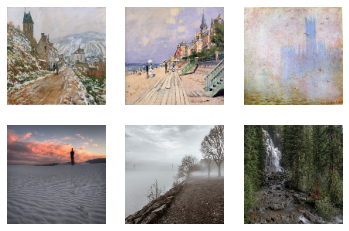

In [8]:
n_samples = 3

# plot source images
for i in range(n_samples): 
    plt.subplot(2, n_samples, 1 + i) 
    plt.axis("off") 
    plt.imshow(dataA[i].astype("int"))
 
# plot target image
for i in range(n_samples):
    plt.subplot(2, n_samples, 1 + n_samples + i) 
    plt.axis("off") 
    plt.imshow(dataB[i].astype("int"))   

In [0]:
# needed for instance normalization
!pip install -q  --no-deps tensorflow-addons~=0.7

In [0]:
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.optimizers import *
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
import tensorflow_addons as tfa

In [0]:
# define the discriminator model
def define_discriminator(image_shape):
    # source image input
    in_image = Input(shape=image_shape)

    # init
    init = RandomNormal(stddev=0.02)
    
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(in_image)
    d = LeakyReLU(alpha=0.2)(d)

    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3)(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3)(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3)(d)
    d = LeakyReLU(alpha=0.2)(d)

    # second last output layer
    d = Conv2D(512, (4,4), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3)(d)
    d = LeakyReLU(alpha=0.2)(d)

    # patch output
    patch_out = Conv2D(1, (4,4), padding="same", kernel_initializer=init)(d) 
    
    # define model
    model = Model(in_image, patch_out)
    
    return model 

In [0]:
# generator a resnet block
def resnet_block(n_filters, input_layer):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # first layer convolutional layer
    g = Conv2D(n_filters, (3,3), padding="same", kernel_initializer=init)(input_layer) 
    g = tfa.layers.InstanceNormalization(axis=3)(g)
    g = Activation("relu")(g)
    
    # second convolutional layer
    g = Conv2D(n_filters, (3,3), padding="same", kernel_initializer=init)(g) 
    g = tfa.layers.InstanceNormalization(axis=3)(g)
    
    # concatenate merge channel-wise with input layer
    g = Concatenate()([g, input_layer])
    
    return g

In [0]:
# define the standalone generator model
def define_generator(image_shape=(256,256,3), n_resnet=6):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# image input
	in_image = Input(shape=image_shape)

	# c7s1-64
	g = Conv2D(64, (7,7), padding='same', kernel_initializer=init)(in_image)
	g = tfa.layers.InstanceNormalization(axis=3)(g)
	g = Activation('relu')(g)

	# d128
	g = Conv2D(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3)(g)
	g = Activation('relu')(g)

	# d256
	g = Conv2D(256, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3)(g)
	g = Activation('relu')(g)

	# R256
	for _ in range(n_resnet):
		g = resnet_block(256, g)

	# u128
	g = Conv2DTranspose(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3)(g)
	g = Activation('relu')(g)

	# u64
	g = Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3)(g)
	g = Activation('relu')(g)

	# c7s1-3
	g = Conv2D(3, (7,7), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3)(g)
	out_image = Activation('tanh')(g)

	# define model
	model = Model(in_image, out_image)

	return model

In [15]:
# discriminator
discriminator = define_discriminator((128,128,3))
discriminator.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 64, 64, 64)        3136      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 128)       131200    
_________________________________________________________________
instance_normalization (Inst (None, 32, 32, 128)       256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 256)       524544

In [16]:
# generator
generator = define_generator()
generator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 256, 256, 64) 9472        input_2[0][0]                    
__________________________________________________________________________________________________
instance_normalization_4 (Insta (None, 256, 256, 64) 128         conv2d_6[0][0]                   
__________________________________________________________________________________________________
activation (Activation)         (None, 256, 256, 64) 0           instance_normalization_4[0][0]   
____________________________________________________________________________________________

In [0]:
# output omitted for brevity
from tensorflow.keras.utils import plot_model
plot_model(discriminator, "discriminator.png", show_shapes=True)
plot_model(generator, "generator.png", show_shapes=True)

In [0]:
# input shape
image_shape = (128, 128, 3)

# generator: A -> B
g_model_AtoB = define_generator(image_shape, n_resnet=6)
# generator: B -> A
g_model_BtoA = define_generator(image_shape, n_resnet=6)

# discriminator: A -> [real/fake]
d_model_A = define_discriminator(image_shape)
# discriminator: B -> [real/fake]
d_model_B = define_discriminator(image_shape)

In [0]:
import tensorflow as tf

In [0]:
def real_mse_loss(D_out):
    mse = tf.keras.losses.MeanSquaredError()
    # how close is the produced output from being "real"?
    # label for real is 1
    ones = tf.ones_like(len(D_out), dtype=tf.float32)
    return mse(D_out, ones)

def fake_mse_loss(D_out):
    mse = tf.keras.losses.MeanSquaredError()
    # how close is the produced output from being "fake"?
    # label for fake is 0
    zeros = tf.zeros_like(len(D_out), dtype=tf.float32)
    return mse(D_out, zeros)

def cycle_consistency_loss(real_im, reconstructed_im, lambda_weight):
    mae = tf.keras.losses.MeanAbsoluteError()
    # calculate reconstruction loss 
    # as absolute value difference between the real and reconstructed images
    reconstr_loss = mae(real_im, reconstructed_im)
    # return weighted loss
    return lambda_weight*reconstr_loss 

In [0]:
# these values come from the original paper
###########################################

# hyperparams for Adam optimizer
lr=0.0002
beta1=0.5
beta2=0.999 # default value

# create optimizers for the generators and discriminators
g_AtoB_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
g_BtoA_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
d_model_A_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
d_model_B_opt = Adam(lr, beta_1=beta1, beta_2=beta2)

In [0]:
@tf.function
def train_discriminator_A(dA, gBA, images_B, images_A, d_model_A_opt):
    with tf.GradientTape() as tape:
        # discriminator A
        dA_real_logits = dA(images_A)
        dA_real_loss = real_mse_loss(dA_real_logits)

        # discriminator A on fake stuff
        fake_A = gBA(images_B)
        dA_fake_logits = dA(fake_A)
        dA_fake_loss = fake_mse_loss(dA_fake_logits)

        # total dA loss
        total_dA_loss = dA_real_loss + dA_fake_loss

    # compute gradients and backprop
    dA_grads = tape.gradient(total_dA_loss, dA.trainable_variables)
    d_model_A_opt.apply_gradients(zip(dA_grads, dA.trainable_variables))

    return total_dA_loss

# <-------------------------------------------------------------------->

@tf.function
def train_discriminator_B(dB, gAB, images_A, images_B, d_model_B_opt):
    with tf.GradientTape() as tape:
        # discriminator B
        dB_real_logits = dB(images_B)
        dB_real_loss = real_mse_loss(dB_real_logits)

        # discriminator B on fake stuff
        fake_B = gAB(images_A)
        dB_fake_logits = dB(fake_B)
        dB_fake_loss = fake_mse_loss(dB_fake_logits)

        # total dA loss
        total_dB_loss = dB_real_loss + dB_fake_loss

    # compute gradients and backprop
    dB_grads = tape.gradient(total_dB_loss, dB.trainable_variables)
    d_model_B_opt.apply_gradients(zip(dB_grads, dB.trainable_variables))

    return total_dB_loss

In [0]:
@tf.function
def train_generator_AB(dB, gAB, gBA, images_A, images_B, g_AtoB_opt):
    ###### Generator AB ######
    #########################
    with tf.GradientTape() as tape:
        # generate images from domain A to domain B, compute loss (weight 1) via
        # discriminator B
        fake_B = gAB(images_A)
        dB_fake_logits = dB(fake_B)
        gAB_loss = real_mse_loss(dB_fake_logits)

        # identity loss (weight 5)
        identity_B = gAB(images_B)
        id_loss = cycle_consistency_loss(images_B, identity_B, 5)

        # cycle consistency loss (weight 10)
        reconstructed_A = gBA(fake_B)
        reconstructed_A_loss = cycle_consistency_loss(images_A, reconstructed_A, 10)

        # total loss
        total_gAB_loss = gAB_loss + id_loss + reconstructed_A_loss
    
    # compute gradients and backprop
    gAB_grads = tape.gradient(total_gAB_loss, gAB.trainable_variables)
    g_AtoB_opt.apply_gradients(zip(gAB_grads, gAB.trainable_variables))

    return total_gAB_loss
    
# <-------------------------------------------------------------------->

@tf.function
def train_generator_BA(dA, gBA, gAB, images_B, images_A, g_BtoA_opt):
    ###### Generator BA ######
    #########################
    with tf.GradientTape() as tape:
        # generate images from domain B to domain A, compute loss (weight 1) via
        # discriminator A
        fake_A = gBA(images_B)
        dA_fake_logits = dA(fake_A)
        gBA_loss = real_mse_loss(dA_fake_logits)

        # identity loss (weight 5)
        identity_A = gBA(images_A)
        id_loss = cycle_consistency_loss(images_A, identity_A, 5)

        # cycle consistency loss (weight 10)
        reconstructed_B = gAB(fake_A)
        reconstructed_B_loss = cycle_consistency_loss(images_B, reconstructed_B, 10)

        # total loss
        total_gBA_loss = gBA_loss + id_loss + reconstructed_B_loss
    
    # compute gradients and backprop
    gBA_grads = tape.gradient(total_gBA_loss, gBA.trainable_variables)
    g_BtoA_opt.apply_gradients(zip(gBA_grads, gBA.trainable_variables))

    return total_gBA_loss

In [0]:
# check if everything works (should be run only once)

sample_Images_A = dataA[32].reshape(1, 128, 128, 3)
sample_Images_B = dataB[32].reshape(1, 128, 128, 3)

print(train_discriminator_A(d_model_A, g_model_BtoA, sample_Images_B, sample_Images_A, d_model_A_opt))
print(train_discriminator_B(d_model_B, g_model_AtoB, sample_Images_A, sample_Images_B, d_model_B_opt))

print(train_generator_AB(d_model_B, g_model_AtoB, g_model_BtoA, sample_Images_A, sample_Images_B, g_AtoB_opt))
print(train_generator_BA(d_model_A, g_model_BtoA, g_model_AtoB, sample_Images_B, sample_Images_A, g_BtoA_opt))

In [0]:
# select a random sample of images from the dataset
def select_sample(dataset, n_samples):
	# choose random instances
	ix = np.random.randint(0, dataset.shape[0], n_samples)
	# retrieve selected images
	X = dataset[ix]
	return X

# plot the image, the translation, and the reconstruction
def show_plot(imagesX, imagesY1, imagesY2):
	images = np.vstack((imagesX, imagesY1, imagesY2))
	titles = ['Real', 'Generated', 'Reconstructed']
	# scale from [-1,1] to [0,1]
	images = (images + 1) / 2.0
	# plot images row by row
	for i in range(len(images)):
		# define subplot
		plt.subplot(1, len(images), 1 + i)
		# turn off axis
		plt.axis('off')
		# plot raw pixel data
		plt.imshow(images[i])
		# title
		plt.title(titles[i])
	plt.show()
 
def show_model_progress(gAB, gBA, dataA, dataB):
	# A -> B -> A
	print("[INFO] Domain A to Domain B")
	real_A = select_sample(dataA, 1)
	B_generated  = gAB.predict(real_A)
	A_reconstructed = gBA.predict(B_generated)
	show_plot(real_A, B_generated, A_reconstructed)

	# B -> A -> B
	print("[INFO] Domain B to Domain A")
	real_B = select_sample(dataB, 1)
	A_generated  = gBA.predict(real_B)
	B_reconstructed = gAB.predict(A_generated)
	show_plot(real_B, A_generated, B_reconstructed)

In [0]:
# scale data to ([-1, 1]) and convert to TF Dataset
scaled_dataA = (dataA - 127.5) / 127.5
scaled_dataB = (dataB - 127.5) / 127.5
data_A_TF = tf.data.Dataset.from_tensor_slices(scaled_dataA).batch(16).prefetch(100)
data_B_TF = tf.data.Dataset.from_tensor_slices(scaled_dataB).batch(16).prefetch(100)

In [0]:
# metrics to keep track of the mean loss for each epoch
gen_AB_metric = tf.keras.metrics.Mean()
gen_BA_metric = tf.keras.metrics.Mean()
disc_A_metric = tf.keras.metrics.Mean()
disc_B_metric = tf.keras.metrics.Mean()

In [27]:
!nvidia-smi

Thu Mar 26 10:25:36 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64.00    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P0    33W / 250W |    871MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
# constants
visualize_every = 50
epochs = 100
steps_per_epoch = min(len(dataA)//16, len(dataB)//16)

  0%|          | 0/100 [00:00<?, ?it/s]

epoch: 0 step: 0 dA_loss: 5.686 dB_loss: 8.531 gAB_loss :12.204 gBA_loss: 11.799
[INFO] Domain A to Domain B


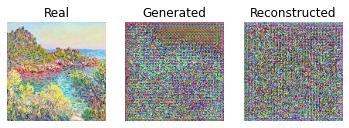

[INFO] Domain B to Domain A


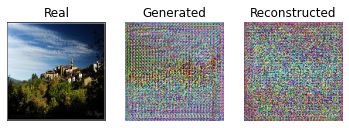

epoch: 0 step: 1 dA_loss: 10.208 dB_loss: 8.900 gAB_loss :12.222 gBA_loss: 12.086
[INFO] Domain A to Domain B


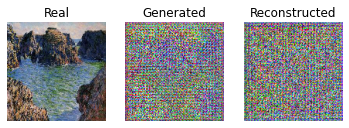

[INFO] Domain B to Domain A


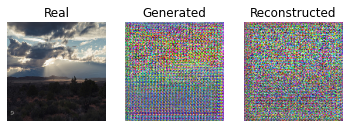

epoch: 0 step: 2 dA_loss: 4.382 dB_loss: 4.343 gAB_loss :10.707 gBA_loss: 11.594
[INFO] Domain A to Domain B


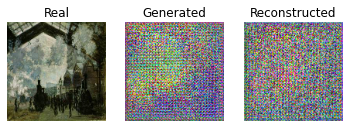

[INFO] Domain B to Domain A


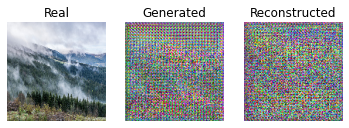

epoch: 0 step: 3 dA_loss: 4.158 dB_loss: 2.603 gAB_loss :10.558 gBA_loss: 11.324
[INFO] Domain A to Domain B


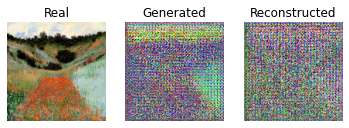

[INFO] Domain B to Domain A


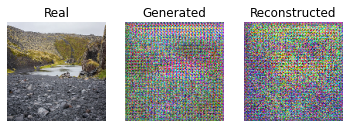

epoch: 0 step: 4 dA_loss: 2.528 dB_loss: 2.669 gAB_loss :9.996 gBA_loss: 10.192
[INFO] Domain A to Domain B


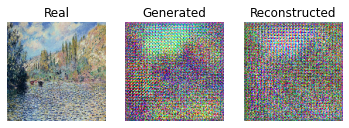

[INFO] Domain B to Domain A


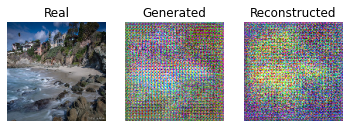

epoch: 0 step: 5 dA_loss: 2.525 dB_loss: 2.454 gAB_loss :10.399 gBA_loss: 10.622
[INFO] Domain A to Domain B


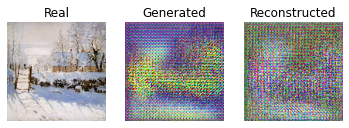

[INFO] Domain B to Domain A


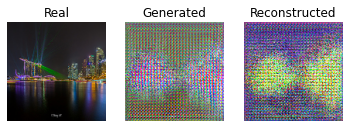

epoch: 0 step: 6 dA_loss: 2.130 dB_loss: 2.478 gAB_loss :9.554 gBA_loss: 9.336
[INFO] Domain A to Domain B


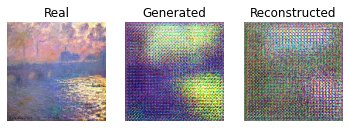

[INFO] Domain B to Domain A


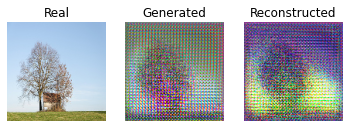

epoch: 0 step: 7 dA_loss: 1.956 dB_loss: 2.102 gAB_loss :9.289 gBA_loss: 8.862
[INFO] Domain A to Domain B


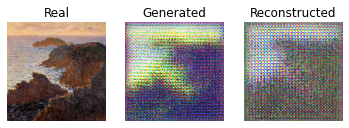

[INFO] Domain B to Domain A


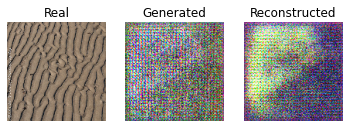

epoch: 0 step: 8 dA_loss: 1.782 dB_loss: 1.735 gAB_loss :8.919 gBA_loss: 8.929
[INFO] Domain A to Domain B


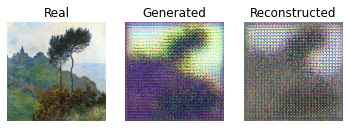

[INFO] Domain B to Domain A


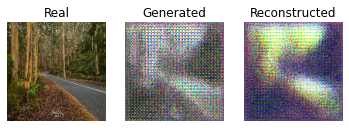

epoch: 0 step: 9 dA_loss: 1.711 dB_loss: 1.904 gAB_loss :8.223 gBA_loss: 8.007
[INFO] Domain A to Domain B


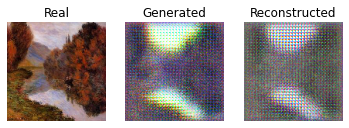

[INFO] Domain B to Domain A


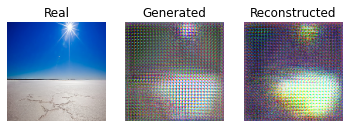

epoch: 0 step: 10 dA_loss: 1.680 dB_loss: 1.815 gAB_loss :8.015 gBA_loss: 7.841
[INFO] Domain A to Domain B


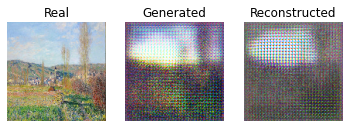

[INFO] Domain B to Domain A


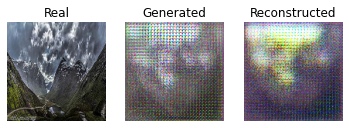

epoch: 0 step: 11 dA_loss: 1.541 dB_loss: 1.781 gAB_loss :7.818 gBA_loss: 7.358
[INFO] Domain A to Domain B


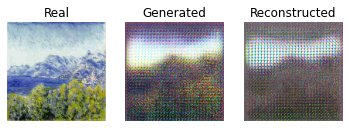

[INFO] Domain B to Domain A


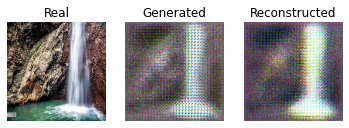

epoch: 0 step: 12 dA_loss: 1.712 dB_loss: 2.279 gAB_loss :9.058 gBA_loss: 9.249
[INFO] Domain A to Domain B


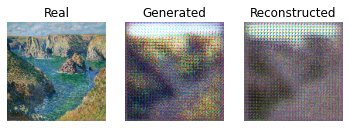

[INFO] Domain B to Domain A


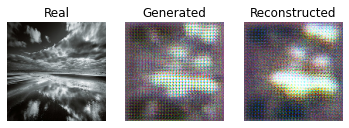

epoch: 0 step: 13 dA_loss: 2.590 dB_loss: 4.397 gAB_loss :9.742 gBA_loss: 11.428
[INFO] Domain A to Domain B


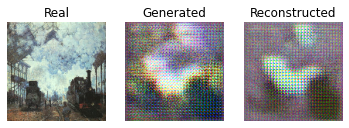

[INFO] Domain B to Domain A


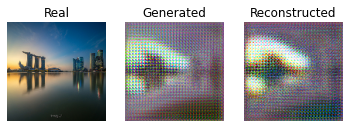

epoch: 0 step: 14 dA_loss: 4.225 dB_loss: 3.686 gAB_loss :8.247 gBA_loss: 9.766
[INFO] Domain A to Domain B


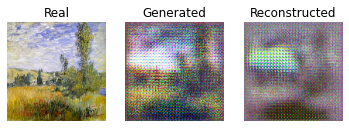

[INFO] Domain B to Domain A


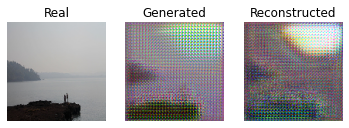

epoch: 0 step: 15 dA_loss: 2.800 dB_loss: 2.010 gAB_loss :7.247 gBA_loss: 8.126
[INFO] Domain A to Domain B


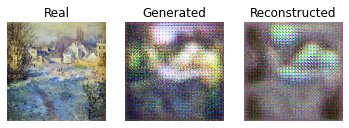

[INFO] Domain B to Domain A


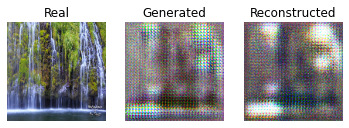

epoch: 0 step: 16 dA_loss: 2.022 dB_loss: 1.688 gAB_loss :6.959 gBA_loss: 7.076
[INFO] Domain A to Domain B


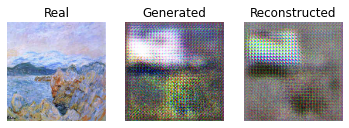

[INFO] Domain B to Domain A


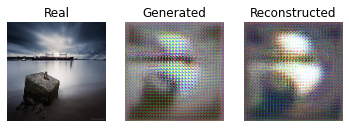

epoch: 0 step: 17 dA_loss: 1.721 dB_loss: 1.636 gAB_loss :6.910 gBA_loss: 7.422
[INFO] Domain A to Domain B


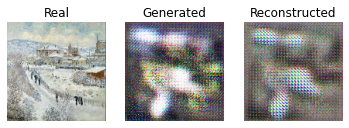

[INFO] Domain B to Domain A


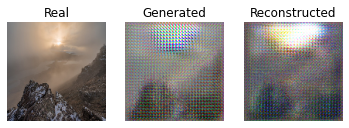

epoch: 0 step: 18 dA_loss: 1.630 dB_loss: 1.348 gAB_loss :6.778 gBA_loss: 6.997
[INFO] Domain A to Domain B


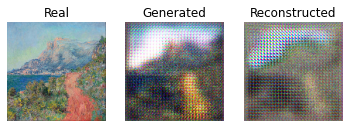

[INFO] Domain B to Domain A


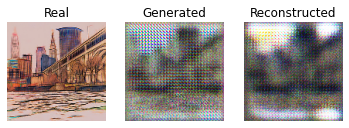

epoch: 0 step: 19 dA_loss: 1.409 dB_loss: 1.441 gAB_loss :6.811 gBA_loss: 6.785
[INFO] Domain A to Domain B


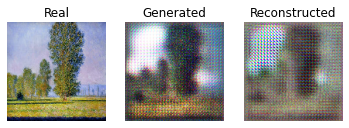

[INFO] Domain B to Domain A


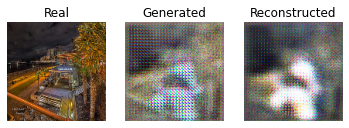

epoch: 0 step: 20 dA_loss: 1.275 dB_loss: 1.362 gAB_loss :6.232 gBA_loss: 6.590
[INFO] Domain A to Domain B


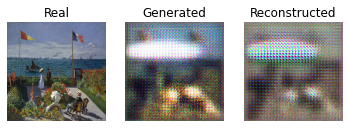

[INFO] Domain B to Domain A


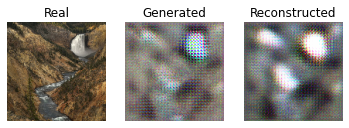

epoch: 0 step: 21 dA_loss: 1.131 dB_loss: 1.474 gAB_loss :6.614 gBA_loss: 6.510
[INFO] Domain A to Domain B


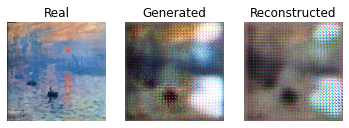

[INFO] Domain B to Domain A


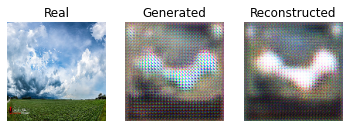

epoch: 0 step: 22 dA_loss: 1.391 dB_loss: 1.244 gAB_loss :6.054 gBA_loss: 6.682
[INFO] Domain A to Domain B


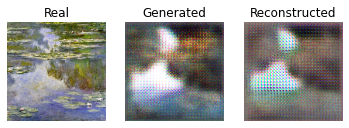

[INFO] Domain B to Domain A


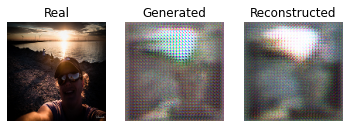

epoch: 0 step: 23 dA_loss: 1.401 dB_loss: 1.205 gAB_loss :6.515 gBA_loss: 7.101
[INFO] Domain A to Domain B


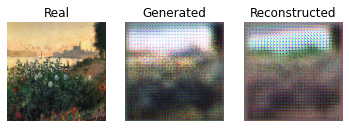

[INFO] Domain B to Domain A


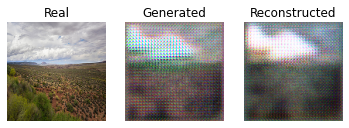

epoch: 0 step: 24 dA_loss: 1.452 dB_loss: 1.206 gAB_loss :6.713 gBA_loss: 7.036
[INFO] Domain A to Domain B


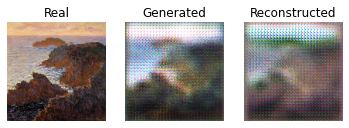

[INFO] Domain B to Domain A


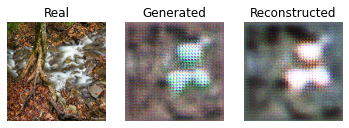

epoch: 0 step: 25 dA_loss: 1.165 dB_loss: 1.172 gAB_loss :5.896 gBA_loss: 6.205
[INFO] Domain A to Domain B


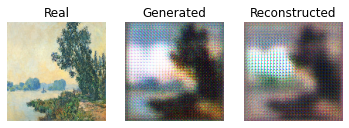

[INFO] Domain B to Domain A


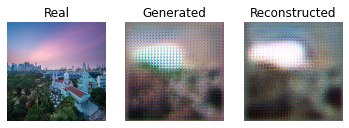

epoch: 0 step: 26 dA_loss: 1.162 dB_loss: 1.370 gAB_loss :6.556 gBA_loss: 5.934
[INFO] Domain A to Domain B


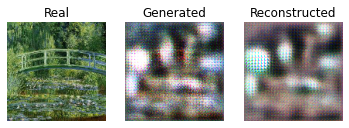

[INFO] Domain B to Domain A


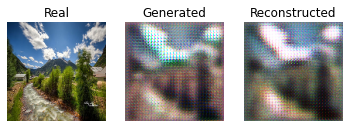

epoch: 0 step: 27 dA_loss: 1.138 dB_loss: 2.129 gAB_loss :7.297 gBA_loss: 6.635
[INFO] Domain A to Domain B


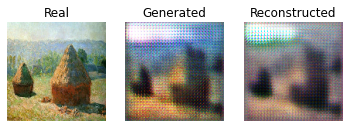

[INFO] Domain B to Domain A


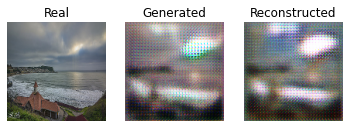

epoch: 0 step: 28 dA_loss: 1.295 dB_loss: 2.847 gAB_loss :6.863 gBA_loss: 6.078
[INFO] Domain A to Domain B


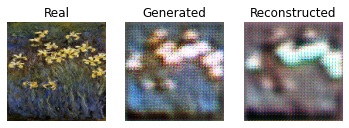

[INFO] Domain B to Domain A


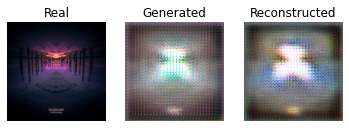

epoch: 0 step: 29 dA_loss: 1.294 dB_loss: 2.352 gAB_loss :6.145 gBA_loss: 5.958
[INFO] Domain A to Domain B


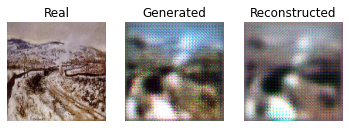

[INFO] Domain B to Domain A


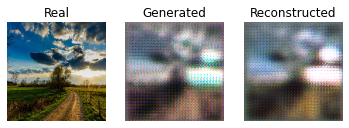

epoch: 0 step: 30 dA_loss: 1.214 dB_loss: 1.528 gAB_loss :6.468 gBA_loss: 6.485
[INFO] Domain A to Domain B


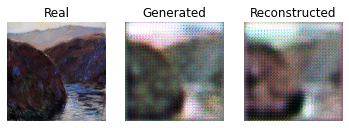

[INFO] Domain B to Domain A


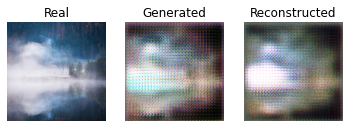

epoch: 0 step: 31 dA_loss: 1.448 dB_loss: 1.395 gAB_loss :6.005 gBA_loss: 6.311
[INFO] Domain A to Domain B


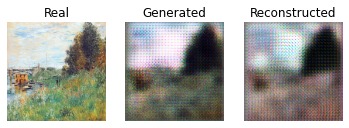

[INFO] Domain B to Domain A


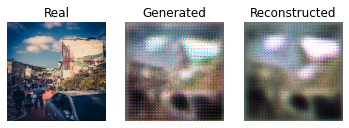

epoch: 0 step: 32 dA_loss: 1.556 dB_loss: 1.361 gAB_loss :6.044 gBA_loss: 6.186
[INFO] Domain A to Domain B


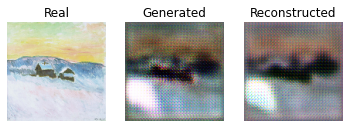

[INFO] Domain B to Domain A


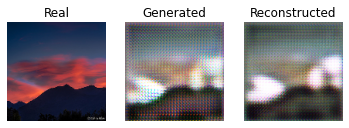

epoch: 0 step: 33 dA_loss: 1.342 dB_loss: 1.248 gAB_loss :6.263 gBA_loss: 6.284
[INFO] Domain A to Domain B


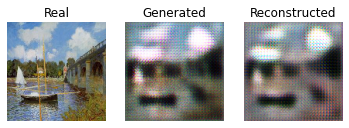

[INFO] Domain B to Domain A


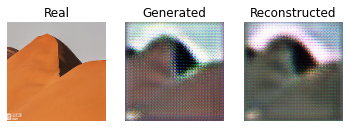

epoch: 0 step: 34 dA_loss: 1.516 dB_loss: 1.436 gAB_loss :6.222 gBA_loss: 6.540
[INFO] Domain A to Domain B


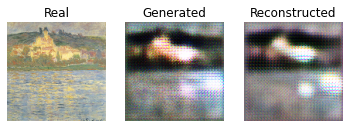

[INFO] Domain B to Domain A


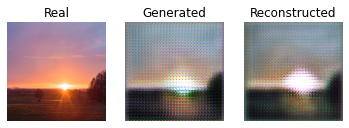

epoch: 0 step: 35 dA_loss: 1.552 dB_loss: 1.347 gAB_loss :5.529 gBA_loss: 6.365
[INFO] Domain A to Domain B


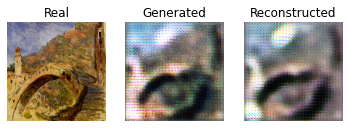

[INFO] Domain B to Domain A


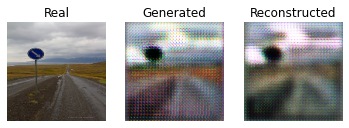

epoch: 0 step: 36 dA_loss: 1.604 dB_loss: 1.072 gAB_loss :5.883 gBA_loss: 6.304
[INFO] Domain A to Domain B


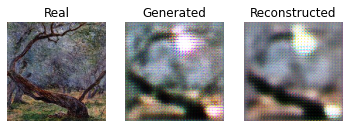

[INFO] Domain B to Domain A


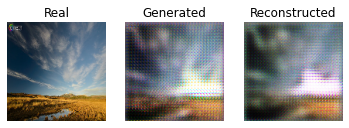

epoch: 0 step: 37 dA_loss: 1.229 dB_loss: 1.054 gAB_loss :5.777 gBA_loss: 5.816
[INFO] Domain A to Domain B


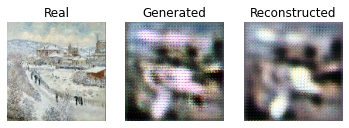

[INFO] Domain B to Domain A


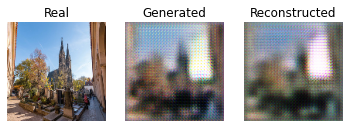

epoch: 0 step: 38 dA_loss: 1.142 dB_loss: 0.954 gAB_loss :5.234 gBA_loss: 5.517
[INFO] Domain A to Domain B


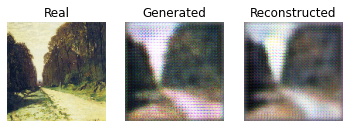

[INFO] Domain B to Domain A


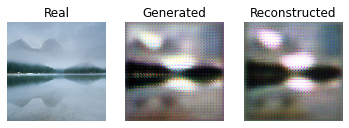

epoch: 0 step: 39 dA_loss: 1.052 dB_loss: 0.872 gAB_loss :5.927 gBA_loss: 5.926
[INFO] Domain A to Domain B


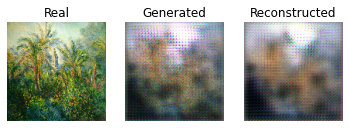

[INFO] Domain B to Domain A


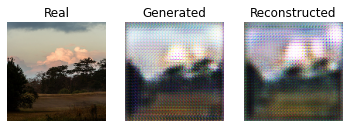

epoch: 0 step: 40 dA_loss: 1.031 dB_loss: 0.900 gAB_loss :5.560 gBA_loss: 5.992
[INFO] Domain A to Domain B


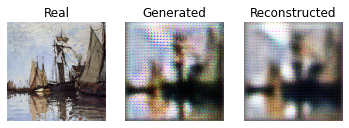

[INFO] Domain B to Domain A


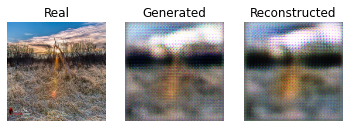

epoch: 0 step: 41 dA_loss: 1.020 dB_loss: 0.980 gAB_loss :5.737 gBA_loss: 5.814
[INFO] Domain A to Domain B


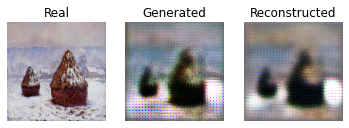

[INFO] Domain B to Domain A


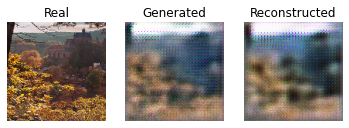

epoch: 0 step: 42 dA_loss: 1.018 dB_loss: 0.960 gAB_loss :5.338 gBA_loss: 5.437
[INFO] Domain A to Domain B


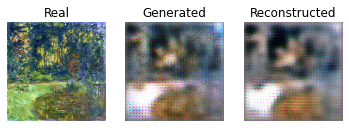

[INFO] Domain B to Domain A


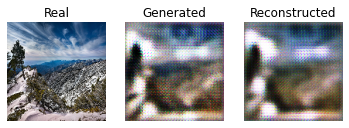

epoch: 0 step: 43 dA_loss: 0.840 dB_loss: 0.866 gAB_loss :5.857 gBA_loss: 5.974
[INFO] Domain A to Domain B


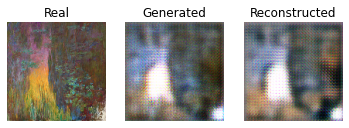

[INFO] Domain B to Domain A


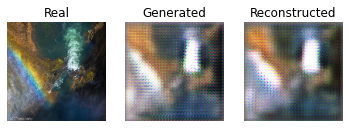

epoch: 0 step: 44 dA_loss: 1.016 dB_loss: 0.951 gAB_loss :5.834 gBA_loss: 5.464
[INFO] Domain A to Domain B


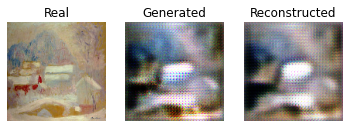

[INFO] Domain B to Domain A


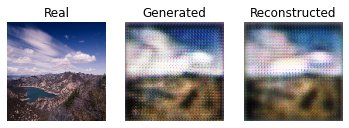

epoch: 0 step: 45 dA_loss: 0.957 dB_loss: 0.923 gAB_loss :5.374 gBA_loss: 5.531
[INFO] Domain A to Domain B


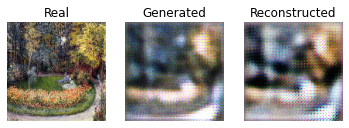

[INFO] Domain B to Domain A


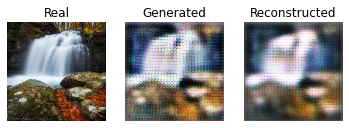

epoch: 0 step: 46 dA_loss: 1.028 dB_loss: 0.780 gAB_loss :5.668 gBA_loss: 5.737
[INFO] Domain A to Domain B


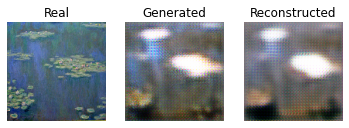

[INFO] Domain B to Domain A


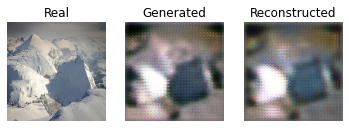

epoch: 0 step: 47 dA_loss: 0.914 dB_loss: 0.777 gAB_loss :5.440 gBA_loss: 6.084
[INFO] Domain A to Domain B


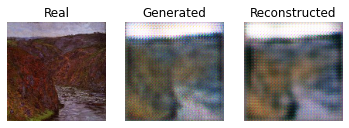

[INFO] Domain B to Domain A


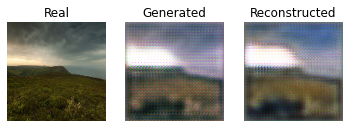

epoch: 0 step: 48 dA_loss: 1.556 dB_loss: 0.880 gAB_loss :5.279 gBA_loss: 6.550
[INFO] Domain A to Domain B


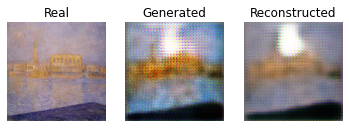

[INFO] Domain B to Domain A


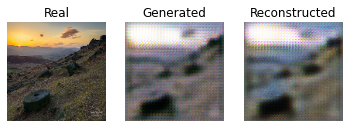

epoch: 0 step: 49 dA_loss: 2.404 dB_loss: 0.952 gAB_loss :5.517 gBA_loss: 7.234
[INFO] Domain A to Domain B


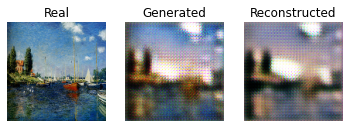

[INFO] Domain B to Domain A


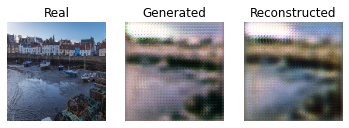

epoch: 0 step: 50 dA_loss: 1.759 dB_loss: 0.840 gAB_loss :5.413 gBA_loss: 5.874
[INFO] Domain A to Domain B


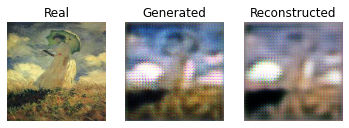

[INFO] Domain B to Domain A


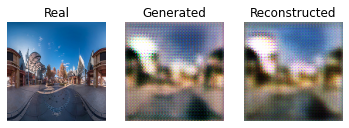

epoch: 0 step: 51 dA_loss: 1.029 dB_loss: 0.840 gAB_loss :5.571 gBA_loss: 5.796
[INFO] Domain A to Domain B


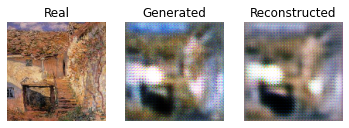

[INFO] Domain B to Domain A


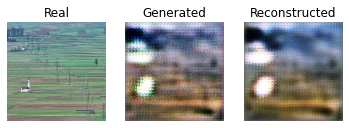

epoch: 0 step: 52 dA_loss: 1.438 dB_loss: 0.785 gAB_loss :5.615 gBA_loss: 6.006
[INFO] Domain A to Domain B


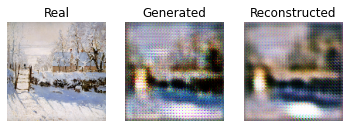

[INFO] Domain B to Domain A


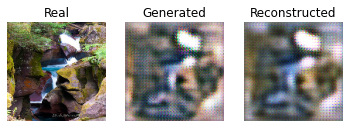

epoch: 0 step: 53 dA_loss: 1.664 dB_loss: 0.842 gAB_loss :5.492 gBA_loss: 5.977
[INFO] Domain A to Domain B


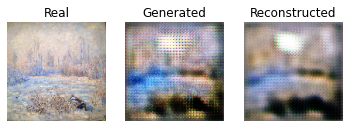

[INFO] Domain B to Domain A


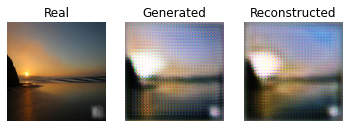

epoch: 0 step: 54 dA_loss: 1.349 dB_loss: 0.817 gAB_loss :5.467 gBA_loss: 5.650
[INFO] Domain A to Domain B


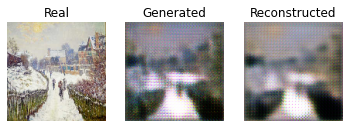

[INFO] Domain B to Domain A


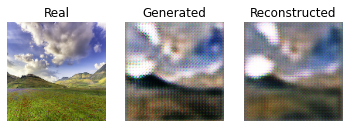

epoch: 0 step: 55 dA_loss: 1.058 dB_loss: 0.744 gAB_loss :5.570 gBA_loss: 5.567
[INFO] Domain A to Domain B


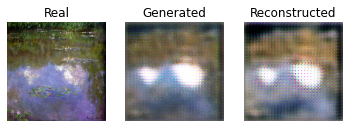

[INFO] Domain B to Domain A


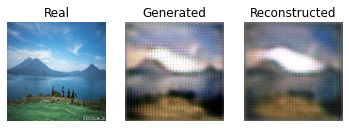

epoch: 0 step: 56 dA_loss: 0.958 dB_loss: 0.816 gAB_loss :5.502 gBA_loss: 5.636
[INFO] Domain A to Domain B


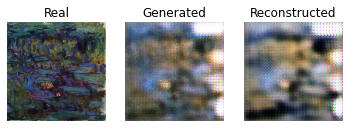

[INFO] Domain B to Domain A


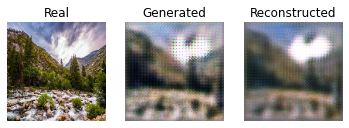

epoch: 0 step: 57 dA_loss: 0.985 dB_loss: 0.785 gAB_loss :5.496 gBA_loss: 5.356
[INFO] Domain A to Domain B


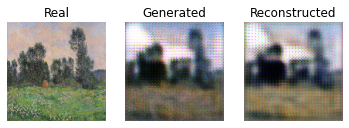

[INFO] Domain B to Domain A


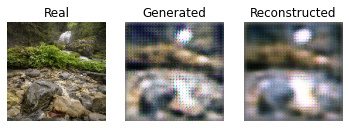

epoch: 0 step: 58 dA_loss: 0.872 dB_loss: 0.737 gAB_loss :5.574 gBA_loss: 5.535
[INFO] Domain A to Domain B


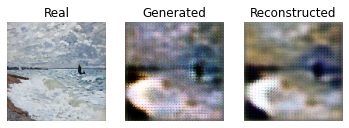

[INFO] Domain B to Domain A


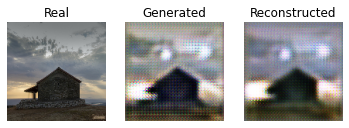

epoch: 0 step: 59 dA_loss: 0.845 dB_loss: 0.832 gAB_loss :5.378 gBA_loss: 5.319
[INFO] Domain A to Domain B


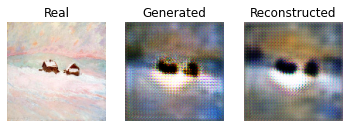

[INFO] Domain B to Domain A


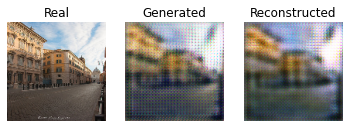

epoch: 0 step: 60 dA_loss: 0.859 dB_loss: 1.064 gAB_loss :5.852 gBA_loss: 5.381
[INFO] Domain A to Domain B


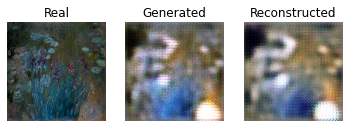

[INFO] Domain B to Domain A


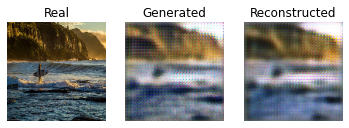

epoch: 0 step: 61 dA_loss: 0.853 dB_loss: 1.405 gAB_loss :5.928 gBA_loss: 5.243
[INFO] Domain A to Domain B


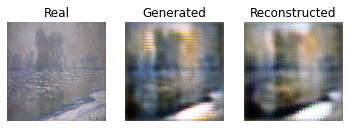

[INFO] Domain B to Domain A


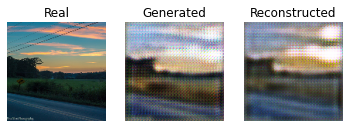

epoch: 0 step: 62 dA_loss: 0.792 dB_loss: 1.750 gAB_loss :5.710 gBA_loss: 5.271
[INFO] Domain A to Domain B


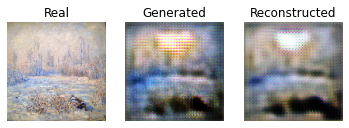

[INFO] Domain B to Domain A


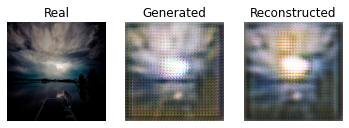

epoch: 0 step: 63 dA_loss: 0.708 dB_loss: 1.006 gAB_loss :5.710 gBA_loss: 5.085
[INFO] Domain A to Domain B


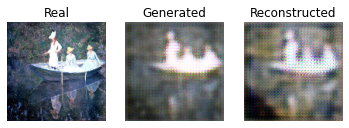

[INFO] Domain B to Domain A


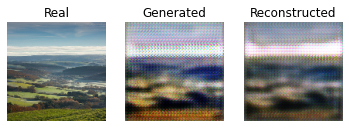

epoch: 0 step: 64 dA_loss: 0.893 dB_loss: 0.996 gAB_loss :5.367 gBA_loss: 5.217
[INFO] Domain A to Domain B


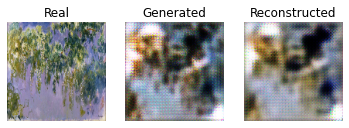

[INFO] Domain B to Domain A


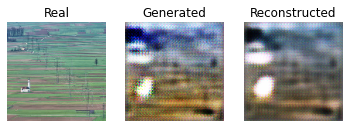

epoch: 0 step: 65 dA_loss: 0.831 dB_loss: 0.875 gAB_loss :5.152 gBA_loss: 5.127
[INFO] Domain A to Domain B


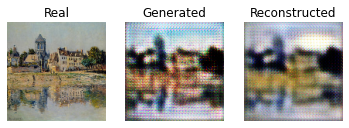

[INFO] Domain B to Domain A


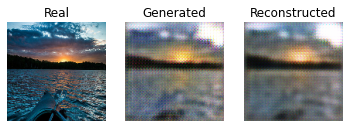

epoch: 0 step: 66 dA_loss: 0.784 dB_loss: 0.838 gAB_loss :5.130 gBA_loss: 4.947
[INFO] Domain A to Domain B


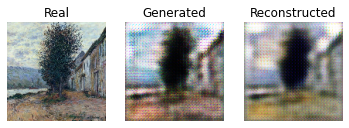

[INFO] Domain B to Domain A


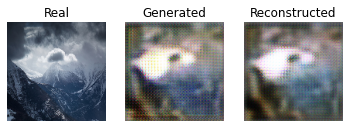

epoch: 0 step: 67 dA_loss: 0.794 dB_loss: 0.944 gAB_loss :5.373 gBA_loss: 5.672
[INFO] Domain A to Domain B


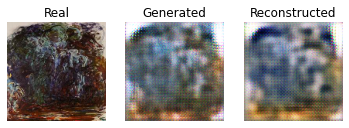

[INFO] Domain B to Domain A


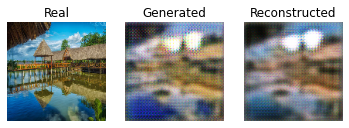

epoch: 0 step: 68 dA_loss: 0.797 dB_loss: 0.794 gAB_loss :5.074 gBA_loss: 4.872
[INFO] Domain A to Domain B


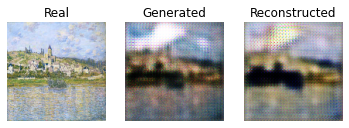

[INFO] Domain B to Domain A


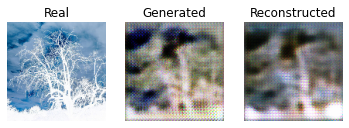

epoch: 0 step: 69 dA_loss: 0.925 dB_loss: 0.711 gAB_loss :5.245 gBA_loss: 5.562
[INFO] Domain A to Domain B


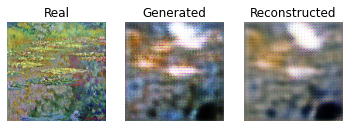

[INFO] Domain B to Domain A


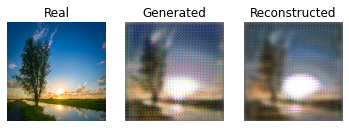

epoch: 0 step: 70 dA_loss: 0.735 dB_loss: 0.756 gAB_loss :5.383 gBA_loss: 5.405
[INFO] Domain A to Domain B


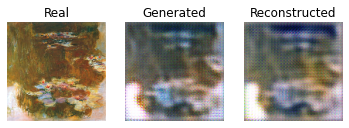

[INFO] Domain B to Domain A


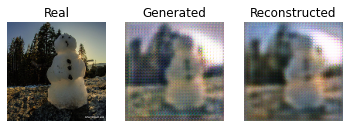

epoch: 0 step: 71 dA_loss: 0.705 dB_loss: 0.822 gAB_loss :5.132 gBA_loss: 5.215
[INFO] Domain A to Domain B


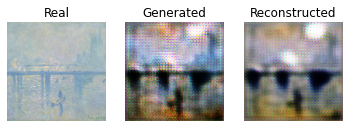

[INFO] Domain B to Domain A


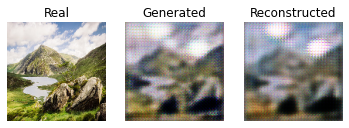

epoch: 0 step: 72 dA_loss: 0.696 dB_loss: 0.886 gAB_loss :4.979 gBA_loss: 4.969
[INFO] Domain A to Domain B


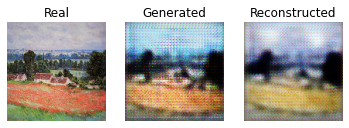

[INFO] Domain B to Domain A


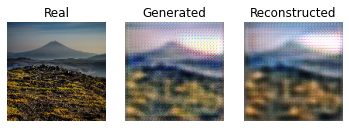

epoch: 0 step: 73 dA_loss: 0.705 dB_loss: 0.880 gAB_loss :5.272 gBA_loss: 5.309
[INFO] Domain A to Domain B


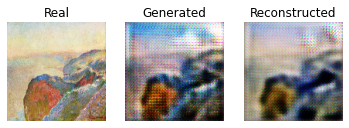

[INFO] Domain B to Domain A


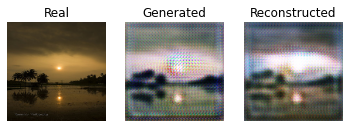

  1%|          | 1/100 [02:52<4:44:43, 172.56s/it]

epoch: 1 step: 0 dA_loss: 0.759 dB_loss: 0.811 gAB_loss :5.453 gBA_loss: 5.802
epoch: 1 step: 1 dA_loss: 1.099 dB_loss: 0.762 gAB_loss :4.720 gBA_loss: 5.133
epoch: 1 step: 2 dA_loss: 1.190 dB_loss: 0.735 gAB_loss :4.903 gBA_loss: 5.403
epoch: 1 step: 3 dA_loss: 1.031 dB_loss: 0.720 gAB_loss :5.115 gBA_loss: 5.398
epoch: 1 step: 4 dA_loss: 1.021 dB_loss: 0.723 gAB_loss :4.849 gBA_loss: 5.123
epoch: 1 step: 5 dA_loss: 0.978 dB_loss: 0.638 gAB_loss :5.329 gBA_loss: 5.952
epoch: 1 step: 6 dA_loss: 0.878 dB_loss: 0.722 gAB_loss :5.174 gBA_loss: 5.517
epoch: 1 step: 7 dA_loss: 0.842 dB_loss: 0.679 gAB_loss :5.220 gBA_loss: 5.317
epoch: 1 step: 8 dA_loss: 0.733 dB_loss: 0.619 gAB_loss :5.334 gBA_loss: 5.715
epoch: 1 step: 9 dA_loss: 0.819 dB_loss: 0.713 gAB_loss :5.299 gBA_loss: 5.385
epoch: 1 step: 10 dA_loss: 0.774 dB_loss: 0.615 gAB_loss :5.322 gBA_loss: 5.417
epoch: 1 step: 11 dA_loss: 0.704 dB_loss: 0.670 gAB_loss :4.977 gBA_loss: 4.876
epoch: 1 step: 12 dA_loss: 0.669 dB_loss: 0.698 gA

  2%|▏         | 2/100 [04:31<4:05:41, 150.42s/it]

epoch: 1 step: 73 dA_loss: 0.420 dB_loss: 0.493 gAB_loss :4.919 gBA_loss: 5.090
epoch: 2 step: 0 dA_loss: 0.420 dB_loss: 0.530 gAB_loss :5.108 gBA_loss: 5.202
epoch: 2 step: 1 dA_loss: 0.623 dB_loss: 0.582 gAB_loss :4.537 gBA_loss: 4.608
epoch: 2 step: 2 dA_loss: 0.632 dB_loss: 0.516 gAB_loss :4.723 gBA_loss: 4.782
epoch: 2 step: 3 dA_loss: 0.627 dB_loss: 0.510 gAB_loss :5.015 gBA_loss: 5.203
epoch: 2 step: 4 dA_loss: 0.741 dB_loss: 0.543 gAB_loss :4.501 gBA_loss: 4.576
epoch: 2 step: 5 dA_loss: 0.573 dB_loss: 0.509 gAB_loss :4.912 gBA_loss: 5.381
epoch: 2 step: 6 dA_loss: 0.491 dB_loss: 0.548 gAB_loss :4.981 gBA_loss: 5.122
epoch: 2 step: 7 dA_loss: 0.531 dB_loss: 0.505 gAB_loss :4.802 gBA_loss: 5.054
epoch: 2 step: 8 dA_loss: 0.509 dB_loss: 0.505 gAB_loss :4.967 gBA_loss: 5.321
epoch: 2 step: 9 dA_loss: 0.535 dB_loss: 0.558 gAB_loss :5.051 gBA_loss: 4.964
epoch: 2 step: 10 dA_loss: 0.492 dB_loss: 0.447 gAB_loss :5.036 gBA_loss: 5.065
epoch: 2 step: 11 dA_loss: 0.469 dB_loss: 0.572 gA

  3%|▎         | 3/100 [06:09<3:37:49, 134.73s/it]

epoch: 2 step: 73 dA_loss: 0.420 dB_loss: 0.398 gAB_loss :4.543 gBA_loss: 4.516
epoch: 3 step: 0 dA_loss: 0.413 dB_loss: 0.405 gAB_loss :4.596 gBA_loss: 4.595
epoch: 3 step: 1 dA_loss: 0.521 dB_loss: 0.456 gAB_loss :4.263 gBA_loss: 4.339
epoch: 3 step: 2 dA_loss: 0.489 dB_loss: 0.440 gAB_loss :4.281 gBA_loss: 4.358
epoch: 3 step: 3 dA_loss: 0.390 dB_loss: 0.462 gAB_loss :4.664 gBA_loss: 4.686
epoch: 3 step: 4 dA_loss: 0.518 dB_loss: 0.515 gAB_loss :4.135 gBA_loss: 4.258
epoch: 3 step: 5 dA_loss: 0.432 dB_loss: 0.448 gAB_loss :4.540 gBA_loss: 4.985
epoch: 3 step: 6 dA_loss: 0.464 dB_loss: 0.429 gAB_loss :4.529 gBA_loss: 4.891
epoch: 3 step: 7 dA_loss: 0.475 dB_loss: 0.419 gAB_loss :4.638 gBA_loss: 4.865
epoch: 3 step: 8 dA_loss: 0.374 dB_loss: 0.440 gAB_loss :4.834 gBA_loss: 4.988
epoch: 3 step: 9 dA_loss: 0.430 dB_loss: 0.518 gAB_loss :4.835 gBA_loss: 4.951
epoch: 3 step: 10 dA_loss: 0.448 dB_loss: 0.392 gAB_loss :5.181 gBA_loss: 4.958
epoch: 3 step: 11 dA_loss: 0.461 dB_loss: 0.520 gA

  4%|▍         | 4/100 [07:47<3:17:58, 123.73s/it]

epoch: 3 step: 73 dA_loss: 0.357 dB_loss: 0.358 gAB_loss :4.621 gBA_loss: 4.685
epoch: 4 step: 0 dA_loss: 0.311 dB_loss: 0.361 gAB_loss :4.510 gBA_loss: 4.703
epoch: 4 step: 1 dA_loss: 0.520 dB_loss: 0.409 gAB_loss :4.301 gBA_loss: 4.247
epoch: 4 step: 2 dA_loss: 0.429 dB_loss: 0.410 gAB_loss :4.054 gBA_loss: 4.245
epoch: 4 step: 3 dA_loss: 0.413 dB_loss: 0.415 gAB_loss :4.621 gBA_loss: 4.970
epoch: 4 step: 4 dA_loss: 0.516 dB_loss: 0.447 gAB_loss :4.070 gBA_loss: 4.172
epoch: 4 step: 5 dA_loss: 0.361 dB_loss: 0.375 gAB_loss :4.487 gBA_loss: 4.858
epoch: 4 step: 6 dA_loss: 0.430 dB_loss: 0.375 gAB_loss :4.467 gBA_loss: 4.848
epoch: 4 step: 7 dA_loss: 0.451 dB_loss: 0.371 gAB_loss :4.589 gBA_loss: 4.805
epoch: 4 step: 8 dA_loss: 0.342 dB_loss: 0.384 gAB_loss :4.739 gBA_loss: 4.949
epoch: 4 step: 9 dA_loss: 0.380 dB_loss: 0.474 gAB_loss :4.835 gBA_loss: 4.837
epoch: 4 step: 10 dA_loss: 0.352 dB_loss: 0.385 gAB_loss :5.020 gBA_loss: 4.715
epoch: 4 step: 11 dA_loss: 0.355 dB_loss: 0.531 gA

  5%|▌         | 5/100 [09:25<3:03:38, 115.99s/it]

epoch: 4 step: 73 dA_loss: 0.354 dB_loss: 0.581 gAB_loss :4.762 gBA_loss: 4.636
epoch: 5 step: 0 dA_loss: 0.297 dB_loss: 0.631 gAB_loss :4.600 gBA_loss: 4.700
epoch: 5 step: 1 dA_loss: 0.518 dB_loss: 0.575 gAB_loss :4.254 gBA_loss: 4.104
epoch: 5 step: 2 dA_loss: 0.408 dB_loss: 0.684 gAB_loss :4.201 gBA_loss: 4.187
epoch: 5 step: 3 dA_loss: 0.353 dB_loss: 0.896 gAB_loss :4.670 gBA_loss: 4.980
epoch: 5 step: 4 dA_loss: 0.480 dB_loss: 0.724 gAB_loss :4.171 gBA_loss: 4.027
epoch: 5 step: 5 dA_loss: 0.361 dB_loss: 0.484 gAB_loss :4.374 gBA_loss: 4.825
epoch: 5 step: 6 dA_loss: 0.450 dB_loss: 0.387 gAB_loss :4.573 gBA_loss: 4.950
epoch: 5 step: 7 dA_loss: 0.453 dB_loss: 0.365 gAB_loss :4.665 gBA_loss: 4.786
epoch: 5 step: 8 dA_loss: 0.299 dB_loss: 0.380 gAB_loss :4.579 gBA_loss: 5.051
epoch: 5 step: 9 dA_loss: 0.333 dB_loss: 0.470 gAB_loss :4.907 gBA_loss: 4.811
epoch: 5 step: 10 dA_loss: 0.309 dB_loss: 0.329 gAB_loss :4.913 gBA_loss: 5.000
epoch: 5 step: 11 dA_loss: 0.328 dB_loss: 0.478 gA

  6%|▌         | 6/100 [11:03<2:53:12, 110.56s/it]

epoch: 5 step: 73 dA_loss: 0.276 dB_loss: 0.375 gAB_loss :4.580 gBA_loss: 4.547
epoch: 6 step: 0 dA_loss: 0.278 dB_loss: 0.474 gAB_loss :4.427 gBA_loss: 4.741
epoch: 6 step: 1 dA_loss: 0.567 dB_loss: 0.541 gAB_loss :4.305 gBA_loss: 4.092
epoch: 6 step: 2 dA_loss: 0.371 dB_loss: 0.595 gAB_loss :4.234 gBA_loss: 4.223
epoch: 6 step: 3 dA_loss: 0.322 dB_loss: 0.627 gAB_loss :4.282 gBA_loss: 4.976
epoch: 6 step: 4 dA_loss: 0.461 dB_loss: 0.507 gAB_loss :4.123 gBA_loss: 4.130
epoch: 6 step: 5 dA_loss: 0.284 dB_loss: 0.388 gAB_loss :4.431 gBA_loss: 4.841
epoch: 6 step: 6 dA_loss: 0.278 dB_loss: 0.410 gAB_loss :4.299 gBA_loss: 4.711
epoch: 6 step: 7 dA_loss: 0.366 dB_loss: 0.358 gAB_loss :4.449 gBA_loss: 4.678
epoch: 6 step: 8 dA_loss: 0.360 dB_loss: 0.315 gAB_loss :4.646 gBA_loss: 5.192
epoch: 6 step: 9 dA_loss: 0.433 dB_loss: 0.377 gAB_loss :4.778 gBA_loss: 4.677
epoch: 6 step: 10 dA_loss: 0.348 dB_loss: 0.301 gAB_loss :4.723 gBA_loss: 4.904
epoch: 6 step: 11 dA_loss: 0.342 dB_loss: 0.466 gA

  7%|▋         | 7/100 [12:41<2:45:24, 106.71s/it]

epoch: 6 step: 73 dA_loss: 0.223 dB_loss: 0.348 gAB_loss :4.408 gBA_loss: 4.591
epoch: 7 step: 0 dA_loss: 0.229 dB_loss: 0.325 gAB_loss :4.479 gBA_loss: 4.776
epoch: 7 step: 1 dA_loss: 0.496 dB_loss: 0.337 gAB_loss :4.114 gBA_loss: 3.925
epoch: 7 step: 2 dA_loss: 0.404 dB_loss: 0.393 gAB_loss :3.954 gBA_loss: 4.369
epoch: 7 step: 3 dA_loss: 0.252 dB_loss: 0.335 gAB_loss :4.145 gBA_loss: 4.608
epoch: 7 step: 4 dA_loss: 0.373 dB_loss: 0.351 gAB_loss :3.886 gBA_loss: 3.877
epoch: 7 step: 5 dA_loss: 0.303 dB_loss: 0.273 gAB_loss :4.431 gBA_loss: 4.890
epoch: 7 step: 6 dA_loss: 0.290 dB_loss: 0.353 gAB_loss :4.252 gBA_loss: 4.629
epoch: 7 step: 7 dA_loss: 0.378 dB_loss: 0.379 gAB_loss :4.807 gBA_loss: 4.567
epoch: 7 step: 8 dA_loss: 0.303 dB_loss: 0.412 gAB_loss :4.545 gBA_loss: 5.166
epoch: 7 step: 9 dA_loss: 0.370 dB_loss: 0.401 gAB_loss :4.791 gBA_loss: 4.678
epoch: 7 step: 10 dA_loss: 0.272 dB_loss: 0.346 gAB_loss :4.869 gBA_loss: 4.545
epoch: 7 step: 11 dA_loss: 0.272 dB_loss: 0.443 gA

  8%|▊         | 8/100 [14:18<2:39:28, 104.01s/it]

epoch: 7 step: 73 dA_loss: 0.253 dB_loss: 0.299 gAB_loss :4.320 gBA_loss: 4.404
epoch: 8 step: 0 dA_loss: 0.212 dB_loss: 0.318 gAB_loss :4.281 gBA_loss: 4.710
epoch: 8 step: 1 dA_loss: 0.422 dB_loss: 0.390 gAB_loss :4.120 gBA_loss: 3.802
epoch: 8 step: 2 dA_loss: 0.462 dB_loss: 0.400 gAB_loss :3.832 gBA_loss: 4.338
epoch: 8 step: 3 dA_loss: 0.255 dB_loss: 0.352 gAB_loss :4.190 gBA_loss: 4.659
epoch: 8 step: 4 dA_loss: 0.385 dB_loss: 0.392 gAB_loss :4.018 gBA_loss: 3.863
epoch: 8 step: 5 dA_loss: 0.289 dB_loss: 0.262 gAB_loss :4.288 gBA_loss: 4.862
epoch: 8 step: 6 dA_loss: 0.264 dB_loss: 0.365 gAB_loss :4.180 gBA_loss: 4.564
epoch: 8 step: 7 dA_loss: 0.465 dB_loss: 0.336 gAB_loss :4.856 gBA_loss: 4.925
epoch: 8 step: 8 dA_loss: 0.233 dB_loss: 0.337 gAB_loss :4.393 gBA_loss: 5.080
epoch: 8 step: 9 dA_loss: 0.385 dB_loss: 0.354 gAB_loss :4.852 gBA_loss: 4.760
epoch: 8 step: 10 dA_loss: 0.252 dB_loss: 0.330 gAB_loss :4.625 gBA_loss: 4.540
epoch: 8 step: 11 dA_loss: 0.283 dB_loss: 0.427 gA

  9%|▉         | 9/100 [15:56<2:34:52, 102.12s/it]

epoch: 8 step: 73 dA_loss: 0.193 dB_loss: 0.245 gAB_loss :4.267 gBA_loss: 4.586
epoch: 9 step: 0 dA_loss: 0.173 dB_loss: 0.223 gAB_loss :4.241 gBA_loss: 4.538
epoch: 9 step: 1 dA_loss: 0.291 dB_loss: 0.274 gAB_loss :4.075 gBA_loss: 3.918
epoch: 9 step: 2 dA_loss: 0.469 dB_loss: 0.354 gAB_loss :4.056 gBA_loss: 4.807
epoch: 9 step: 3 dA_loss: 0.294 dB_loss: 0.323 gAB_loss :4.253 gBA_loss: 4.419
epoch: 9 step: 4 dA_loss: 0.452 dB_loss: 0.304 gAB_loss :4.234 gBA_loss: 4.326
epoch: 9 step: 5 dA_loss: 0.299 dB_loss: 0.216 gAB_loss :4.413 gBA_loss: 4.653
epoch: 9 step: 6 dA_loss: 0.385 dB_loss: 0.350 gAB_loss :4.420 gBA_loss: 4.801
epoch: 9 step: 7 dA_loss: 0.369 dB_loss: 0.287 gAB_loss :4.448 gBA_loss: 4.685
epoch: 9 step: 8 dA_loss: 0.182 dB_loss: 0.254 gAB_loss :4.458 gBA_loss: 4.776
epoch: 9 step: 9 dA_loss: 0.329 dB_loss: 0.315 gAB_loss :4.758 gBA_loss: 4.878
epoch: 9 step: 10 dA_loss: 0.242 dB_loss: 0.253 gAB_loss :4.543 gBA_loss: 4.405
epoch: 9 step: 11 dA_loss: 0.284 dB_loss: 0.391 gA

 10%|█         | 10/100 [17:34<2:31:10, 100.78s/it]

epoch: 9 step: 73 dA_loss: 0.155 dB_loss: 0.492 gAB_loss :4.333 gBA_loss: 4.415
epoch: 10 step: 0 dA_loss: 0.158 dB_loss: 0.474 gAB_loss :4.520 gBA_loss: 4.438
epoch: 10 step: 1 dA_loss: 0.316 dB_loss: 0.390 gAB_loss :3.985 gBA_loss: 3.912
epoch: 10 step: 2 dA_loss: 0.412 dB_loss: 0.373 gAB_loss :3.991 gBA_loss: 4.576
epoch: 10 step: 3 dA_loss: 0.261 dB_loss: 0.289 gAB_loss :4.397 gBA_loss: 4.829
epoch: 10 step: 4 dA_loss: 0.360 dB_loss: 0.455 gAB_loss :4.470 gBA_loss: 3.830
epoch: 10 step: 5 dA_loss: 0.213 dB_loss: 0.262 gAB_loss :4.270 gBA_loss: 4.809
epoch: 10 step: 6 dA_loss: 0.224 dB_loss: 0.395 gAB_loss :4.297 gBA_loss: 4.639
epoch: 10 step: 7 dA_loss: 0.320 dB_loss: 0.298 gAB_loss :4.541 gBA_loss: 4.541
epoch: 10 step: 8 dA_loss: 0.166 dB_loss: 0.319 gAB_loss :4.402 gBA_loss: 4.901
epoch: 10 step: 9 dA_loss: 0.331 dB_loss: 0.287 gAB_loss :4.811 gBA_loss: 4.667
epoch: 10 step: 10 dA_loss: 0.221 dB_loss: 0.252 gAB_loss :4.473 gBA_loss: 4.368
epoch: 10 step: 11 dA_loss: 0.222 dB_lo

 11%|█         | 11/100 [19:11<2:28:06, 99.84s/it] 

epoch: 10 step: 73 dA_loss: 0.141 dB_loss: 0.261 gAB_loss :4.247 gBA_loss: 4.201
epoch: 11 step: 0 dA_loss: 0.191 dB_loss: 0.286 gAB_loss :4.178 gBA_loss: 4.682
epoch: 11 step: 1 dA_loss: 0.334 dB_loss: 0.402 gAB_loss :4.049 gBA_loss: 3.700
epoch: 11 step: 2 dA_loss: 0.481 dB_loss: 0.520 gAB_loss :3.882 gBA_loss: 4.447
epoch: 11 step: 3 dA_loss: 0.294 dB_loss: 0.414 gAB_loss :4.116 gBA_loss: 4.348
epoch: 11 step: 4 dA_loss: 0.485 dB_loss: 0.328 gAB_loss :3.936 gBA_loss: 3.738
epoch: 11 step: 5 dA_loss: 0.309 dB_loss: 0.226 gAB_loss :4.238 gBA_loss: 4.762
epoch: 11 step: 6 dA_loss: 0.258 dB_loss: 0.416 gAB_loss :4.185 gBA_loss: 4.465
epoch: 11 step: 7 dA_loss: 0.337 dB_loss: 0.379 gAB_loss :4.629 gBA_loss: 4.508
epoch: 11 step: 8 dA_loss: 0.198 dB_loss: 0.358 gAB_loss :4.150 gBA_loss: 4.783
epoch: 11 step: 9 dA_loss: 0.279 dB_loss: 0.239 gAB_loss :4.693 gBA_loss: 4.505
epoch: 11 step: 10 dA_loss: 0.222 dB_loss: 0.248 gAB_loss :4.380 gBA_loss: 4.331
epoch: 11 step: 11 dA_loss: 0.198 dB_l

 12%|█▏        | 12/100 [20:49<2:25:28, 99.19s/it]

epoch: 11 step: 73 dA_loss: 0.184 dB_loss: 0.306 gAB_loss :4.098 gBA_loss: 4.363
epoch: 12 step: 0 dA_loss: 0.156 dB_loss: 0.242 gAB_loss :4.507 gBA_loss: 4.474
epoch: 12 step: 1 dA_loss: 0.274 dB_loss: 0.344 gAB_loss :3.998 gBA_loss: 3.867
epoch: 12 step: 2 dA_loss: 0.268 dB_loss: 0.315 gAB_loss :3.852 gBA_loss: 4.289
epoch: 12 step: 3 dA_loss: 0.186 dB_loss: 0.223 gAB_loss :3.972 gBA_loss: 4.664
epoch: 12 step: 4 dA_loss: 0.496 dB_loss: 0.350 gAB_loss :4.028 gBA_loss: 3.742
epoch: 12 step: 5 dA_loss: 0.363 dB_loss: 0.214 gAB_loss :4.357 gBA_loss: 4.913
epoch: 12 step: 6 dA_loss: 0.392 dB_loss: 0.372 gAB_loss :4.450 gBA_loss: 4.454
epoch: 12 step: 7 dA_loss: 0.467 dB_loss: 0.228 gAB_loss :4.309 gBA_loss: 4.822
epoch: 12 step: 8 dA_loss: 0.246 dB_loss: 0.281 gAB_loss :4.613 gBA_loss: 4.881
epoch: 12 step: 9 dA_loss: 0.359 dB_loss: 0.283 gAB_loss :4.569 gBA_loss: 4.458
epoch: 12 step: 10 dA_loss: 0.227 dB_loss: 0.250 gAB_loss :4.427 gBA_loss: 4.552
epoch: 12 step: 11 dA_loss: 0.203 dB_l

 13%|█▎        | 13/100 [22:27<2:23:08, 98.72s/it]

epoch: 12 step: 73 dA_loss: 0.156 dB_loss: 0.245 gAB_loss :4.263 gBA_loss: 4.200
epoch: 13 step: 0 dA_loss: 0.152 dB_loss: 0.221 gAB_loss :4.137 gBA_loss: 4.467
epoch: 13 step: 1 dA_loss: 0.273 dB_loss: 0.297 gAB_loss :3.877 gBA_loss: 3.690
epoch: 13 step: 2 dA_loss: 0.502 dB_loss: 0.310 gAB_loss :3.951 gBA_loss: 4.656
epoch: 13 step: 3 dA_loss: 0.379 dB_loss: 0.177 gAB_loss :3.945 gBA_loss: 4.324
epoch: 13 step: 4 dA_loss: 0.516 dB_loss: 0.258 gAB_loss :4.016 gBA_loss: 3.948
epoch: 13 step: 5 dA_loss: 0.413 dB_loss: 0.174 gAB_loss :4.399 gBA_loss: 4.749
epoch: 13 step: 6 dA_loss: 0.435 dB_loss: 0.337 gAB_loss :4.080 gBA_loss: 4.417
epoch: 13 step: 7 dA_loss: 0.448 dB_loss: 0.273 gAB_loss :4.484 gBA_loss: 4.594
epoch: 13 step: 8 dA_loss: 0.235 dB_loss: 0.291 gAB_loss :4.607 gBA_loss: 4.830
epoch: 13 step: 9 dA_loss: 0.353 dB_loss: 0.231 gAB_loss :4.671 gBA_loss: 4.607
epoch: 13 step: 10 dA_loss: 0.217 dB_loss: 0.200 gAB_loss :4.390 gBA_loss: 4.256
epoch: 13 step: 11 dA_loss: 0.225 dB_l

 14%|█▍        | 14/100 [24:04<2:21:02, 98.41s/it]

epoch: 13 step: 73 dA_loss: 0.143 dB_loss: 0.242 gAB_loss :4.206 gBA_loss: 4.172
epoch: 14 step: 0 dA_loss: 0.147 dB_loss: 0.191 gAB_loss :4.282 gBA_loss: 4.311
epoch: 14 step: 1 dA_loss: 0.270 dB_loss: 0.253 gAB_loss :3.774 gBA_loss: 3.973
epoch: 14 step: 2 dA_loss: 0.256 dB_loss: 0.302 gAB_loss :3.988 gBA_loss: 4.056
epoch: 14 step: 3 dA_loss: 0.267 dB_loss: 0.168 gAB_loss :4.203 gBA_loss: 5.043
epoch: 14 step: 4 dA_loss: 0.608 dB_loss: 0.283 gAB_loss :4.499 gBA_loss: 3.821
epoch: 14 step: 5 dA_loss: 0.550 dB_loss: 0.186 gAB_loss :4.447 gBA_loss: 5.256
epoch: 14 step: 6 dA_loss: 0.559 dB_loss: 0.319 gAB_loss :4.181 gBA_loss: 4.340
epoch: 14 step: 7 dA_loss: 0.628 dB_loss: 0.261 gAB_loss :4.544 gBA_loss: 4.664
epoch: 14 step: 8 dA_loss: 0.446 dB_loss: 0.247 gAB_loss :4.606 gBA_loss: 4.750
epoch: 14 step: 9 dA_loss: 0.513 dB_loss: 0.211 gAB_loss :4.379 gBA_loss: 4.348
epoch: 14 step: 10 dA_loss: 0.516 dB_loss: 0.173 gAB_loss :4.497 gBA_loss: 4.335
epoch: 14 step: 11 dA_loss: 0.378 dB_l

 15%|█▌        | 15/100 [25:42<2:19:05, 98.19s/it]

epoch: 14 step: 73 dA_loss: 0.204 dB_loss: 0.197 gAB_loss :4.168 gBA_loss: 4.202
epoch: 15 step: 0 dA_loss: 0.182 dB_loss: 0.159 gAB_loss :4.381 gBA_loss: 4.459
epoch: 15 step: 1 dA_loss: 0.268 dB_loss: 0.235 gAB_loss :3.822 gBA_loss: 3.573
epoch: 15 step: 2 dA_loss: 0.335 dB_loss: 0.261 gAB_loss :3.771 gBA_loss: 4.443
epoch: 15 step: 3 dA_loss: 0.163 dB_loss: 0.166 gAB_loss :4.114 gBA_loss: 4.194
epoch: 15 step: 4 dA_loss: 0.291 dB_loss: 0.241 gAB_loss :3.632 gBA_loss: 3.636
epoch: 15 step: 5 dA_loss: 0.275 dB_loss: 0.190 gAB_loss :4.775 gBA_loss: 4.830
epoch: 15 step: 6 dA_loss: 0.264 dB_loss: 0.392 gAB_loss :3.969 gBA_loss: 4.394
epoch: 15 step: 7 dA_loss: 0.288 dB_loss: 0.300 gAB_loss :4.449 gBA_loss: 4.261
epoch: 15 step: 8 dA_loss: 0.173 dB_loss: 0.196 gAB_loss :4.708 gBA_loss: 5.242
epoch: 15 step: 9 dA_loss: 0.359 dB_loss: 0.206 gAB_loss :4.649 gBA_loss: 4.353
epoch: 15 step: 10 dA_loss: 0.265 dB_loss: 0.187 gAB_loss :4.348 gBA_loss: 4.403
epoch: 15 step: 11 dA_loss: 0.292 dB_l

 16%|█▌        | 16/100 [27:19<2:17:10, 97.98s/it]

epoch: 15 step: 73 dA_loss: 0.164 dB_loss: 0.243 gAB_loss :4.113 gBA_loss: 4.249
epoch: 16 step: 0 dA_loss: 0.178 dB_loss: 0.178 gAB_loss :4.253 gBA_loss: 4.039
epoch: 16 step: 1 dA_loss: 0.343 dB_loss: 0.214 gAB_loss :3.627 gBA_loss: 3.991
epoch: 16 step: 2 dA_loss: 0.273 dB_loss: 0.236 gAB_loss :3.988 gBA_loss: 3.941
epoch: 16 step: 3 dA_loss: 0.325 dB_loss: 0.177 gAB_loss :4.412 gBA_loss: 5.362
epoch: 16 step: 4 dA_loss: 0.659 dB_loss: 0.263 gAB_loss :3.694 gBA_loss: 3.520
epoch: 16 step: 5 dA_loss: 0.751 dB_loss: 0.295 gAB_loss :4.833 gBA_loss: 5.280
epoch: 16 step: 6 dA_loss: 0.552 dB_loss: 0.427 gAB_loss :3.891 gBA_loss: 4.075
epoch: 16 step: 7 dA_loss: 0.466 dB_loss: 0.380 gAB_loss :4.554 gBA_loss: 4.415
epoch: 16 step: 8 dA_loss: 0.347 dB_loss: 0.306 gAB_loss :4.322 gBA_loss: 4.737
epoch: 16 step: 9 dA_loss: 0.351 dB_loss: 0.258 gAB_loss :4.738 gBA_loss: 4.431
epoch: 16 step: 10 dA_loss: 0.284 dB_loss: 0.253 gAB_loss :4.471 gBA_loss: 4.112
epoch: 16 step: 11 dA_loss: 0.262 dB_l

 17%|█▋        | 17/100 [28:57<2:15:20, 97.84s/it]

epoch: 16 step: 73 dA_loss: 0.156 dB_loss: 0.290 gAB_loss :4.280 gBA_loss: 4.437
epoch: 17 step: 0 dA_loss: 0.176 dB_loss: 0.208 gAB_loss :4.393 gBA_loss: 4.221
epoch: 17 step: 1 dA_loss: 0.337 dB_loss: 0.246 gAB_loss :3.897 gBA_loss: 3.920
epoch: 17 step: 2 dA_loss: 0.408 dB_loss: 0.208 gAB_loss :3.791 gBA_loss: 4.284
epoch: 17 step: 3 dA_loss: 0.299 dB_loss: 0.152 gAB_loss :4.216 gBA_loss: 4.501
epoch: 17 step: 4 dA_loss: 0.395 dB_loss: 0.246 gAB_loss :3.874 gBA_loss: 3.601
epoch: 17 step: 5 dA_loss: 0.350 dB_loss: 0.153 gAB_loss :4.447 gBA_loss: 4.924
epoch: 17 step: 6 dA_loss: 0.391 dB_loss: 0.284 gAB_loss :4.252 gBA_loss: 4.907
epoch: 17 step: 7 dA_loss: 0.356 dB_loss: 0.202 gAB_loss :4.442 gBA_loss: 4.185
epoch: 17 step: 8 dA_loss: 0.254 dB_loss: 0.146 gAB_loss :4.582 gBA_loss: 4.852
epoch: 17 step: 9 dA_loss: 0.283 dB_loss: 0.165 gAB_loss :4.562 gBA_loss: 4.441
epoch: 17 step: 10 dA_loss: 0.254 dB_loss: 0.166 gAB_loss :4.312 gBA_loss: 4.219
epoch: 17 step: 11 dA_loss: 0.194 dB_l

 18%|█▊        | 18/100 [30:35<2:13:37, 97.77s/it]

epoch: 17 step: 73 dA_loss: 0.144 dB_loss: 0.196 gAB_loss :3.953 gBA_loss: 4.352
epoch: 18 step: 0 dA_loss: 0.145 dB_loss: 0.240 gAB_loss :4.643 gBA_loss: 3.961
epoch: 18 step: 1 dA_loss: 0.295 dB_loss: 0.233 gAB_loss :3.581 gBA_loss: 3.743
epoch: 18 step: 2 dA_loss: 0.219 dB_loss: 0.274 gAB_loss :3.955 gBA_loss: 3.848
epoch: 18 step: 3 dA_loss: 0.273 dB_loss: 0.159 gAB_loss :4.381 gBA_loss: 4.819
epoch: 18 step: 4 dA_loss: 0.583 dB_loss: 0.284 gAB_loss :3.716 gBA_loss: 3.722
epoch: 18 step: 5 dA_loss: 0.219 dB_loss: 0.225 gAB_loss :4.743 gBA_loss: 4.504
epoch: 18 step: 6 dA_loss: 0.318 dB_loss: 0.311 gAB_loss :4.030 gBA_loss: 4.897
epoch: 18 step: 7 dA_loss: 0.362 dB_loss: 0.269 gAB_loss :4.608 gBA_loss: 4.156
epoch: 18 step: 8 dA_loss: 0.237 dB_loss: 0.182 gAB_loss :4.517 gBA_loss: 4.970
epoch: 18 step: 9 dA_loss: 0.276 dB_loss: 0.173 gAB_loss :4.566 gBA_loss: 4.514
epoch: 18 step: 10 dA_loss: 0.181 dB_loss: 0.118 gAB_loss :4.666 gBA_loss: 4.190
epoch: 18 step: 11 dA_loss: 0.206 dB_l

 19%|█▉        | 19/100 [32:12<2:11:57, 97.75s/it]

epoch: 18 step: 73 dA_loss: 0.145 dB_loss: 0.172 gAB_loss :4.107 gBA_loss: 4.374
epoch: 19 step: 0 dA_loss: 0.147 dB_loss: 0.169 gAB_loss :4.309 gBA_loss: 3.886
epoch: 19 step: 1 dA_loss: 0.336 dB_loss: 0.187 gAB_loss :3.749 gBA_loss: 3.653
epoch: 19 step: 2 dA_loss: 0.236 dB_loss: 0.217 gAB_loss :3.696 gBA_loss: 3.852
epoch: 19 step: 3 dA_loss: 0.221 dB_loss: 0.163 gAB_loss :4.391 gBA_loss: 4.502
epoch: 19 step: 4 dA_loss: 0.442 dB_loss: 0.259 gAB_loss :3.614 gBA_loss: 3.634
epoch: 19 step: 5 dA_loss: 0.194 dB_loss: 0.164 gAB_loss :4.502 gBA_loss: 4.541
epoch: 19 step: 6 dA_loss: 0.305 dB_loss: 0.256 gAB_loss :4.136 gBA_loss: 4.652
epoch: 19 step: 7 dA_loss: 0.294 dB_loss: 0.237 gAB_loss :4.166 gBA_loss: 3.939
epoch: 19 step: 8 dA_loss: 0.209 dB_loss: 0.161 gAB_loss :4.650 gBA_loss: 4.797
epoch: 19 step: 9 dA_loss: 0.346 dB_loss: 0.165 gAB_loss :4.413 gBA_loss: 4.299
epoch: 19 step: 10 dA_loss: 0.292 dB_loss: 0.124 gAB_loss :4.413 gBA_loss: 4.187
epoch: 19 step: 11 dA_loss: 0.259 dB_l

 20%|██        | 20/100 [33:50<2:10:20, 97.76s/it]

epoch: 19 step: 73 dA_loss: 0.141 dB_loss: 0.521 gAB_loss :4.760 gBA_loss: 4.534
epoch: 20 step: 0 dA_loss: 0.191 dB_loss: 0.547 gAB_loss :3.939 gBA_loss: 4.209
epoch: 20 step: 1 dA_loss: 0.369 dB_loss: 0.860 gAB_loss :5.677 gBA_loss: 3.907
epoch: 20 step: 2 dA_loss: 0.312 dB_loss: 1.297 gAB_loss :3.731 gBA_loss: 4.041
epoch: 20 step: 3 dA_loss: 0.228 dB_loss: 0.840 gAB_loss :4.218 gBA_loss: 4.835
epoch: 20 step: 4 dA_loss: 0.383 dB_loss: 0.771 gAB_loss :4.536 gBA_loss: 3.686
epoch: 20 step: 5 dA_loss: 0.241 dB_loss: 0.709 gAB_loss :4.249 gBA_loss: 4.483
epoch: 20 step: 6 dA_loss: 0.280 dB_loss: 0.575 gAB_loss :4.105 gBA_loss: 4.613
epoch: 20 step: 7 dA_loss: 0.242 dB_loss: 0.397 gAB_loss :4.054 gBA_loss: 4.078
epoch: 20 step: 8 dA_loss: 0.151 dB_loss: 0.233 gAB_loss :4.546 gBA_loss: 4.741
epoch: 20 step: 9 dA_loss: 0.272 dB_loss: 0.262 gAB_loss :4.521 gBA_loss: 4.255
epoch: 20 step: 10 dA_loss: 0.203 dB_loss: 0.231 gAB_loss :4.179 gBA_loss: 4.142
epoch: 20 step: 11 dA_loss: 0.180 dB_l

 21%|██        | 21/100 [35:28<2:08:42, 97.75s/it]

epoch: 20 step: 73 dA_loss: 0.264 dB_loss: 0.137 gAB_loss :3.851 gBA_loss: 4.527
epoch: 21 step: 0 dA_loss: 0.189 dB_loss: 0.161 gAB_loss :4.415 gBA_loss: 4.001
epoch: 21 step: 1 dA_loss: 0.283 dB_loss: 0.198 gAB_loss :3.871 gBA_loss: 3.657
epoch: 21 step: 2 dA_loss: 0.286 dB_loss: 0.206 gAB_loss :4.126 gBA_loss: 4.244
epoch: 21 step: 3 dA_loss: 0.147 dB_loss: 0.136 gAB_loss :4.141 gBA_loss: 4.369
epoch: 21 step: 4 dA_loss: 0.432 dB_loss: 0.232 gAB_loss :4.066 gBA_loss: 3.973
epoch: 21 step: 5 dA_loss: 0.233 dB_loss: 0.101 gAB_loss :4.280 gBA_loss: 4.381
epoch: 21 step: 6 dA_loss: 0.276 dB_loss: 0.259 gAB_loss :4.272 gBA_loss: 4.461
epoch: 21 step: 7 dA_loss: 0.223 dB_loss: 0.258 gAB_loss :4.439 gBA_loss: 4.370
epoch: 21 step: 8 dA_loss: 0.192 dB_loss: 0.122 gAB_loss :4.456 gBA_loss: 4.761
epoch: 21 step: 9 dA_loss: 0.273 dB_loss: 0.136 gAB_loss :4.623 gBA_loss: 4.274
epoch: 21 step: 10 dA_loss: 0.199 dB_loss: 0.125 gAB_loss :4.514 gBA_loss: 4.364
epoch: 21 step: 11 dA_loss: 0.227 dB_l

 22%|██▏       | 22/100 [37:05<2:07:04, 97.75s/it]

epoch: 21 step: 73 dA_loss: 0.195 dB_loss: 0.131 gAB_loss :4.020 gBA_loss: 4.231
epoch: 22 step: 0 dA_loss: 0.197 dB_loss: 0.142 gAB_loss :4.511 gBA_loss: 4.494
epoch: 22 step: 1 dA_loss: 0.261 dB_loss: 0.191 gAB_loss :4.166 gBA_loss: 3.895
epoch: 22 step: 2 dA_loss: 0.180 dB_loss: 0.156 gAB_loss :3.852 gBA_loss: 4.106
epoch: 22 step: 3 dA_loss: 0.126 dB_loss: 0.113 gAB_loss :4.515 gBA_loss: 4.782
epoch: 22 step: 4 dA_loss: 0.259 dB_loss: 0.178 gAB_loss :4.077 gBA_loss: 3.783
epoch: 22 step: 5 dA_loss: 0.147 dB_loss: 0.071 gAB_loss :4.431 gBA_loss: 4.814
epoch: 22 step: 6 dA_loss: 0.156 dB_loss: 0.208 gAB_loss :4.315 gBA_loss: 4.765
epoch: 22 step: 7 dA_loss: 0.192 dB_loss: 0.150 gAB_loss :4.229 gBA_loss: 4.211
epoch: 22 step: 8 dA_loss: 0.093 dB_loss: 0.079 gAB_loss :4.574 gBA_loss: 4.824
epoch: 22 step: 9 dA_loss: 0.168 dB_loss: 0.112 gAB_loss :4.508 gBA_loss: 4.376
epoch: 22 step: 10 dA_loss: 0.112 dB_loss: 0.090 gAB_loss :4.185 gBA_loss: 4.193
epoch: 22 step: 11 dA_loss: 0.147 dB_l

 23%|██▎       | 23/100 [38:43<2:05:22, 97.69s/it]

epoch: 22 step: 73 dA_loss: 0.408 dB_loss: 0.209 gAB_loss :4.149 gBA_loss: 4.406
epoch: 23 step: 0 dA_loss: 0.255 dB_loss: 0.138 gAB_loss :4.302 gBA_loss: 4.238
epoch: 23 step: 1 dA_loss: 0.308 dB_loss: 0.153 gAB_loss :3.729 gBA_loss: 3.440
epoch: 23 step: 2 dA_loss: 0.300 dB_loss: 0.144 gAB_loss :4.071 gBA_loss: 4.020
epoch: 23 step: 3 dA_loss: 0.208 dB_loss: 0.108 gAB_loss :4.011 gBA_loss: 4.616
epoch: 23 step: 4 dA_loss: 0.361 dB_loss: 0.202 gAB_loss :4.143 gBA_loss: 3.949
epoch: 23 step: 5 dA_loss: 0.224 dB_loss: 0.071 gAB_loss :4.490 gBA_loss: 4.724
epoch: 23 step: 6 dA_loss: 0.317 dB_loss: 0.210 gAB_loss :4.294 gBA_loss: 4.380
epoch: 23 step: 7 dA_loss: 0.288 dB_loss: 0.153 gAB_loss :4.168 gBA_loss: 4.553
epoch: 23 step: 8 dA_loss: 0.186 dB_loss: 0.122 gAB_loss :4.863 gBA_loss: 4.653
epoch: 23 step: 9 dA_loss: 0.249 dB_loss: 0.139 gAB_loss :4.550 gBA_loss: 4.081
epoch: 23 step: 10 dA_loss: 0.390 dB_loss: 0.086 gAB_loss :4.357 gBA_loss: 4.742
epoch: 23 step: 11 dA_loss: 0.311 dB_l

 24%|██▍       | 24/100 [40:21<2:03:43, 97.68s/it]

epoch: 23 step: 73 dA_loss: 0.155 dB_loss: 0.143 gAB_loss :4.005 gBA_loss: 4.411
epoch: 24 step: 0 dA_loss: 0.178 dB_loss: 0.188 gAB_loss :4.713 gBA_loss: 3.986
epoch: 24 step: 1 dA_loss: 0.359 dB_loss: 0.144 gAB_loss :4.048 gBA_loss: 3.886
epoch: 24 step: 2 dA_loss: 0.351 dB_loss: 0.141 gAB_loss :3.969 gBA_loss: 4.020
epoch: 24 step: 3 dA_loss: 0.413 dB_loss: 0.097 gAB_loss :4.277 gBA_loss: 4.924
epoch: 24 step: 4 dA_loss: 0.429 dB_loss: 0.138 gAB_loss :3.969 gBA_loss: 3.682
epoch: 24 step: 5 dA_loss: 0.139 dB_loss: 0.068 gAB_loss :4.612 gBA_loss: 4.511
epoch: 24 step: 6 dA_loss: 0.293 dB_loss: 0.192 gAB_loss :3.999 gBA_loss: 4.504
epoch: 24 step: 7 dA_loss: 0.228 dB_loss: 0.164 gAB_loss :4.459 gBA_loss: 4.188
epoch: 24 step: 8 dA_loss: 0.134 dB_loss: 0.100 gAB_loss :4.382 gBA_loss: 4.771
epoch: 24 step: 9 dA_loss: 0.333 dB_loss: 0.102 gAB_loss :4.440 gBA_loss: 4.076
epoch: 24 step: 10 dA_loss: 0.238 dB_loss: 0.072 gAB_loss :4.326 gBA_loss: 4.090
epoch: 24 step: 11 dA_loss: 0.169 dB_l

 25%|██▌       | 25/100 [41:58<2:02:06, 97.69s/it]

epoch: 24 step: 73 dA_loss: 0.121 dB_loss: 0.178 gAB_loss :3.760 gBA_loss: 4.398
epoch: 25 step: 0 dA_loss: 0.180 dB_loss: 0.158 gAB_loss :4.346 gBA_loss: 3.881
epoch: 25 step: 1 dA_loss: 0.289 dB_loss: 0.120 gAB_loss :3.984 gBA_loss: 3.729
epoch: 25 step: 2 dA_loss: 0.273 dB_loss: 0.121 gAB_loss :3.819 gBA_loss: 3.988
epoch: 25 step: 3 dA_loss: 0.163 dB_loss: 0.101 gAB_loss :4.199 gBA_loss: 4.621
epoch: 25 step: 4 dA_loss: 0.251 dB_loss: 0.180 gAB_loss :4.179 gBA_loss: 3.879
epoch: 25 step: 5 dA_loss: 0.161 dB_loss: 0.070 gAB_loss :4.508 gBA_loss: 4.660
epoch: 25 step: 6 dA_loss: 0.267 dB_loss: 0.186 gAB_loss :4.153 gBA_loss: 4.483
epoch: 25 step: 7 dA_loss: 0.125 dB_loss: 0.137 gAB_loss :4.206 gBA_loss: 4.172
epoch: 25 step: 8 dA_loss: 0.102 dB_loss: 0.087 gAB_loss :4.570 gBA_loss: 4.605
epoch: 25 step: 9 dA_loss: 0.243 dB_loss: 0.118 gAB_loss :4.508 gBA_loss: 4.104
epoch: 25 step: 10 dA_loss: 0.170 dB_loss: 0.089 gAB_loss :4.350 gBA_loss: 4.537
epoch: 25 step: 11 dA_loss: 0.151 dB_l

 26%|██▌       | 26/100 [43:36<2:00:26, 97.65s/it]

epoch: 25 step: 73 dA_loss: 0.316 dB_loss: 0.096 gAB_loss :4.098 gBA_loss: 5.008
epoch: 26 step: 0 dA_loss: 0.334 dB_loss: 0.107 gAB_loss :4.323 gBA_loss: 3.902
epoch: 26 step: 1 dA_loss: 0.424 dB_loss: 0.149 gAB_loss :4.234 gBA_loss: 4.001
epoch: 26 step: 2 dA_loss: 0.356 dB_loss: 0.140 gAB_loss :4.031 gBA_loss: 4.299
epoch: 26 step: 3 dA_loss: 0.242 dB_loss: 0.152 gAB_loss :4.331 gBA_loss: 4.500
epoch: 26 step: 4 dA_loss: 0.325 dB_loss: 0.179 gAB_loss :4.354 gBA_loss: 4.320
epoch: 26 step: 5 dA_loss: 0.207 dB_loss: 0.072 gAB_loss :4.813 gBA_loss: 4.469
epoch: 26 step: 6 dA_loss: 0.227 dB_loss: 0.201 gAB_loss :3.927 gBA_loss: 4.325
epoch: 26 step: 7 dA_loss: 0.150 dB_loss: 0.183 gAB_loss :4.215 gBA_loss: 4.441
epoch: 26 step: 8 dA_loss: 0.125 dB_loss: 0.080 gAB_loss :4.748 gBA_loss: 4.717
epoch: 26 step: 9 dA_loss: 0.225 dB_loss: 0.100 gAB_loss :4.589 gBA_loss: 4.118
epoch: 26 step: 10 dA_loss: 0.179 dB_loss: 0.068 gAB_loss :4.259 gBA_loss: 4.320
epoch: 26 step: 11 dA_loss: 0.158 dB_l

 27%|██▋       | 27/100 [45:14<1:58:46, 97.62s/it]

epoch: 26 step: 73 dA_loss: 0.116 dB_loss: 0.132 gAB_loss :4.082 gBA_loss: 4.405
epoch: 27 step: 0 dA_loss: 0.123 dB_loss: 0.101 gAB_loss :4.265 gBA_loss: 3.966
epoch: 27 step: 1 dA_loss: 0.195 dB_loss: 0.126 gAB_loss :4.182 gBA_loss: 3.636
epoch: 27 step: 2 dA_loss: 0.253 dB_loss: 0.100 gAB_loss :3.929 gBA_loss: 4.306
epoch: 27 step: 3 dA_loss: 0.202 dB_loss: 0.090 gAB_loss :4.101 gBA_loss: 4.502
epoch: 27 step: 4 dA_loss: 0.406 dB_loss: 0.160 gAB_loss :4.086 gBA_loss: 4.000
epoch: 27 step: 5 dA_loss: 0.369 dB_loss: 0.067 gAB_loss :4.832 gBA_loss: 5.035
epoch: 27 step: 6 dA_loss: 0.352 dB_loss: 0.170 gAB_loss :4.161 gBA_loss: 4.258
epoch: 27 step: 7 dA_loss: 0.306 dB_loss: 0.111 gAB_loss :4.077 gBA_loss: 4.777
epoch: 27 step: 8 dA_loss: 0.199 dB_loss: 0.095 gAB_loss :4.677 gBA_loss: 4.535
epoch: 27 step: 9 dA_loss: 0.240 dB_loss: 0.080 gAB_loss :4.658 gBA_loss: 4.179
epoch: 27 step: 10 dA_loss: 0.253 dB_loss: 0.077 gAB_loss :4.189 gBA_loss: 4.661
epoch: 27 step: 11 dA_loss: 0.217 dB_l

 28%|██▊       | 28/100 [46:51<1:57:07, 97.60s/it]

epoch: 27 step: 73 dA_loss: 0.264 dB_loss: 0.179 gAB_loss :4.167 gBA_loss: 4.672
epoch: 28 step: 0 dA_loss: 0.241 dB_loss: 0.207 gAB_loss :4.835 gBA_loss: 4.150
epoch: 28 step: 1 dA_loss: 0.316 dB_loss: 0.147 gAB_loss :4.057 gBA_loss: 3.868
epoch: 28 step: 2 dA_loss: 0.247 dB_loss: 0.151 gAB_loss :4.223 gBA_loss: 3.909
epoch: 28 step: 3 dA_loss: 0.261 dB_loss: 0.186 gAB_loss :3.986 gBA_loss: 4.514
epoch: 28 step: 4 dA_loss: 0.240 dB_loss: 0.165 gAB_loss :4.136 gBA_loss: 3.658
epoch: 28 step: 5 dA_loss: 0.194 dB_loss: 0.064 gAB_loss :4.774 gBA_loss: 4.861
epoch: 28 step: 6 dA_loss: 0.202 dB_loss: 0.178 gAB_loss :4.159 gBA_loss: 4.176
epoch: 28 step: 7 dA_loss: 0.296 dB_loss: 0.125 gAB_loss :4.111 gBA_loss: 4.902
epoch: 28 step: 8 dA_loss: 0.205 dB_loss: 0.082 gAB_loss :4.818 gBA_loss: 4.676
epoch: 28 step: 9 dA_loss: 0.235 dB_loss: 0.069 gAB_loss :4.687 gBA_loss: 4.041
epoch: 28 step: 10 dA_loss: 0.334 dB_loss: 0.065 gAB_loss :4.281 gBA_loss: 4.641
epoch: 28 step: 11 dA_loss: 0.212 dB_l

 29%|██▉       | 29/100 [48:29<1:55:29, 97.59s/it]

epoch: 28 step: 73 dA_loss: 0.170 dB_loss: 0.181 gAB_loss :3.834 gBA_loss: 4.683
epoch: 29 step: 0 dA_loss: 0.218 dB_loss: 0.228 gAB_loss :4.814 gBA_loss: 3.878
epoch: 29 step: 1 dA_loss: 0.233 dB_loss: 0.193 gAB_loss :4.069 gBA_loss: 3.661
epoch: 29 step: 2 dA_loss: 0.162 dB_loss: 0.116 gAB_loss :3.780 gBA_loss: 3.836
epoch: 29 step: 3 dA_loss: 0.143 dB_loss: 0.107 gAB_loss :4.062 gBA_loss: 4.137
epoch: 29 step: 4 dA_loss: 0.234 dB_loss: 0.174 gAB_loss :4.126 gBA_loss: 4.007
epoch: 29 step: 5 dA_loss: 0.239 dB_loss: 0.055 gAB_loss :4.529 gBA_loss: 4.496
epoch: 29 step: 6 dA_loss: 0.209 dB_loss: 0.147 gAB_loss :3.952 gBA_loss: 4.111
epoch: 29 step: 7 dA_loss: 0.145 dB_loss: 0.117 gAB_loss :3.946 gBA_loss: 4.474
epoch: 29 step: 8 dA_loss: 0.107 dB_loss: 0.090 gAB_loss :4.686 gBA_loss: 4.687
epoch: 29 step: 9 dA_loss: 0.284 dB_loss: 0.081 gAB_loss :4.516 gBA_loss: 3.834
epoch: 29 step: 10 dA_loss: 0.354 dB_loss: 0.074 gAB_loss :4.106 gBA_loss: 4.809
epoch: 29 step: 11 dA_loss: 0.201 dB_l

 30%|███       | 30/100 [50:06<1:53:53, 97.62s/it]

epoch: 29 step: 73 dA_loss: 0.339 dB_loss: 0.138 gAB_loss :4.219 gBA_loss: 5.401
epoch: 30 step: 0 dA_loss: 0.351 dB_loss: 0.137 gAB_loss :4.815 gBA_loss: 4.167
epoch: 30 step: 1 dA_loss: 0.333 dB_loss: 0.107 gAB_loss :4.172 gBA_loss: 4.378
epoch: 30 step: 2 dA_loss: 0.295 dB_loss: 0.126 gAB_loss :4.635 gBA_loss: 4.734
epoch: 30 step: 3 dA_loss: 0.170 dB_loss: 0.123 gAB_loss :4.242 gBA_loss: 4.667
epoch: 30 step: 4 dA_loss: 0.338 dB_loss: 0.150 gAB_loss :4.566 gBA_loss: 4.590
epoch: 30 step: 5 dA_loss: 0.241 dB_loss: 0.059 gAB_loss :4.878 gBA_loss: 4.590
epoch: 30 step: 6 dA_loss: 0.211 dB_loss: 0.145 gAB_loss :4.128 gBA_loss: 4.268
epoch: 30 step: 7 dA_loss: 0.192 dB_loss: 0.164 gAB_loss :4.479 gBA_loss: 4.516
epoch: 30 step: 8 dA_loss: 0.129 dB_loss: 0.068 gAB_loss :4.649 gBA_loss: 4.992
epoch: 30 step: 9 dA_loss: 0.367 dB_loss: 0.104 gAB_loss :4.913 gBA_loss: 4.174
epoch: 30 step: 10 dA_loss: 0.231 dB_loss: 0.069 gAB_loss :4.375 gBA_loss: 4.183
epoch: 30 step: 11 dA_loss: 0.141 dB_l

 31%|███       | 31/100 [51:44<1:52:15, 97.61s/it]

epoch: 30 step: 73 dA_loss: 0.114 dB_loss: 0.144 gAB_loss :4.123 gBA_loss: 4.377
epoch: 31 step: 0 dA_loss: 0.123 dB_loss: 0.116 gAB_loss :4.421 gBA_loss: 4.147
epoch: 31 step: 1 dA_loss: 0.266 dB_loss: 0.103 gAB_loss :4.265 gBA_loss: 4.494
epoch: 31 step: 2 dA_loss: 0.409 dB_loss: 0.134 gAB_loss :4.823 gBA_loss: 4.592
epoch: 31 step: 3 dA_loss: 0.498 dB_loss: 0.105 gAB_loss :4.395 gBA_loss: 4.843
epoch: 31 step: 4 dA_loss: 0.352 dB_loss: 0.142 gAB_loss :4.327 gBA_loss: 3.780
epoch: 31 step: 5 dA_loss: 0.252 dB_loss: 0.056 gAB_loss :4.835 gBA_loss: 5.415
epoch: 31 step: 6 dA_loss: 0.364 dB_loss: 0.163 gAB_loss :4.005 gBA_loss: 3.826
epoch: 31 step: 7 dA_loss: 0.493 dB_loss: 0.128 gAB_loss :4.202 gBA_loss: 4.718
epoch: 31 step: 8 dA_loss: 0.172 dB_loss: 0.061 gAB_loss :4.661 gBA_loss: 4.626
epoch: 31 step: 9 dA_loss: 0.286 dB_loss: 0.062 gAB_loss :4.574 gBA_loss: 3.995
epoch: 31 step: 10 dA_loss: 0.371 dB_loss: 0.073 gAB_loss :4.308 gBA_loss: 4.501
epoch: 31 step: 11 dA_loss: 0.197 dB_l

 32%|███▏      | 32/100 [53:21<1:50:35, 97.58s/it]

epoch: 31 step: 73 dA_loss: 0.100 dB_loss: 0.109 gAB_loss :4.268 gBA_loss: 4.285
epoch: 32 step: 0 dA_loss: 0.118 dB_loss: 0.116 gAB_loss :4.495 gBA_loss: 4.320
epoch: 32 step: 1 dA_loss: 0.197 dB_loss: 0.159 gAB_loss :4.039 gBA_loss: 3.642
epoch: 32 step: 2 dA_loss: 0.194 dB_loss: 0.136 gAB_loss :4.173 gBA_loss: 3.974
epoch: 32 step: 3 dA_loss: 0.190 dB_loss: 0.089 gAB_loss :4.209 gBA_loss: 4.754
epoch: 32 step: 4 dA_loss: 0.221 dB_loss: 0.099 gAB_loss :4.157 gBA_loss: 3.811
epoch: 32 step: 5 dA_loss: 0.158 dB_loss: 0.079 gAB_loss :4.653 gBA_loss: 4.863
epoch: 32 step: 6 dA_loss: 0.176 dB_loss: 0.186 gAB_loss :4.202 gBA_loss: 4.479
epoch: 32 step: 7 dA_loss: 0.125 dB_loss: 0.127 gAB_loss :3.996 gBA_loss: 4.173
epoch: 32 step: 8 dA_loss: 0.192 dB_loss: 0.140 gAB_loss :4.931 gBA_loss: 5.442
epoch: 32 step: 9 dA_loss: 0.529 dB_loss: 0.090 gAB_loss :4.638 gBA_loss: 3.879
epoch: 32 step: 10 dA_loss: 0.347 dB_loss: 0.082 gAB_loss :4.094 gBA_loss: 4.398
epoch: 32 step: 11 dA_loss: 0.150 dB_l

 33%|███▎      | 33/100 [54:59<1:48:56, 97.56s/it]

epoch: 32 step: 73 dA_loss: 0.099 dB_loss: 0.088 gAB_loss :4.189 gBA_loss: 4.318
epoch: 33 step: 0 dA_loss: 0.118 dB_loss: 0.111 gAB_loss :4.350 gBA_loss: 4.288
epoch: 33 step: 1 dA_loss: 0.219 dB_loss: 0.133 gAB_loss :4.210 gBA_loss: 3.965
epoch: 33 step: 2 dA_loss: 0.184 dB_loss: 0.128 gAB_loss :4.061 gBA_loss: 3.775
epoch: 33 step: 3 dA_loss: 0.216 dB_loss: 0.058 gAB_loss :4.387 gBA_loss: 4.571
epoch: 33 step: 4 dA_loss: 0.137 dB_loss: 0.095 gAB_loss :4.208 gBA_loss: 4.264
epoch: 33 step: 5 dA_loss: 0.197 dB_loss: 0.069 gAB_loss :5.021 gBA_loss: 4.649
epoch: 33 step: 6 dA_loss: 0.179 dB_loss: 0.139 gAB_loss :4.104 gBA_loss: 4.386
epoch: 33 step: 7 dA_loss: 0.167 dB_loss: 0.100 gAB_loss :4.169 gBA_loss: 4.856
epoch: 33 step: 8 dA_loss: 0.101 dB_loss: 0.090 gAB_loss :5.055 gBA_loss: 5.048
epoch: 33 step: 9 dA_loss: 0.267 dB_loss: 0.074 gAB_loss :5.063 gBA_loss: 4.222
epoch: 33 step: 10 dA_loss: 0.177 dB_loss: 0.091 gAB_loss :4.473 gBA_loss: 4.182
epoch: 33 step: 11 dA_loss: 0.228 dB_l

 34%|███▍      | 34/100 [56:37<1:47:18, 97.56s/it]

epoch: 33 step: 73 dA_loss: 0.199 dB_loss: 0.121 gAB_loss :4.537 gBA_loss: 5.062
epoch: 34 step: 0 dA_loss: 0.136 dB_loss: 0.100 gAB_loss :4.425 gBA_loss: 4.356
epoch: 34 step: 1 dA_loss: 0.127 dB_loss: 0.118 gAB_loss :4.299 gBA_loss: 3.852
epoch: 34 step: 2 dA_loss: 0.160 dB_loss: 0.065 gAB_loss :4.185 gBA_loss: 4.338
epoch: 34 step: 3 dA_loss: 0.101 dB_loss: 0.093 gAB_loss :4.474 gBA_loss: 4.481
epoch: 34 step: 4 dA_loss: 0.105 dB_loss: 0.115 gAB_loss :4.083 gBA_loss: 4.129
epoch: 34 step: 5 dA_loss: 0.102 dB_loss: 0.061 gAB_loss :4.738 gBA_loss: 4.853
epoch: 34 step: 6 dA_loss: 0.099 dB_loss: 0.118 gAB_loss :4.222 gBA_loss: 4.417
epoch: 34 step: 7 dA_loss: 0.106 dB_loss: 0.096 gAB_loss :3.976 gBA_loss: 4.425
epoch: 34 step: 8 dA_loss: 0.154 dB_loss: 0.106 gAB_loss :4.808 gBA_loss: 5.235
epoch: 34 step: 9 dA_loss: 0.335 dB_loss: 0.070 gAB_loss :5.010 gBA_loss: 4.297
epoch: 34 step: 10 dA_loss: 0.154 dB_loss: 0.122 gAB_loss :4.125 gBA_loss: 4.049
epoch: 34 step: 11 dA_loss: 0.167 dB_l

 35%|███▌      | 35/100 [58:14<1:45:41, 97.57s/it]

epoch: 34 step: 73 dA_loss: 0.150 dB_loss: 0.123 gAB_loss :4.229 gBA_loss: 4.543
epoch: 35 step: 0 dA_loss: 0.100 dB_loss: 0.093 gAB_loss :4.713 gBA_loss: 4.118
epoch: 35 step: 1 dA_loss: 0.158 dB_loss: 0.100 gAB_loss :3.876 gBA_loss: 3.633
epoch: 35 step: 2 dA_loss: 0.130 dB_loss: 0.105 gAB_loss :4.258 gBA_loss: 3.968
epoch: 35 step: 3 dA_loss: 0.147 dB_loss: 0.076 gAB_loss :4.382 gBA_loss: 4.376
epoch: 35 step: 4 dA_loss: 0.113 dB_loss: 0.147 gAB_loss :3.626 gBA_loss: 3.831
epoch: 35 step: 5 dA_loss: 0.141 dB_loss: 0.136 gAB_loss :5.047 gBA_loss: 4.753
epoch: 35 step: 6 dA_loss: 0.115 dB_loss: 0.173 gAB_loss :4.380 gBA_loss: 4.179
epoch: 35 step: 7 dA_loss: 0.115 dB_loss: 0.129 gAB_loss :3.695 gBA_loss: 4.245
epoch: 35 step: 8 dA_loss: 0.124 dB_loss: 0.186 gAB_loss :4.790 gBA_loss: 5.088
epoch: 35 step: 9 dA_loss: 0.301 dB_loss: 0.083 gAB_loss :4.725 gBA_loss: 3.921
epoch: 35 step: 10 dA_loss: 0.141 dB_loss: 0.128 gAB_loss :4.046 gBA_loss: 4.004
epoch: 35 step: 11 dA_loss: 0.232 dB_l

 36%|███▌      | 36/100 [59:52<1:44:04, 97.57s/it]

epoch: 35 step: 73 dA_loss: 0.143 dB_loss: 0.111 gAB_loss :4.547 gBA_loss: 4.646
epoch: 36 step: 0 dA_loss: 0.148 dB_loss: 0.084 gAB_loss :4.492 gBA_loss: 4.019
epoch: 36 step: 1 dA_loss: 0.173 dB_loss: 0.088 gAB_loss :4.095 gBA_loss: 3.857
epoch: 36 step: 2 dA_loss: 0.122 dB_loss: 0.095 gAB_loss :4.392 gBA_loss: 4.009
epoch: 36 step: 3 dA_loss: 0.146 dB_loss: 0.074 gAB_loss :4.360 gBA_loss: 4.494
epoch: 36 step: 4 dA_loss: 0.121 dB_loss: 0.079 gAB_loss :3.828 gBA_loss: 3.992
epoch: 36 step: 5 dA_loss: 0.093 dB_loss: 0.074 gAB_loss :4.589 gBA_loss: 4.576
epoch: 36 step: 6 dA_loss: 0.123 dB_loss: 0.099 gAB_loss :4.356 gBA_loss: 4.179
epoch: 36 step: 7 dA_loss: 0.142 dB_loss: 0.088 gAB_loss :3.877 gBA_loss: 4.219
epoch: 36 step: 8 dA_loss: 0.219 dB_loss: 0.134 gAB_loss :4.922 gBA_loss: 5.750
epoch: 36 step: 9 dA_loss: 0.498 dB_loss: 0.078 gAB_loss :4.870 gBA_loss: 3.914
epoch: 36 step: 10 dA_loss: 0.257 dB_loss: 0.093 gAB_loss :4.234 gBA_loss: 4.346
epoch: 36 step: 11 dA_loss: 0.174 dB_l

 37%|███▋      | 37/100 [1:01:29<1:42:31, 97.64s/it]

epoch: 36 step: 73 dA_loss: 0.158 dB_loss: 0.161 gAB_loss :4.784 gBA_loss: 4.899
epoch: 37 step: 0 dA_loss: 0.135 dB_loss: 0.138 gAB_loss :4.347 gBA_loss: 4.326
epoch: 37 step: 1 dA_loss: 0.155 dB_loss: 0.125 gAB_loss :4.017 gBA_loss: 3.885
epoch: 37 step: 2 dA_loss: 0.120 dB_loss: 0.112 gAB_loss :4.287 gBA_loss: 3.955
epoch: 37 step: 3 dA_loss: 0.146 dB_loss: 0.104 gAB_loss :4.700 gBA_loss: 4.480
epoch: 37 step: 4 dA_loss: 0.085 dB_loss: 0.157 gAB_loss :3.706 gBA_loss: 3.913
epoch: 37 step: 5 dA_loss: 0.097 dB_loss: 0.147 gAB_loss :4.864 gBA_loss: 4.666
epoch: 37 step: 6 dA_loss: 0.119 dB_loss: 0.145 gAB_loss :4.713 gBA_loss: 4.420
epoch: 37 step: 7 dA_loss: 0.107 dB_loss: 0.167 gAB_loss :3.834 gBA_loss: 4.336
epoch: 37 step: 8 dA_loss: 0.161 dB_loss: 0.304 gAB_loss :5.229 gBA_loss: 5.679
epoch: 37 step: 9 dA_loss: 0.445 dB_loss: 0.092 gAB_loss :4.903 gBA_loss: 3.840
epoch: 37 step: 10 dA_loss: 0.258 dB_loss: 0.160 gAB_loss :3.996 gBA_loss: 4.176
epoch: 37 step: 11 dA_loss: 0.160 dB_l

 38%|███▊      | 38/100 [1:03:07<1:40:57, 97.69s/it]

epoch: 37 step: 73 dA_loss: 0.102 dB_loss: 0.133 gAB_loss :5.313 gBA_loss: 5.090
epoch: 38 step: 0 dA_loss: 0.099 dB_loss: 0.088 gAB_loss :5.255 gBA_loss: 4.917
epoch: 38 step: 1 dA_loss: 0.181 dB_loss: 0.125 gAB_loss :4.240 gBA_loss: 4.261
epoch: 38 step: 2 dA_loss: 0.261 dB_loss: 0.147 gAB_loss :4.730 gBA_loss: 4.648
epoch: 38 step: 3 dA_loss: 0.229 dB_loss: 0.090 gAB_loss :4.868 gBA_loss: 5.142
epoch: 38 step: 4 dA_loss: 0.129 dB_loss: 0.113 gAB_loss :4.908 gBA_loss: 4.386
epoch: 38 step: 5 dA_loss: 0.112 dB_loss: 0.082 gAB_loss :4.500 gBA_loss: 4.688
epoch: 38 step: 6 dA_loss: 0.137 dB_loss: 0.138 gAB_loss :5.016 gBA_loss: 4.656
epoch: 38 step: 7 dA_loss: 0.121 dB_loss: 0.122 gAB_loss :4.441 gBA_loss: 4.668
epoch: 38 step: 8 dA_loss: 0.092 dB_loss: 0.080 gAB_loss :4.665 gBA_loss: 5.484
epoch: 38 step: 9 dA_loss: 0.203 dB_loss: 0.180 gAB_loss :5.773 gBA_loss: 4.384
epoch: 38 step: 10 dA_loss: 0.152 dB_loss: 0.225 gAB_loss :4.583 gBA_loss: 4.218
epoch: 38 step: 11 dA_loss: 0.239 dB_l

 39%|███▉      | 39/100 [1:04:45<1:39:26, 97.80s/it]

epoch: 38 step: 73 dA_loss: 0.218 dB_loss: 0.142 gAB_loss :4.355 gBA_loss: 4.564
epoch: 39 step: 0 dA_loss: 0.112 dB_loss: 0.095 gAB_loss :4.336 gBA_loss: 4.083
epoch: 39 step: 1 dA_loss: 0.177 dB_loss: 0.095 gAB_loss :3.651 gBA_loss: 3.530
epoch: 39 step: 2 dA_loss: 0.160 dB_loss: 0.088 gAB_loss :3.993 gBA_loss: 4.947
epoch: 39 step: 3 dA_loss: 0.084 dB_loss: 0.054 gAB_loss :4.910 gBA_loss: 5.011
epoch: 39 step: 4 dA_loss: 0.111 dB_loss: 0.096 gAB_loss :4.927 gBA_loss: 4.537
epoch: 39 step: 5 dA_loss: 0.172 dB_loss: 0.063 gAB_loss :5.368 gBA_loss: 5.014
epoch: 39 step: 6 dA_loss: 0.117 dB_loss: 0.106 gAB_loss :4.541 gBA_loss: 4.494
epoch: 39 step: 7 dA_loss: 0.108 dB_loss: 0.122 gAB_loss :5.086 gBA_loss: 4.694
epoch: 39 step: 8 dA_loss: 0.110 dB_loss: 0.079 gAB_loss :4.713 gBA_loss: 5.345
epoch: 39 step: 9 dA_loss: 0.180 dB_loss: 0.121 gAB_loss :5.574 gBA_loss: 4.434
epoch: 39 step: 10 dA_loss: 0.149 dB_loss: 0.106 gAB_loss :4.782 gBA_loss: 4.029
epoch: 39 step: 11 dA_loss: 0.222 dB_l

 40%|████      | 40/100 [1:06:23<1:37:52, 97.87s/it]

epoch: 39 step: 73 dA_loss: 0.124 dB_loss: 0.171 gAB_loss :3.897 gBA_loss: 4.107
epoch: 40 step: 0 dA_loss: 0.085 dB_loss: 0.136 gAB_loss :4.271 gBA_loss: 4.294
epoch: 40 step: 1 dA_loss: 0.221 dB_loss: 0.141 gAB_loss :3.707 gBA_loss: 3.431
epoch: 40 step: 2 dA_loss: 0.169 dB_loss: 0.156 gAB_loss :3.940 gBA_loss: 3.681
epoch: 40 step: 3 dA_loss: 0.170 dB_loss: 0.109 gAB_loss :4.323 gBA_loss: 4.472
epoch: 40 step: 4 dA_loss: 0.133 dB_loss: 0.133 gAB_loss :3.704 gBA_loss: 3.839
epoch: 40 step: 5 dA_loss: 0.137 dB_loss: 0.088 gAB_loss :4.577 gBA_loss: 4.679
epoch: 40 step: 6 dA_loss: 0.131 dB_loss: 0.107 gAB_loss :4.276 gBA_loss: 3.934
epoch: 40 step: 7 dA_loss: 0.166 dB_loss: 0.130 gAB_loss :3.705 gBA_loss: 4.404
epoch: 40 step: 8 dA_loss: 0.091 dB_loss: 0.106 gAB_loss :4.431 gBA_loss: 4.949
epoch: 40 step: 9 dA_loss: 0.184 dB_loss: 0.115 gAB_loss :5.052 gBA_loss: 3.957
epoch: 40 step: 10 dA_loss: 0.122 dB_loss: 0.173 gAB_loss :4.035 gBA_loss: 3.681
epoch: 40 step: 11 dA_loss: 0.225 dB_l

 41%|████      | 41/100 [1:08:01<1:36:15, 97.90s/it]

epoch: 40 step: 73 dA_loss: 0.111 dB_loss: 0.139 gAB_loss :4.577 gBA_loss: 4.079
epoch: 41 step: 0 dA_loss: 0.132 dB_loss: 0.162 gAB_loss :4.106 gBA_loss: 4.398
epoch: 41 step: 1 dA_loss: 0.200 dB_loss: 0.168 gAB_loss :3.884 gBA_loss: 3.636
epoch: 41 step: 2 dA_loss: 0.143 dB_loss: 0.103 gAB_loss :3.880 gBA_loss: 3.595
epoch: 41 step: 3 dA_loss: 0.182 dB_loss: 0.064 gAB_loss :4.128 gBA_loss: 4.362
epoch: 41 step: 4 dA_loss: 0.123 dB_loss: 0.104 gAB_loss :3.893 gBA_loss: 3.996
epoch: 41 step: 5 dA_loss: 0.178 dB_loss: 0.061 gAB_loss :4.461 gBA_loss: 4.558
epoch: 41 step: 6 dA_loss: 0.100 dB_loss: 0.076 gAB_loss :4.179 gBA_loss: 4.132
epoch: 41 step: 7 dA_loss: 0.114 dB_loss: 0.086 gAB_loss :3.916 gBA_loss: 4.198
epoch: 41 step: 8 dA_loss: 0.127 dB_loss: 0.066 gAB_loss :4.363 gBA_loss: 5.237
epoch: 41 step: 9 dA_loss: 0.223 dB_loss: 0.117 gAB_loss :5.123 gBA_loss: 4.037
epoch: 41 step: 10 dA_loss: 0.119 dB_loss: 0.126 gAB_loss :4.351 gBA_loss: 3.874
epoch: 41 step: 11 dA_loss: 0.166 dB_l

 42%|████▏     | 42/100 [1:09:39<1:34:40, 97.93s/it]

epoch: 41 step: 73 dA_loss: 0.082 dB_loss: 0.114 gAB_loss :4.344 gBA_loss: 3.959
epoch: 42 step: 0 dA_loss: 0.172 dB_loss: 0.085 gAB_loss :4.464 gBA_loss: 4.562
epoch: 42 step: 1 dA_loss: 0.168 dB_loss: 0.106 gAB_loss :3.620 gBA_loss: 3.668
epoch: 42 step: 2 dA_loss: 0.127 dB_loss: 0.111 gAB_loss :4.267 gBA_loss: 3.575
epoch: 42 step: 3 dA_loss: 0.169 dB_loss: 0.083 gAB_loss :4.155 gBA_loss: 4.197
epoch: 42 step: 4 dA_loss: 0.113 dB_loss: 0.121 gAB_loss :3.700 gBA_loss: 4.244
epoch: 42 step: 5 dA_loss: 0.147 dB_loss: 0.098 gAB_loss :4.717 gBA_loss: 4.405
epoch: 42 step: 6 dA_loss: 0.122 dB_loss: 0.121 gAB_loss :3.993 gBA_loss: 4.109
epoch: 42 step: 7 dA_loss: 0.196 dB_loss: 0.087 gAB_loss :4.053 gBA_loss: 4.470
epoch: 42 step: 8 dA_loss: 0.111 dB_loss: 0.062 gAB_loss :4.370 gBA_loss: 4.987
epoch: 42 step: 9 dA_loss: 0.142 dB_loss: 0.105 gAB_loss :4.881 gBA_loss: 4.220
epoch: 42 step: 10 dA_loss: 0.151 dB_loss: 0.099 gAB_loss :4.279 gBA_loss: 3.760
epoch: 42 step: 11 dA_loss: 0.204 dB_l

 43%|████▎     | 43/100 [1:11:17<1:33:03, 97.96s/it]

epoch: 42 step: 73 dA_loss: 0.094 dB_loss: 0.194 gAB_loss :4.459 gBA_loss: 4.005
epoch: 43 step: 0 dA_loss: 0.117 dB_loss: 0.124 gAB_loss :4.392 gBA_loss: 3.887
epoch: 43 step: 1 dA_loss: 0.169 dB_loss: 0.129 gAB_loss :3.803 gBA_loss: 3.750
epoch: 43 step: 2 dA_loss: 0.094 dB_loss: 0.087 gAB_loss :4.042 gBA_loss: 3.733
epoch: 43 step: 3 dA_loss: 0.206 dB_loss: 0.047 gAB_loss :4.357 gBA_loss: 4.203
epoch: 43 step: 4 dA_loss: 0.166 dB_loss: 0.088 gAB_loss :3.834 gBA_loss: 3.893
epoch: 43 step: 5 dA_loss: 0.128 dB_loss: 0.057 gAB_loss :4.354 gBA_loss: 4.748
epoch: 43 step: 6 dA_loss: 0.239 dB_loss: 0.086 gAB_loss :4.393 gBA_loss: 3.894
epoch: 43 step: 7 dA_loss: 0.209 dB_loss: 0.104 gAB_loss :3.942 gBA_loss: 4.336
epoch: 43 step: 8 dA_loss: 0.125 dB_loss: 0.054 gAB_loss :4.329 gBA_loss: 4.863
epoch: 43 step: 9 dA_loss: 0.299 dB_loss: 0.145 gAB_loss :4.925 gBA_loss: 3.912
epoch: 43 step: 10 dA_loss: 0.119 dB_loss: 0.084 gAB_loss :4.299 gBA_loss: 3.783
epoch: 43 step: 11 dA_loss: 0.145 dB_l

 44%|████▍     | 44/100 [1:12:55<1:31:26, 97.97s/it]

epoch: 43 step: 73 dA_loss: 0.127 dB_loss: 0.101 gAB_loss :4.280 gBA_loss: 3.976
epoch: 44 step: 0 dA_loss: 0.107 dB_loss: 0.068 gAB_loss :4.849 gBA_loss: 4.153
epoch: 44 step: 1 dA_loss: 0.170 dB_loss: 0.088 gAB_loss :3.951 gBA_loss: 3.964
epoch: 44 step: 2 dA_loss: 0.103 dB_loss: 0.060 gAB_loss :4.007 gBA_loss: 3.789
epoch: 44 step: 3 dA_loss: 0.169 dB_loss: 0.056 gAB_loss :4.486 gBA_loss: 4.324
epoch: 44 step: 4 dA_loss: 0.095 dB_loss: 0.059 gAB_loss :4.072 gBA_loss: 3.975
epoch: 44 step: 5 dA_loss: 0.147 dB_loss: 0.042 gAB_loss :4.215 gBA_loss: 4.790
epoch: 44 step: 6 dA_loss: 0.171 dB_loss: 0.084 gAB_loss :4.446 gBA_loss: 3.786
epoch: 44 step: 7 dA_loss: 0.207 dB_loss: 0.052 gAB_loss :4.314 gBA_loss: 4.550
epoch: 44 step: 8 dA_loss: 0.103 dB_loss: 0.059 gAB_loss :4.441 gBA_loss: 4.851
epoch: 44 step: 9 dA_loss: 0.196 dB_loss: 0.102 gAB_loss :5.140 gBA_loss: 4.229
epoch: 44 step: 10 dA_loss: 0.121 dB_loss: 0.048 gAB_loss :5.128 gBA_loss: 4.076
epoch: 44 step: 11 dA_loss: 0.135 dB_l

 45%|████▌     | 45/100 [1:14:33<1:29:49, 97.98s/it]

epoch: 44 step: 73 dA_loss: 0.132 dB_loss: 0.173 gAB_loss :4.466 gBA_loss: 3.852
epoch: 45 step: 0 dA_loss: 0.117 dB_loss: 0.101 gAB_loss :4.383 gBA_loss: 3.986
epoch: 45 step: 1 dA_loss: 0.112 dB_loss: 0.068 gAB_loss :3.760 gBA_loss: 3.697
epoch: 45 step: 2 dA_loss: 0.107 dB_loss: 0.085 gAB_loss :4.070 gBA_loss: 4.575
epoch: 45 step: 3 dA_loss: 0.113 dB_loss: 0.077 gAB_loss :4.508 gBA_loss: 3.952
epoch: 45 step: 4 dA_loss: 0.174 dB_loss: 0.098 gAB_loss :3.969 gBA_loss: 4.486
epoch: 45 step: 5 dA_loss: 0.097 dB_loss: 0.046 gAB_loss :4.632 gBA_loss: 4.620
epoch: 45 step: 6 dA_loss: 0.124 dB_loss: 0.097 gAB_loss :4.417 gBA_loss: 3.846
epoch: 45 step: 7 dA_loss: 0.187 dB_loss: 0.074 gAB_loss :4.147 gBA_loss: 4.609
epoch: 45 step: 8 dA_loss: 0.087 dB_loss: 0.053 gAB_loss :4.463 gBA_loss: 4.792
epoch: 45 step: 9 dA_loss: 0.145 dB_loss: 0.081 gAB_loss :4.760 gBA_loss: 4.067
epoch: 45 step: 10 dA_loss: 0.124 dB_loss: 0.036 gAB_loss :4.556 gBA_loss: 3.919
epoch: 45 step: 11 dA_loss: 0.120 dB_l

 46%|████▌     | 46/100 [1:16:11<1:28:12, 98.01s/it]

epoch: 45 step: 73 dA_loss: 0.078 dB_loss: 0.098 gAB_loss :4.184 gBA_loss: 3.979
epoch: 46 step: 0 dA_loss: 0.073 dB_loss: 0.080 gAB_loss :4.473 gBA_loss: 3.922
epoch: 46 step: 1 dA_loss: 0.120 dB_loss: 0.149 gAB_loss :3.636 gBA_loss: 4.053
epoch: 46 step: 2 dA_loss: 0.090 dB_loss: 0.164 gAB_loss :4.034 gBA_loss: 3.526
epoch: 46 step: 3 dA_loss: 0.217 dB_loss: 0.112 gAB_loss :4.068 gBA_loss: 4.183
epoch: 46 step: 4 dA_loss: 0.079 dB_loss: 0.079 gAB_loss :3.802 gBA_loss: 3.786
epoch: 46 step: 5 dA_loss: 0.134 dB_loss: 0.059 gAB_loss :4.410 gBA_loss: 4.675
epoch: 46 step: 6 dA_loss: 0.123 dB_loss: 0.093 gAB_loss :4.050 gBA_loss: 3.758
epoch: 46 step: 7 dA_loss: 0.158 dB_loss: 0.063 gAB_loss :4.184 gBA_loss: 4.525
epoch: 46 step: 8 dA_loss: 0.091 dB_loss: 0.083 gAB_loss :4.302 gBA_loss: 5.088
epoch: 46 step: 9 dA_loss: 0.162 dB_loss: 0.107 gAB_loss :4.763 gBA_loss: 4.008
epoch: 46 step: 10 dA_loss: 0.106 dB_loss: 0.046 gAB_loss :4.606 gBA_loss: 3.743
epoch: 46 step: 11 dA_loss: 0.148 dB_l

 47%|████▋     | 47/100 [1:17:49<1:26:34, 98.01s/it]

epoch: 46 step: 73 dA_loss: 0.067 dB_loss: 0.187 gAB_loss :4.340 gBA_loss: 4.145
epoch: 47 step: 0 dA_loss: 0.092 dB_loss: 0.066 gAB_loss :4.557 gBA_loss: 4.043
epoch: 47 step: 1 dA_loss: 0.111 dB_loss: 0.112 gAB_loss :3.692 gBA_loss: 4.127
epoch: 47 step: 2 dA_loss: 0.093 dB_loss: 0.075 gAB_loss :3.738 gBA_loss: 3.540
epoch: 47 step: 3 dA_loss: 0.146 dB_loss: 0.104 gAB_loss :4.526 gBA_loss: 4.400
epoch: 47 step: 4 dA_loss: 0.081 dB_loss: 0.177 gAB_loss :3.721 gBA_loss: 3.689
epoch: 47 step: 5 dA_loss: 0.088 dB_loss: 0.080 gAB_loss :4.204 gBA_loss: 4.820
epoch: 47 step: 6 dA_loss: 0.140 dB_loss: 0.124 gAB_loss :4.568 gBA_loss: 3.985
epoch: 47 step: 7 dA_loss: 0.099 dB_loss: 0.153 gAB_loss :3.771 gBA_loss: 4.118
epoch: 47 step: 8 dA_loss: 0.232 dB_loss: 0.144 gAB_loss :4.513 gBA_loss: 5.547
epoch: 47 step: 9 dA_loss: 0.223 dB_loss: 0.085 gAB_loss :4.832 gBA_loss: 4.157
epoch: 47 step: 10 dA_loss: 0.115 dB_loss: 0.054 gAB_loss :4.193 gBA_loss: 3.767
epoch: 47 step: 11 dA_loss: 0.129 dB_l

 48%|████▊     | 48/100 [1:19:27<1:24:56, 98.00s/it]

epoch: 47 step: 73 dA_loss: 0.050 dB_loss: 0.127 gAB_loss :4.239 gBA_loss: 4.408
epoch: 48 step: 0 dA_loss: 0.071 dB_loss: 0.241 gAB_loss :4.856 gBA_loss: 3.718
epoch: 48 step: 1 dA_loss: 0.186 dB_loss: 0.223 gAB_loss :3.656 gBA_loss: 4.533
epoch: 48 step: 2 dA_loss: 0.156 dB_loss: 0.122 gAB_loss :3.928 gBA_loss: 3.557
epoch: 48 step: 3 dA_loss: 0.280 dB_loss: 0.093 gAB_loss :4.474 gBA_loss: 4.738
epoch: 48 step: 4 dA_loss: 0.137 dB_loss: 0.103 gAB_loss :3.962 gBA_loss: 3.677
epoch: 48 step: 5 dA_loss: 0.214 dB_loss: 0.062 gAB_loss :4.155 gBA_loss: 4.753
epoch: 48 step: 6 dA_loss: 0.112 dB_loss: 0.134 gAB_loss :4.702 gBA_loss: 3.841
epoch: 48 step: 7 dA_loss: 0.119 dB_loss: 0.150 gAB_loss :3.892 gBA_loss: 4.339
epoch: 48 step: 8 dA_loss: 0.073 dB_loss: 0.105 gAB_loss :4.436 gBA_loss: 4.937
epoch: 48 step: 9 dA_loss: 0.123 dB_loss: 0.137 gAB_loss :5.362 gBA_loss: 4.406
epoch: 48 step: 10 dA_loss: 0.167 dB_loss: 0.161 gAB_loss :4.216 gBA_loss: 3.947
epoch: 48 step: 11 dA_loss: 0.132 dB_l

 49%|████▉     | 49/100 [1:21:05<1:23:17, 98.00s/it]

epoch: 48 step: 73 dA_loss: 0.055 dB_loss: 0.132 gAB_loss :4.326 gBA_loss: 4.338
epoch: 49 step: 0 dA_loss: 0.063 dB_loss: 0.109 gAB_loss :4.516 gBA_loss: 3.674
epoch: 49 step: 1 dA_loss: 0.157 dB_loss: 0.133 gAB_loss :3.793 gBA_loss: 4.400
epoch: 49 step: 2 dA_loss: 0.114 dB_loss: 0.114 gAB_loss :3.757 gBA_loss: 3.619
epoch: 49 step: 3 dA_loss: 0.148 dB_loss: 0.170 gAB_loss :4.483 gBA_loss: 4.266
epoch: 49 step: 4 dA_loss: 0.085 dB_loss: 0.186 gAB_loss :3.857 gBA_loss: 4.049
epoch: 49 step: 5 dA_loss: 0.070 dB_loss: 0.087 gAB_loss :4.350 gBA_loss: 4.609
epoch: 49 step: 6 dA_loss: 0.110 dB_loss: 0.116 gAB_loss :4.346 gBA_loss: 3.878
epoch: 49 step: 7 dA_loss: 0.130 dB_loss: 0.088 gAB_loss :4.101 gBA_loss: 4.181
epoch: 49 step: 8 dA_loss: 0.088 dB_loss: 0.080 gAB_loss :4.179 gBA_loss: 4.878
epoch: 49 step: 9 dA_loss: 0.095 dB_loss: 0.148 gAB_loss :4.928 gBA_loss: 4.652
epoch: 49 step: 10 dA_loss: 0.205 dB_loss: 0.136 gAB_loss :4.493 gBA_loss: 3.844
epoch: 49 step: 11 dA_loss: 0.147 dB_l

 50%|█████     | 50/100 [1:22:44<1:21:40, 98.01s/it]

epoch: 49 step: 73 dA_loss: 0.051 dB_loss: 0.135 gAB_loss :3.917 gBA_loss: 3.782
epoch: 50 step: 0 dA_loss: 0.057 dB_loss: 0.135 gAB_loss :4.445 gBA_loss: 3.822
[INFO] Domain A to Domain B


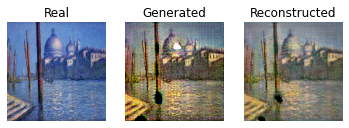

[INFO] Domain B to Domain A


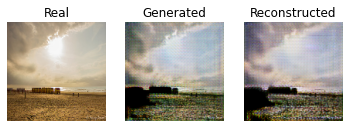

epoch: 50 step: 1 dA_loss: 0.074 dB_loss: 0.144 gAB_loss :4.054 gBA_loss: 3.527
[INFO] Domain A to Domain B


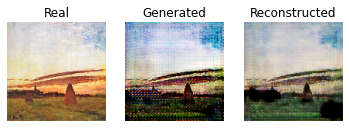

[INFO] Domain B to Domain A


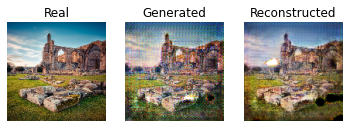

epoch: 50 step: 2 dA_loss: 0.068 dB_loss: 0.174 gAB_loss :3.270 gBA_loss: 3.943
[INFO] Domain A to Domain B


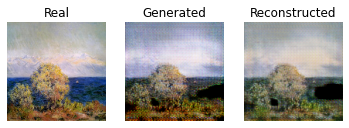

[INFO] Domain B to Domain A


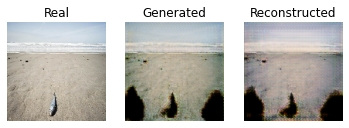

epoch: 50 step: 3 dA_loss: 0.065 dB_loss: 0.262 gAB_loss :4.580 gBA_loss: 3.785
[INFO] Domain A to Domain B


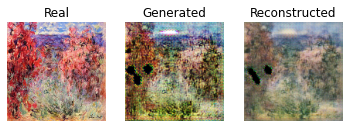

[INFO] Domain B to Domain A


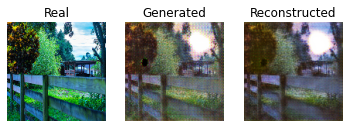

epoch: 50 step: 4 dA_loss: 0.084 dB_loss: 0.190 gAB_loss :3.649 gBA_loss: 3.985
[INFO] Domain A to Domain B


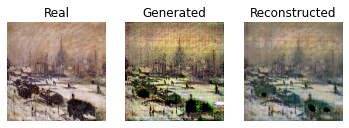

[INFO] Domain B to Domain A


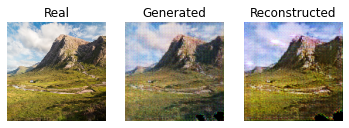

epoch: 50 step: 5 dA_loss: 0.044 dB_loss: 0.123 gAB_loss :4.329 gBA_loss: 4.302
[INFO] Domain A to Domain B


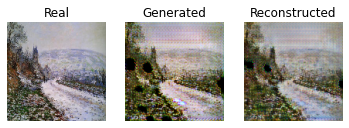

[INFO] Domain B to Domain A


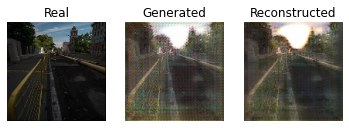

epoch: 50 step: 6 dA_loss: 0.084 dB_loss: 0.148 gAB_loss :4.084 gBA_loss: 3.806
[INFO] Domain A to Domain B


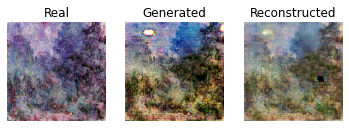

[INFO] Domain B to Domain A


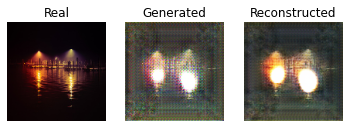

epoch: 50 step: 7 dA_loss: 0.101 dB_loss: 0.099 gAB_loss :3.855 gBA_loss: 3.950
[INFO] Domain A to Domain B


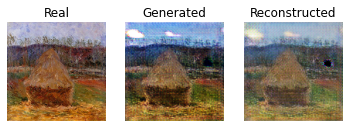

[INFO] Domain B to Domain A


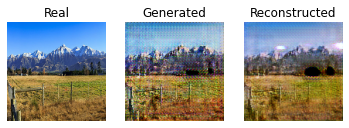

epoch: 50 step: 8 dA_loss: 0.086 dB_loss: 0.070 gAB_loss :4.010 gBA_loss: 4.601
[INFO] Domain A to Domain B


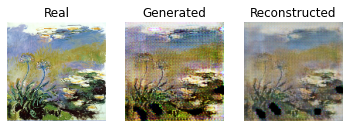

[INFO] Domain B to Domain A


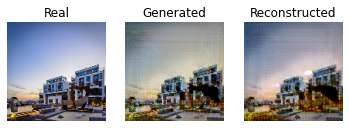

epoch: 50 step: 9 dA_loss: 0.090 dB_loss: 0.149 gAB_loss :4.576 gBA_loss: 4.388
[INFO] Domain A to Domain B


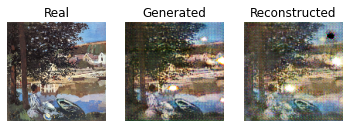

[INFO] Domain B to Domain A


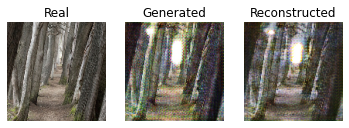

epoch: 50 step: 10 dA_loss: 0.132 dB_loss: 0.074 gAB_loss :4.150 gBA_loss: 3.481
[INFO] Domain A to Domain B


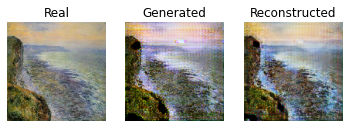

[INFO] Domain B to Domain A


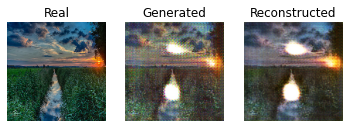

epoch: 50 step: 11 dA_loss: 0.077 dB_loss: 0.185 gAB_loss :3.581 gBA_loss: 3.462
[INFO] Domain A to Domain B


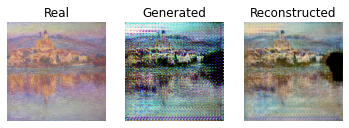

[INFO] Domain B to Domain A


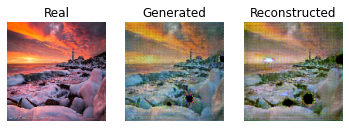

epoch: 50 step: 12 dA_loss: 0.116 dB_loss: 0.159 gAB_loss :3.821 gBA_loss: 4.358
[INFO] Domain A to Domain B


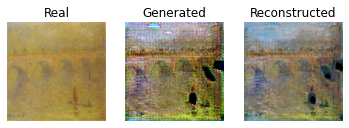

[INFO] Domain B to Domain A


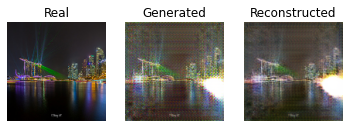

epoch: 50 step: 13 dA_loss: 0.080 dB_loss: 0.083 gAB_loss :4.064 gBA_loss: 4.059
[INFO] Domain A to Domain B


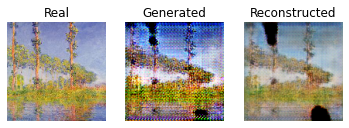

[INFO] Domain B to Domain A


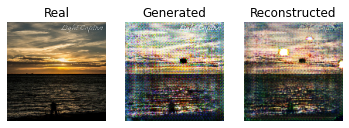

epoch: 50 step: 14 dA_loss: 0.112 dB_loss: 0.128 gAB_loss :4.750 gBA_loss: 4.120
[INFO] Domain A to Domain B


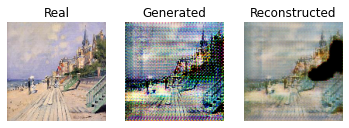

[INFO] Domain B to Domain A


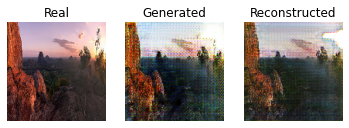

epoch: 50 step: 15 dA_loss: 0.091 dB_loss: 0.125 gAB_loss :4.029 gBA_loss: 3.724
[INFO] Domain A to Domain B


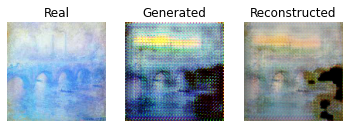

[INFO] Domain B to Domain A


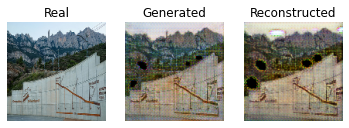

epoch: 50 step: 16 dA_loss: 0.138 dB_loss: 0.191 gAB_loss :3.526 gBA_loss: 4.076
[INFO] Domain A to Domain B


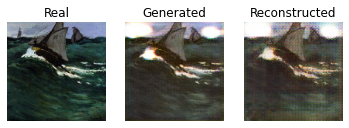

[INFO] Domain B to Domain A


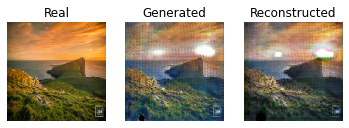

epoch: 50 step: 17 dA_loss: 0.099 dB_loss: 0.158 gAB_loss :4.506 gBA_loss: 3.648
[INFO] Domain A to Domain B


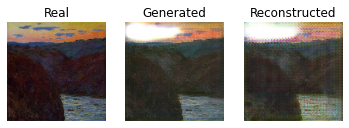

[INFO] Domain B to Domain A


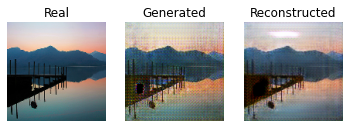

epoch: 50 step: 18 dA_loss: 0.084 dB_loss: 0.149 gAB_loss :3.731 gBA_loss: 3.581
[INFO] Domain A to Domain B


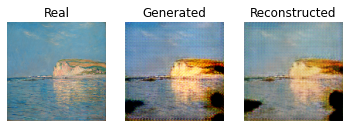

[INFO] Domain B to Domain A


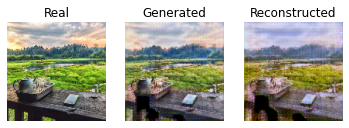

epoch: 50 step: 19 dA_loss: 0.075 dB_loss: 0.091 gAB_loss :3.650 gBA_loss: 3.928
[INFO] Domain A to Domain B


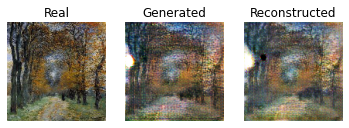

[INFO] Domain B to Domain A


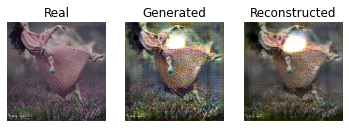

epoch: 50 step: 20 dA_loss: 0.061 dB_loss: 0.144 gAB_loss :4.402 gBA_loss: 3.987
[INFO] Domain A to Domain B


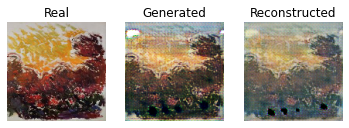

[INFO] Domain B to Domain A


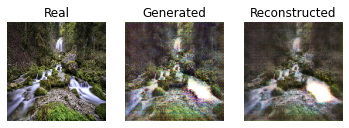

epoch: 50 step: 21 dA_loss: 0.080 dB_loss: 0.144 gAB_loss :3.915 gBA_loss: 3.856
[INFO] Domain A to Domain B


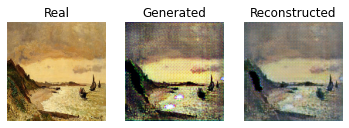

[INFO] Domain B to Domain A


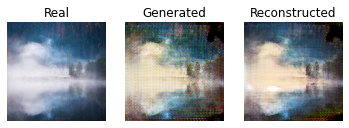

epoch: 50 step: 22 dA_loss: 0.084 dB_loss: 0.119 gAB_loss :3.876 gBA_loss: 3.449
[INFO] Domain A to Domain B


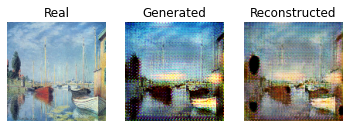

[INFO] Domain B to Domain A


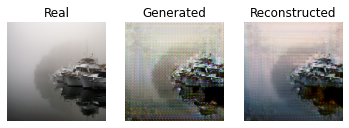

epoch: 50 step: 23 dA_loss: 0.090 dB_loss: 0.145 gAB_loss :4.695 gBA_loss: 4.265
[INFO] Domain A to Domain B


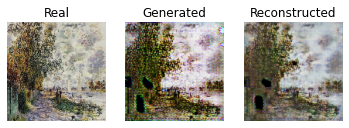

[INFO] Domain B to Domain A


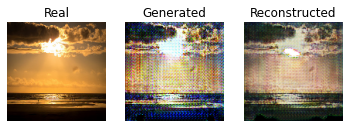

epoch: 50 step: 24 dA_loss: 0.066 dB_loss: 0.211 gAB_loss :4.075 gBA_loss: 4.873
[INFO] Domain A to Domain B


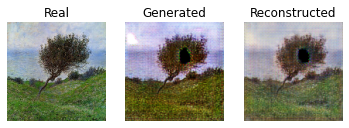

[INFO] Domain B to Domain A


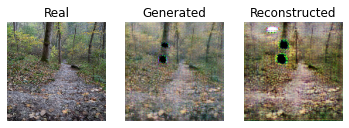

epoch: 50 step: 25 dA_loss: 0.085 dB_loss: 0.198 gAB_loss :3.957 gBA_loss: 3.692
[INFO] Domain A to Domain B


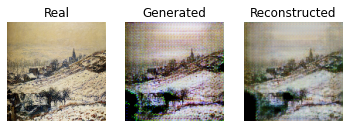

[INFO] Domain B to Domain A


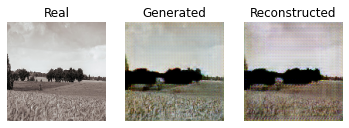

epoch: 50 step: 26 dA_loss: 0.080 dB_loss: 0.139 gAB_loss :4.195 gBA_loss: 3.487
[INFO] Domain A to Domain B


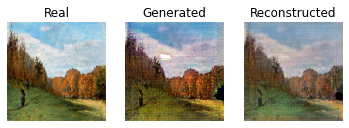

[INFO] Domain B to Domain A


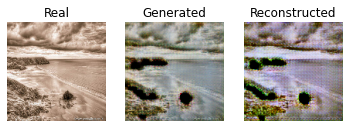

epoch: 50 step: 27 dA_loss: 0.148 dB_loss: 0.113 gAB_loss :4.023 gBA_loss: 4.640
[INFO] Domain A to Domain B


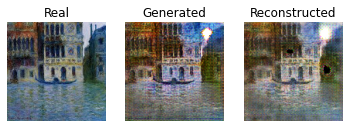

[INFO] Domain B to Domain A


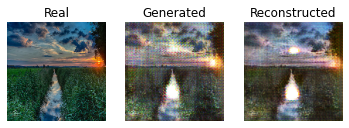

epoch: 50 step: 28 dA_loss: 0.079 dB_loss: 0.111 gAB_loss :3.509 gBA_loss: 3.693
[INFO] Domain A to Domain B


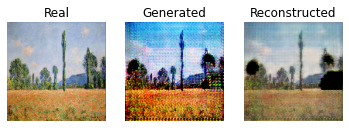

[INFO] Domain B to Domain A


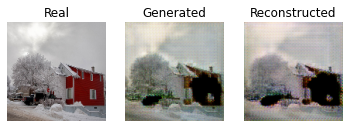

epoch: 50 step: 29 dA_loss: 0.082 dB_loss: 0.116 gAB_loss :3.944 gBA_loss: 3.650
[INFO] Domain A to Domain B


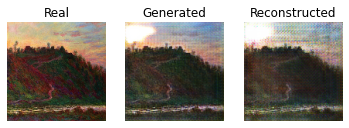

[INFO] Domain B to Domain A


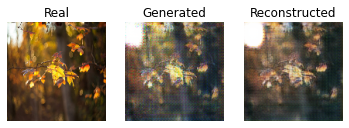

epoch: 50 step: 30 dA_loss: 0.051 dB_loss: 0.088 gAB_loss :4.253 gBA_loss: 3.962
[INFO] Domain A to Domain B


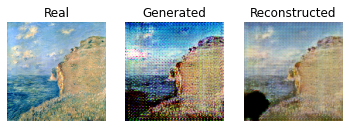

[INFO] Domain B to Domain A


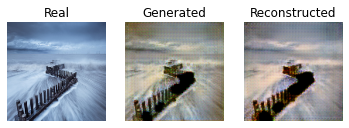

epoch: 50 step: 31 dA_loss: 0.062 dB_loss: 0.074 gAB_loss :3.771 gBA_loss: 4.003
[INFO] Domain A to Domain B


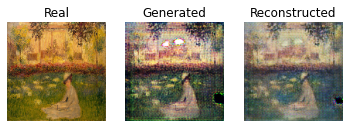

[INFO] Domain B to Domain A


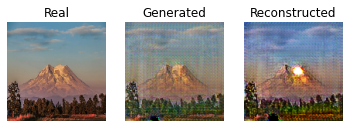

epoch: 50 step: 32 dA_loss: 0.068 dB_loss: 0.099 gAB_loss :4.152 gBA_loss: 4.117
[INFO] Domain A to Domain B


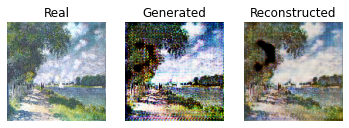

[INFO] Domain B to Domain A


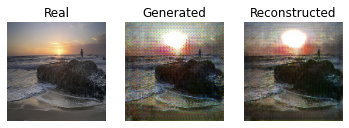

epoch: 50 step: 33 dA_loss: 0.043 dB_loss: 0.104 gAB_loss :4.584 gBA_loss: 3.934
[INFO] Domain A to Domain B


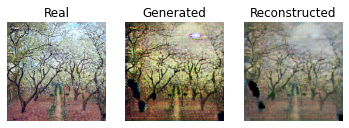

[INFO] Domain B to Domain A


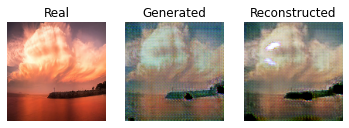

epoch: 50 step: 34 dA_loss: 0.044 dB_loss: 0.119 gAB_loss :3.718 gBA_loss: 3.891
[INFO] Domain A to Domain B


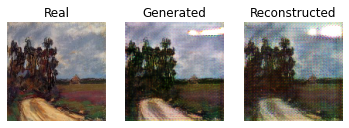

[INFO] Domain B to Domain A


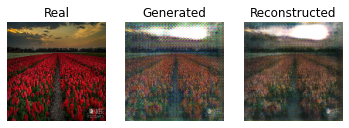

epoch: 50 step: 35 dA_loss: 0.078 dB_loss: 0.081 gAB_loss :3.889 gBA_loss: 3.601
[INFO] Domain A to Domain B


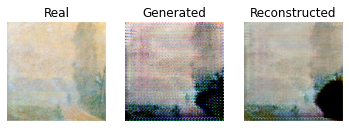

[INFO] Domain B to Domain A


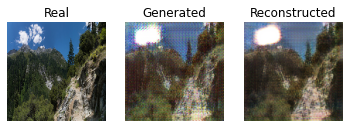

epoch: 50 step: 36 dA_loss: 0.048 dB_loss: 0.091 gAB_loss :4.404 gBA_loss: 3.737
[INFO] Domain A to Domain B


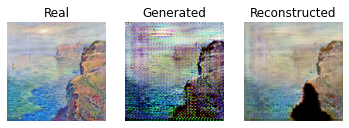

[INFO] Domain B to Domain A


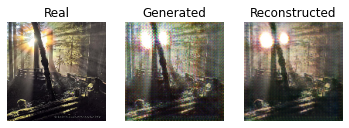

epoch: 50 step: 37 dA_loss: 0.142 dB_loss: 0.135 gAB_loss :3.901 gBA_loss: 4.384
[INFO] Domain A to Domain B


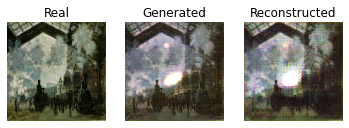

[INFO] Domain B to Domain A


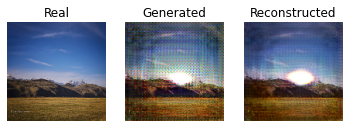

epoch: 50 step: 38 dA_loss: 0.105 dB_loss: 0.134 gAB_loss :3.749 gBA_loss: 3.669
[INFO] Domain A to Domain B


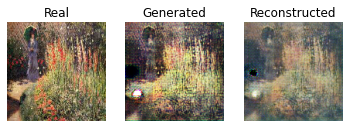

[INFO] Domain B to Domain A


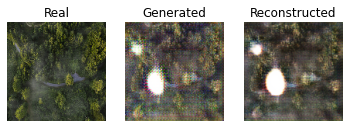

epoch: 50 step: 39 dA_loss: 0.112 dB_loss: 0.122 gAB_loss :4.029 gBA_loss: 3.686
[INFO] Domain A to Domain B


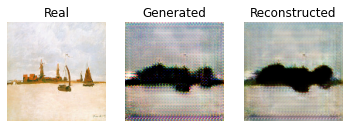

[INFO] Domain B to Domain A


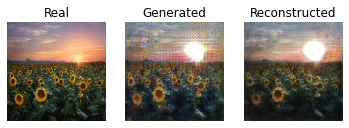

epoch: 50 step: 40 dA_loss: 0.096 dB_loss: 0.197 gAB_loss :4.313 gBA_loss: 4.033
[INFO] Domain A to Domain B


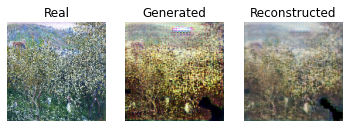

[INFO] Domain B to Domain A


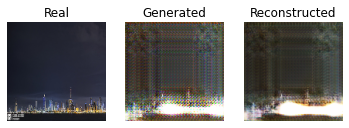

epoch: 50 step: 41 dA_loss: 0.072 dB_loss: 0.141 gAB_loss :4.076 gBA_loss: 4.005
[INFO] Domain A to Domain B


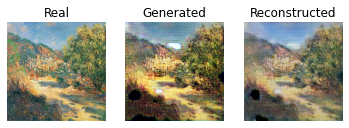

[INFO] Domain B to Domain A


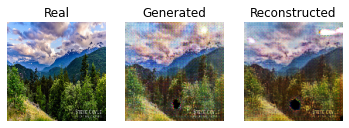

epoch: 50 step: 42 dA_loss: 0.055 dB_loss: 0.122 gAB_loss :3.641 gBA_loss: 3.577
[INFO] Domain A to Domain B


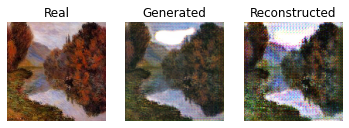

[INFO] Domain B to Domain A


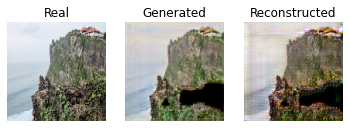

epoch: 50 step: 43 dA_loss: 0.055 dB_loss: 0.088 gAB_loss :4.518 gBA_loss: 4.331
[INFO] Domain A to Domain B


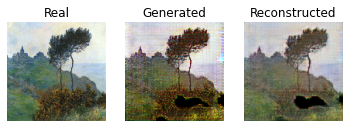

[INFO] Domain B to Domain A


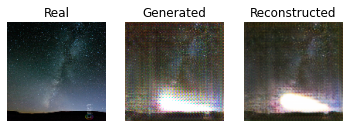

epoch: 50 step: 44 dA_loss: 0.059 dB_loss: 0.093 gAB_loss :4.243 gBA_loss: 3.879
[INFO] Domain A to Domain B


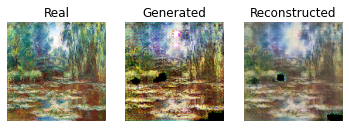

[INFO] Domain B to Domain A


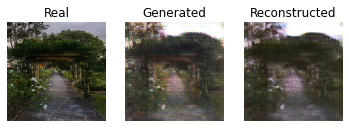

epoch: 50 step: 45 dA_loss: 0.053 dB_loss: 0.116 gAB_loss :4.177 gBA_loss: 3.968
[INFO] Domain A to Domain B


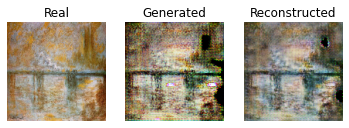

[INFO] Domain B to Domain A


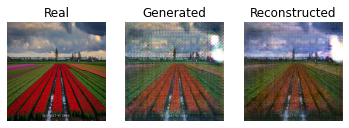

epoch: 50 step: 46 dA_loss: 0.053 dB_loss: 0.134 gAB_loss :3.977 gBA_loss: 4.094
[INFO] Domain A to Domain B


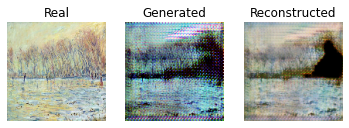

[INFO] Domain B to Domain A


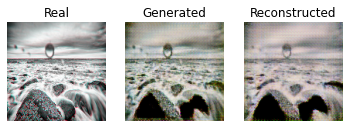

epoch: 50 step: 47 dA_loss: 0.044 dB_loss: 0.105 gAB_loss :3.868 gBA_loss: 3.618
[INFO] Domain A to Domain B


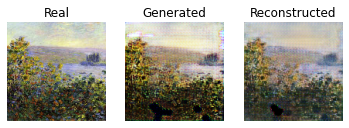

[INFO] Domain B to Domain A


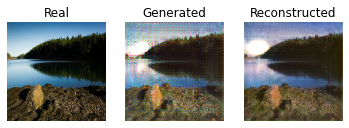

epoch: 50 step: 48 dA_loss: 0.051 dB_loss: 0.059 gAB_loss :4.220 gBA_loss: 3.702
[INFO] Domain A to Domain B


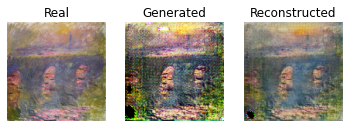

[INFO] Domain B to Domain A


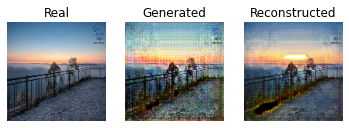

epoch: 50 step: 49 dA_loss: 0.073 dB_loss: 0.089 gAB_loss :4.493 gBA_loss: 4.190
[INFO] Domain A to Domain B


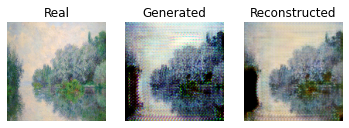

[INFO] Domain B to Domain A


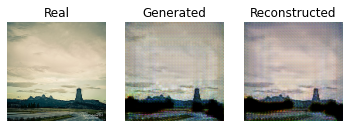

epoch: 50 step: 50 dA_loss: 0.118 dB_loss: 0.169 gAB_loss :3.654 gBA_loss: 4.824
[INFO] Domain A to Domain B


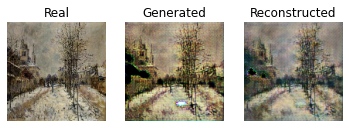

[INFO] Domain B to Domain A


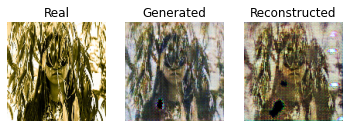

epoch: 50 step: 51 dA_loss: 0.140 dB_loss: 0.144 gAB_loss :4.349 gBA_loss: 3.538
[INFO] Domain A to Domain B


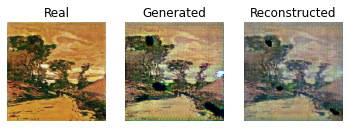

[INFO] Domain B to Domain A


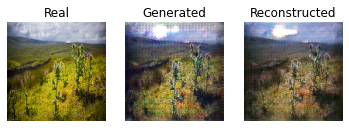

epoch: 50 step: 52 dA_loss: 0.091 dB_loss: 0.114 gAB_loss :4.089 gBA_loss: 3.660
[INFO] Domain A to Domain B


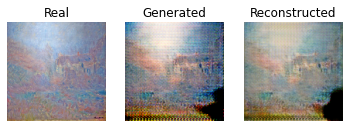

[INFO] Domain B to Domain A


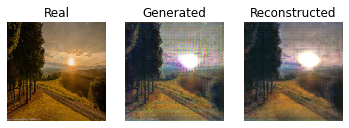

epoch: 50 step: 53 dA_loss: 0.080 dB_loss: 0.120 gAB_loss :3.324 gBA_loss: 3.722
[INFO] Domain A to Domain B


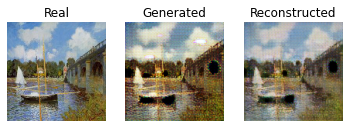

[INFO] Domain B to Domain A


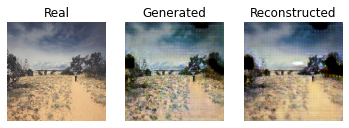

epoch: 50 step: 54 dA_loss: 0.050 dB_loss: 0.139 gAB_loss :3.911 gBA_loss: 3.813
[INFO] Domain A to Domain B


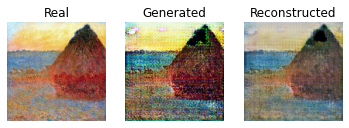

[INFO] Domain B to Domain A


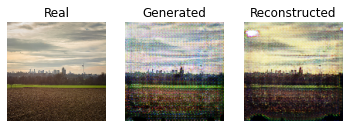

epoch: 50 step: 55 dA_loss: 0.069 dB_loss: 0.109 gAB_loss :4.308 gBA_loss: 3.939
[INFO] Domain A to Domain B


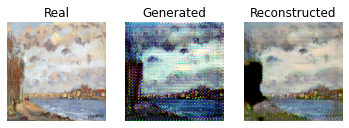

[INFO] Domain B to Domain A


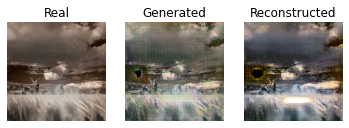

epoch: 50 step: 56 dA_loss: 0.046 dB_loss: 0.131 gAB_loss :4.738 gBA_loss: 4.021
[INFO] Domain A to Domain B


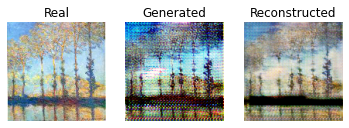

[INFO] Domain B to Domain A


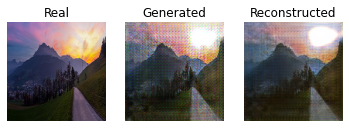

epoch: 50 step: 57 dA_loss: 0.037 dB_loss: 0.269 gAB_loss :3.458 gBA_loss: 3.770
[INFO] Domain A to Domain B


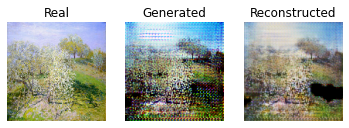

[INFO] Domain B to Domain A


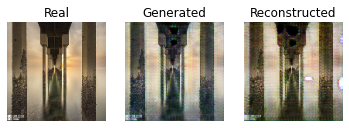

epoch: 50 step: 58 dA_loss: 0.041 dB_loss: 0.200 gAB_loss :4.339 gBA_loss: 3.973
[INFO] Domain A to Domain B


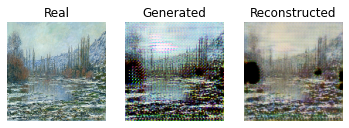

[INFO] Domain B to Domain A


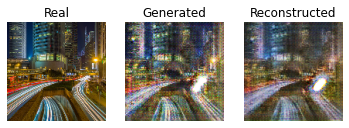

epoch: 50 step: 59 dA_loss: 0.035 dB_loss: 0.094 gAB_loss :3.776 gBA_loss: 3.800
[INFO] Domain A to Domain B


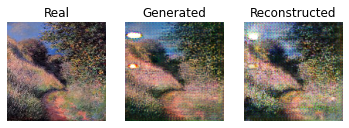

[INFO] Domain B to Domain A


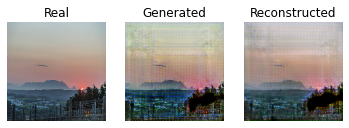

epoch: 50 step: 60 dA_loss: 0.060 dB_loss: 0.072 gAB_loss :3.801 gBA_loss: 4.069
[INFO] Domain A to Domain B


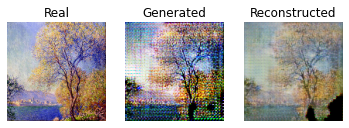

[INFO] Domain B to Domain A


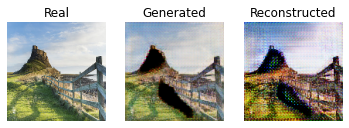

epoch: 50 step: 61 dA_loss: 0.121 dB_loss: 0.079 gAB_loss :4.123 gBA_loss: 3.423
[INFO] Domain A to Domain B


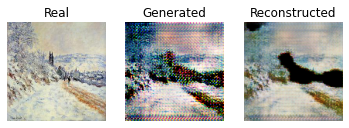

[INFO] Domain B to Domain A


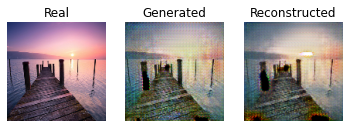

epoch: 50 step: 62 dA_loss: 0.170 dB_loss: 0.095 gAB_loss :3.942 gBA_loss: 3.728
[INFO] Domain A to Domain B


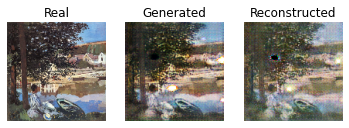

[INFO] Domain B to Domain A


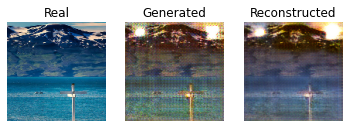

epoch: 50 step: 63 dA_loss: 0.084 dB_loss: 0.136 gAB_loss :3.689 gBA_loss: 4.340
[INFO] Domain A to Domain B


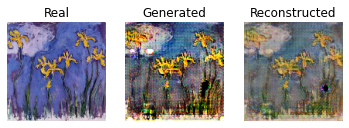

[INFO] Domain B to Domain A


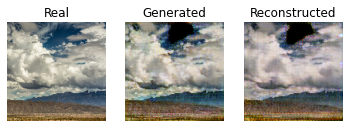

epoch: 50 step: 64 dA_loss: 0.154 dB_loss: 0.118 gAB_loss :3.953 gBA_loss: 3.479
[INFO] Domain A to Domain B


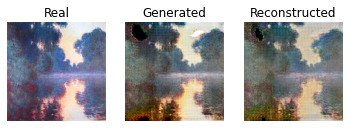

[INFO] Domain B to Domain A


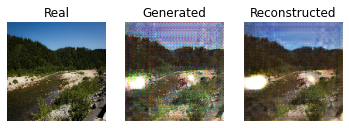

epoch: 50 step: 65 dA_loss: 0.082 dB_loss: 0.121 gAB_loss :4.486 gBA_loss: 3.834
[INFO] Domain A to Domain B


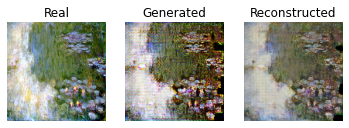

[INFO] Domain B to Domain A


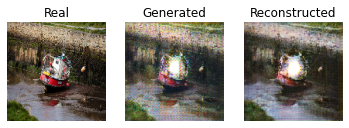

epoch: 50 step: 66 dA_loss: 0.049 dB_loss: 0.155 gAB_loss :3.734 gBA_loss: 3.489
[INFO] Domain A to Domain B


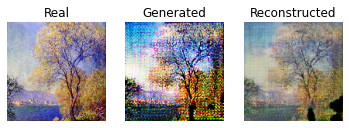

[INFO] Domain B to Domain A


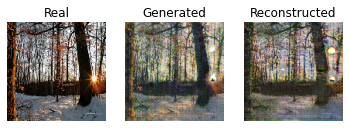

epoch: 50 step: 67 dA_loss: 0.050 dB_loss: 0.064 gAB_loss :3.818 gBA_loss: 4.279
[INFO] Domain A to Domain B


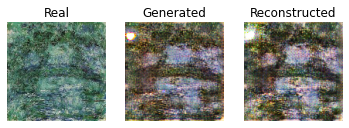

[INFO] Domain B to Domain A


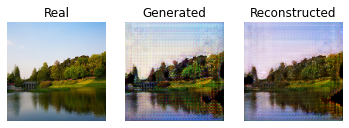

epoch: 50 step: 68 dA_loss: 0.067 dB_loss: 0.172 gAB_loss :3.935 gBA_loss: 4.105
[INFO] Domain A to Domain B


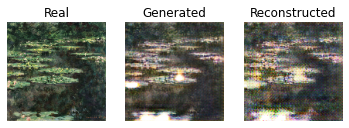

[INFO] Domain B to Domain A


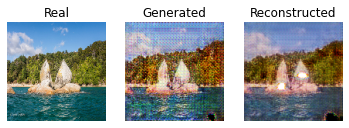

epoch: 50 step: 69 dA_loss: 0.158 dB_loss: 0.185 gAB_loss :4.169 gBA_loss: 3.991
[INFO] Domain A to Domain B


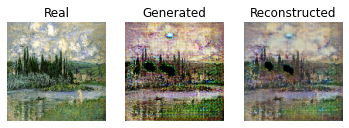

[INFO] Domain B to Domain A


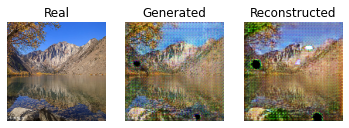

epoch: 50 step: 70 dA_loss: 0.061 dB_loss: 0.120 gAB_loss :4.185 gBA_loss: 4.072
[INFO] Domain A to Domain B


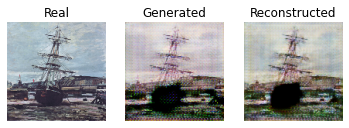

[INFO] Domain B to Domain A


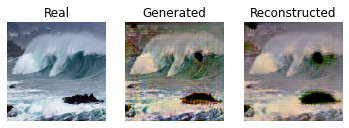

epoch: 50 step: 71 dA_loss: 0.134 dB_loss: 0.192 gAB_loss :5.038 gBA_loss: 4.368
[INFO] Domain A to Domain B


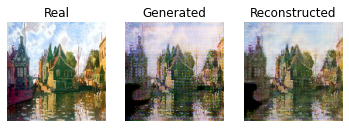

[INFO] Domain B to Domain A


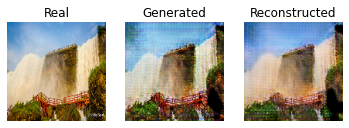

epoch: 50 step: 72 dA_loss: 0.072 dB_loss: 0.289 gAB_loss :3.496 gBA_loss: 4.370
[INFO] Domain A to Domain B


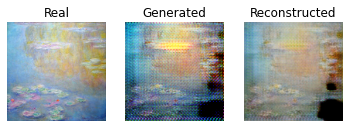

[INFO] Domain B to Domain A


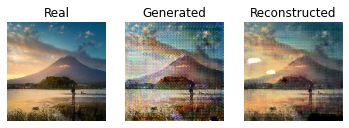

epoch: 50 step: 73 dA_loss: 0.043 dB_loss: 0.203 gAB_loss :4.291 gBA_loss: 3.855
[INFO] Domain A to Domain B


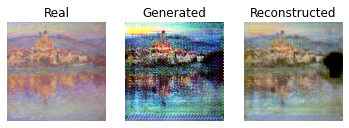

[INFO] Domain B to Domain A


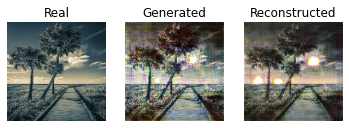

 51%|█████     | 51/100 [1:24:50<1:27:04, 106.63s/it]

epoch: 51 step: 0 dA_loss: 0.055 dB_loss: 0.086 gAB_loss :4.384 gBA_loss: 4.003
epoch: 51 step: 1 dA_loss: 0.082 dB_loss: 0.147 gAB_loss :3.540 gBA_loss: 3.523
epoch: 51 step: 2 dA_loss: 0.073 dB_loss: 0.132 gAB_loss :3.956 gBA_loss: 4.024
epoch: 51 step: 3 dA_loss: 0.059 dB_loss: 0.124 gAB_loss :3.784 gBA_loss: 3.995
epoch: 51 step: 4 dA_loss: 0.075 dB_loss: 0.164 gAB_loss :4.305 gBA_loss: 3.828
epoch: 51 step: 5 dA_loss: 0.047 dB_loss: 0.184 gAB_loss :4.099 gBA_loss: 4.519
epoch: 51 step: 6 dA_loss: 0.053 dB_loss: 0.142 gAB_loss :4.144 gBA_loss: 3.931
epoch: 51 step: 7 dA_loss: 0.092 dB_loss: 0.109 gAB_loss :4.257 gBA_loss: 3.732
epoch: 51 step: 8 dA_loss: 0.097 dB_loss: 0.172 gAB_loss :3.873 gBA_loss: 4.519
epoch: 51 step: 9 dA_loss: 0.093 dB_loss: 0.130 gAB_loss :4.460 gBA_loss: 4.749
epoch: 51 step: 10 dA_loss: 0.218 dB_loss: 0.087 gAB_loss :4.678 gBA_loss: 3.629
epoch: 51 step: 11 dA_loss: 0.072 dB_loss: 0.287 gAB_loss :3.479 gBA_loss: 3.374
epoch: 51 step: 12 dA_loss: 0.198 dB_l

 52%|█████▏    | 52/100 [1:26:28<1:23:14, 104.04s/it]

epoch: 51 step: 73 dA_loss: 0.053 dB_loss: 0.187 gAB_loss :3.364 gBA_loss: 3.815
epoch: 52 step: 0 dA_loss: 0.055 dB_loss: 0.282 gAB_loss :4.782 gBA_loss: 3.557
epoch: 52 step: 1 dA_loss: 0.103 dB_loss: 0.177 gAB_loss :3.814 gBA_loss: 3.996
epoch: 52 step: 2 dA_loss: 0.079 dB_loss: 0.181 gAB_loss :3.603 gBA_loss: 3.527
epoch: 52 step: 3 dA_loss: 0.093 dB_loss: 0.109 gAB_loss :4.150 gBA_loss: 4.106
epoch: 52 step: 4 dA_loss: 0.063 dB_loss: 0.093 gAB_loss :3.931 gBA_loss: 3.948
epoch: 52 step: 5 dA_loss: 0.046 dB_loss: 0.109 gAB_loss :4.523 gBA_loss: 4.471
epoch: 52 step: 6 dA_loss: 0.045 dB_loss: 0.113 gAB_loss :3.837 gBA_loss: 4.195
epoch: 52 step: 7 dA_loss: 0.099 dB_loss: 0.112 gAB_loss :4.271 gBA_loss: 3.892
epoch: 52 step: 8 dA_loss: 0.075 dB_loss: 0.104 gAB_loss :4.285 gBA_loss: 4.667
epoch: 52 step: 9 dA_loss: 0.079 dB_loss: 0.079 gAB_loss :4.181 gBA_loss: 4.607
epoch: 52 step: 10 dA_loss: 0.117 dB_loss: 0.099 gAB_loss :4.624 gBA_loss: 4.000
epoch: 52 step: 11 dA_loss: 0.094 dB_l

 53%|█████▎    | 53/100 [1:28:06<1:20:04, 102.23s/it]

epoch: 52 step: 73 dA_loss: 0.101 dB_loss: 0.116 gAB_loss :3.742 gBA_loss: 3.890
epoch: 53 step: 0 dA_loss: 0.100 dB_loss: 0.235 gAB_loss :4.676 gBA_loss: 3.913
epoch: 53 step: 1 dA_loss: 0.107 dB_loss: 0.152 gAB_loss :4.058 gBA_loss: 3.988
epoch: 53 step: 2 dA_loss: 0.069 dB_loss: 0.127 gAB_loss :3.574 gBA_loss: 4.057
epoch: 53 step: 3 dA_loss: 0.094 dB_loss: 0.117 gAB_loss :4.276 gBA_loss: 3.805
epoch: 53 step: 4 dA_loss: 0.128 dB_loss: 0.147 gAB_loss :4.149 gBA_loss: 4.244
epoch: 53 step: 5 dA_loss: 0.069 dB_loss: 0.113 gAB_loss :4.727 gBA_loss: 4.924
epoch: 53 step: 6 dA_loss: 0.098 dB_loss: 0.142 gAB_loss :4.281 gBA_loss: 3.788
epoch: 53 step: 7 dA_loss: 0.138 dB_loss: 0.095 gAB_loss :4.199 gBA_loss: 4.576
epoch: 53 step: 8 dA_loss: 0.064 dB_loss: 0.065 gAB_loss :4.231 gBA_loss: 4.311
epoch: 53 step: 9 dA_loss: 0.168 dB_loss: 0.073 gAB_loss :4.678 gBA_loss: 4.664
epoch: 53 step: 10 dA_loss: 0.174 dB_loss: 0.109 gAB_loss :4.500 gBA_loss: 3.878
epoch: 53 step: 11 dA_loss: 0.117 dB_l

 54%|█████▍    | 54/100 [1:29:44<1:17:25, 100.98s/it]

epoch: 53 step: 73 dA_loss: 0.068 dB_loss: 0.077 gAB_loss :4.069 gBA_loss: 4.617
epoch: 54 step: 0 dA_loss: 0.151 dB_loss: 0.114 gAB_loss :4.442 gBA_loss: 3.286
epoch: 54 step: 1 dA_loss: 0.325 dB_loss: 0.105 gAB_loss :4.221 gBA_loss: 5.158
epoch: 54 step: 2 dA_loss: 0.386 dB_loss: 0.108 gAB_loss :3.511 gBA_loss: 3.449
epoch: 54 step: 3 dA_loss: 0.292 dB_loss: 0.187 gAB_loss :4.276 gBA_loss: 4.202
epoch: 54 step: 4 dA_loss: 0.151 dB_loss: 0.185 gAB_loss :4.036 gBA_loss: 3.785
epoch: 54 step: 5 dA_loss: 0.144 dB_loss: 0.095 gAB_loss :4.258 gBA_loss: 4.181
epoch: 54 step: 6 dA_loss: 0.102 dB_loss: 0.139 gAB_loss :3.865 gBA_loss: 4.105
epoch: 54 step: 7 dA_loss: 0.098 dB_loss: 0.110 gAB_loss :4.026 gBA_loss: 3.780
epoch: 54 step: 8 dA_loss: 0.087 dB_loss: 0.070 gAB_loss :4.415 gBA_loss: 4.465
epoch: 54 step: 9 dA_loss: 0.115 dB_loss: 0.084 gAB_loss :4.243 gBA_loss: 4.409
epoch: 54 step: 10 dA_loss: 0.136 dB_loss: 0.079 gAB_loss :4.401 gBA_loss: 3.974
epoch: 54 step: 11 dA_loss: 0.106 dB_l

 55%|█████▌    | 55/100 [1:31:22<1:15:05, 100.13s/it]

epoch: 54 step: 73 dA_loss: 0.086 dB_loss: 0.087 gAB_loss :3.970 gBA_loss: 4.157
epoch: 55 step: 0 dA_loss: 0.076 dB_loss: 0.087 gAB_loss :4.215 gBA_loss: 3.601
epoch: 55 step: 1 dA_loss: 0.115 dB_loss: 0.150 gAB_loss :4.643 gBA_loss: 3.919
epoch: 55 step: 2 dA_loss: 0.158 dB_loss: 0.225 gAB_loss :3.281 gBA_loss: 4.290
epoch: 55 step: 3 dA_loss: 0.218 dB_loss: 0.224 gAB_loss :4.454 gBA_loss: 3.746
epoch: 55 step: 4 dA_loss: 0.238 dB_loss: 0.140 gAB_loss :3.809 gBA_loss: 4.546
epoch: 55 step: 5 dA_loss: 0.124 dB_loss: 0.121 gAB_loss :4.557 gBA_loss: 4.282
epoch: 55 step: 6 dA_loss: 0.127 dB_loss: 0.220 gAB_loss :4.085 gBA_loss: 3.908
epoch: 55 step: 7 dA_loss: 0.115 dB_loss: 0.094 gAB_loss :3.914 gBA_loss: 4.194
epoch: 55 step: 8 dA_loss: 0.058 dB_loss: 0.068 gAB_loss :4.487 gBA_loss: 4.633
epoch: 55 step: 9 dA_loss: 0.134 dB_loss: 0.135 gAB_loss :5.004 gBA_loss: 4.717
epoch: 55 step: 10 dA_loss: 0.072 dB_loss: 0.087 gAB_loss :4.715 gBA_loss: 4.768
epoch: 55 step: 11 dA_loss: 0.127 dB_l

 56%|█████▌    | 56/100 [1:33:01<1:13:00, 99.56s/it] 

epoch: 55 step: 73 dA_loss: 0.113 dB_loss: 0.098 gAB_loss :3.879 gBA_loss: 4.141
epoch: 56 step: 0 dA_loss: 0.071 dB_loss: 0.061 gAB_loss :3.951 gBA_loss: 3.668
epoch: 56 step: 1 dA_loss: 0.111 dB_loss: 0.173 gAB_loss :4.588 gBA_loss: 3.925
epoch: 56 step: 2 dA_loss: 0.133 dB_loss: 0.180 gAB_loss :3.765 gBA_loss: 4.309
epoch: 56 step: 3 dA_loss: 0.093 dB_loss: 0.094 gAB_loss :3.739 gBA_loss: 3.917
epoch: 56 step: 4 dA_loss: 0.090 dB_loss: 0.202 gAB_loss :5.084 gBA_loss: 4.046
epoch: 56 step: 5 dA_loss: 0.061 dB_loss: 0.327 gAB_loss :3.816 gBA_loss: 4.622
epoch: 56 step: 6 dA_loss: 0.090 dB_loss: 0.237 gAB_loss :4.283 gBA_loss: 3.821
epoch: 56 step: 7 dA_loss: 0.100 dB_loss: 0.158 gAB_loss :4.070 gBA_loss: 3.908
epoch: 56 step: 8 dA_loss: 0.053 dB_loss: 0.172 gAB_loss :3.829 gBA_loss: 4.371
epoch: 56 step: 9 dA_loss: 0.086 dB_loss: 0.133 gAB_loss :4.311 gBA_loss: 4.156
epoch: 56 step: 10 dA_loss: 0.082 dB_loss: 0.073 gAB_loss :4.233 gBA_loss: 3.705
epoch: 56 step: 11 dA_loss: 0.050 dB_l

 57%|█████▋    | 57/100 [1:34:39<1:11:02, 99.14s/it]

epoch: 56 step: 73 dA_loss: 0.098 dB_loss: 0.078 gAB_loss :4.155 gBA_loss: 4.295
epoch: 57 step: 0 dA_loss: 0.087 dB_loss: 0.091 gAB_loss :3.801 gBA_loss: 3.550
epoch: 57 step: 1 dA_loss: 0.099 dB_loss: 0.199 gAB_loss :4.408 gBA_loss: 3.702
epoch: 57 step: 2 dA_loss: 0.122 dB_loss: 0.122 gAB_loss :3.938 gBA_loss: 4.120
epoch: 57 step: 3 dA_loss: 0.082 dB_loss: 0.138 gAB_loss :3.480 gBA_loss: 3.734
epoch: 57 step: 4 dA_loss: 0.078 dB_loss: 0.219 gAB_loss :4.453 gBA_loss: 3.739
epoch: 57 step: 5 dA_loss: 0.095 dB_loss: 0.125 gAB_loss :4.115 gBA_loss: 4.633
epoch: 57 step: 6 dA_loss: 0.070 dB_loss: 0.156 gAB_loss :4.161 gBA_loss: 4.077
epoch: 57 step: 7 dA_loss: 0.084 dB_loss: 0.113 gAB_loss :4.216 gBA_loss: 3.635
epoch: 57 step: 8 dA_loss: 0.139 dB_loss: 0.090 gAB_loss :4.011 gBA_loss: 4.453
epoch: 57 step: 9 dA_loss: 0.075 dB_loss: 0.092 gAB_loss :4.050 gBA_loss: 4.080
epoch: 57 step: 10 dA_loss: 0.079 dB_loss: 0.090 gAB_loss :4.359 gBA_loss: 3.825
epoch: 57 step: 11 dA_loss: 0.089 dB_l

 58%|█████▊    | 58/100 [1:36:17<1:09:12, 98.86s/it]

epoch: 57 step: 73 dA_loss: 0.083 dB_loss: 0.124 gAB_loss :4.558 gBA_loss: 4.396
epoch: 58 step: 0 dA_loss: 0.075 dB_loss: 0.132 gAB_loss :3.792 gBA_loss: 3.898
epoch: 58 step: 1 dA_loss: 0.115 dB_loss: 0.217 gAB_loss :4.192 gBA_loss: 3.688
epoch: 58 step: 2 dA_loss: 0.126 dB_loss: 0.059 gAB_loss :4.078 gBA_loss: 4.329
epoch: 58 step: 3 dA_loss: 0.060 dB_loss: 0.129 gAB_loss :3.732 gBA_loss: 4.048
epoch: 58 step: 4 dA_loss: 0.077 dB_loss: 0.156 gAB_loss :4.106 gBA_loss: 3.702
epoch: 58 step: 5 dA_loss: 0.085 dB_loss: 0.091 gAB_loss :4.388 gBA_loss: 4.571
epoch: 58 step: 6 dA_loss: 0.055 dB_loss: 0.087 gAB_loss :3.886 gBA_loss: 4.428
epoch: 58 step: 7 dA_loss: 0.122 dB_loss: 0.093 gAB_loss :4.047 gBA_loss: 3.803
epoch: 58 step: 8 dA_loss: 0.115 dB_loss: 0.062 gAB_loss :4.294 gBA_loss: 4.734
epoch: 58 step: 9 dA_loss: 0.073 dB_loss: 0.062 gAB_loss :4.267 gBA_loss: 4.137
epoch: 58 step: 10 dA_loss: 0.069 dB_loss: 0.068 gAB_loss :4.222 gBA_loss: 4.093
epoch: 58 step: 11 dA_loss: 0.106 dB_l

 59%|█████▉    | 59/100 [1:37:55<1:07:24, 98.64s/it]

epoch: 58 step: 73 dA_loss: 0.059 dB_loss: 0.059 gAB_loss :4.078 gBA_loss: 4.037
epoch: 59 step: 0 dA_loss: 0.056 dB_loss: 0.038 gAB_loss :4.263 gBA_loss: 3.809
epoch: 59 step: 1 dA_loss: 0.128 dB_loss: 0.051 gAB_loss :3.706 gBA_loss: 3.600
epoch: 59 step: 2 dA_loss: 0.105 dB_loss: 0.095 gAB_loss :4.333 gBA_loss: 4.141
epoch: 59 step: 3 dA_loss: 0.056 dB_loss: 0.102 gAB_loss :3.884 gBA_loss: 4.045
epoch: 59 step: 4 dA_loss: 0.083 dB_loss: 0.074 gAB_loss :3.952 gBA_loss: 4.045
epoch: 59 step: 5 dA_loss: 0.062 dB_loss: 0.082 gAB_loss :5.011 gBA_loss: 4.744
epoch: 59 step: 6 dA_loss: 0.050 dB_loss: 0.142 gAB_loss :3.947 gBA_loss: 4.179
epoch: 59 step: 7 dA_loss: 0.054 dB_loss: 0.090 gAB_loss :4.279 gBA_loss: 4.217
epoch: 59 step: 8 dA_loss: 0.043 dB_loss: 0.071 gAB_loss :4.627 gBA_loss: 4.448
epoch: 59 step: 9 dA_loss: 0.068 dB_loss: 0.089 gAB_loss :4.277 gBA_loss: 4.411
epoch: 59 step: 10 dA_loss: 0.073 dB_loss: 0.090 gAB_loss :4.170 gBA_loss: 4.121
epoch: 59 step: 11 dA_loss: 0.081 dB_l

 60%|██████    | 60/100 [1:39:33<1:05:38, 98.47s/it]

epoch: 59 step: 73 dA_loss: 0.077 dB_loss: 0.068 gAB_loss :4.102 gBA_loss: 4.168
epoch: 60 step: 0 dA_loss: 0.073 dB_loss: 0.041 gAB_loss :4.297 gBA_loss: 3.910
epoch: 60 step: 1 dA_loss: 0.089 dB_loss: 0.034 gAB_loss :3.923 gBA_loss: 3.916
epoch: 60 step: 2 dA_loss: 0.045 dB_loss: 0.074 gAB_loss :4.325 gBA_loss: 4.025
epoch: 60 step: 3 dA_loss: 0.091 dB_loss: 0.066 gAB_loss :3.993 gBA_loss: 4.272
epoch: 60 step: 4 dA_loss: 0.089 dB_loss: 0.050 gAB_loss :3.548 gBA_loss: 3.622
epoch: 60 step: 5 dA_loss: 0.077 dB_loss: 0.087 gAB_loss :4.813 gBA_loss: 4.402
epoch: 60 step: 6 dA_loss: 0.092 dB_loss: 0.123 gAB_loss :3.791 gBA_loss: 4.414
epoch: 60 step: 7 dA_loss: 0.110 dB_loss: 0.063 gAB_loss :3.907 gBA_loss: 3.674
epoch: 60 step: 8 dA_loss: 0.088 dB_loss: 0.078 gAB_loss :4.431 gBA_loss: 4.486
epoch: 60 step: 9 dA_loss: 0.065 dB_loss: 0.070 gAB_loss :4.319 gBA_loss: 4.270
epoch: 60 step: 10 dA_loss: 0.063 dB_loss: 0.041 gAB_loss :3.833 gBA_loss: 3.934
epoch: 60 step: 11 dA_loss: 0.056 dB_l

 61%|██████    | 61/100 [1:41:11<1:03:54, 98.33s/it]

epoch: 60 step: 73 dA_loss: 0.049 dB_loss: 0.087 gAB_loss :4.101 gBA_loss: 4.407
epoch: 61 step: 0 dA_loss: 0.127 dB_loss: 0.053 gAB_loss :4.451 gBA_loss: 3.726
epoch: 61 step: 1 dA_loss: 0.086 dB_loss: 0.055 gAB_loss :3.794 gBA_loss: 3.845
epoch: 61 step: 2 dA_loss: 0.054 dB_loss: 0.063 gAB_loss :4.139 gBA_loss: 3.826
epoch: 61 step: 3 dA_loss: 0.118 dB_loss: 0.047 gAB_loss :4.290 gBA_loss: 4.702
epoch: 61 step: 4 dA_loss: 0.074 dB_loss: 0.057 gAB_loss :3.667 gBA_loss: 4.022
epoch: 61 step: 5 dA_loss: 0.061 dB_loss: 0.094 gAB_loss :4.793 gBA_loss: 4.208
epoch: 61 step: 6 dA_loss: 0.098 dB_loss: 0.091 gAB_loss :3.929 gBA_loss: 4.420
epoch: 61 step: 7 dA_loss: 0.072 dB_loss: 0.061 gAB_loss :3.876 gBA_loss: 4.164
epoch: 61 step: 8 dA_loss: 0.054 dB_loss: 0.051 gAB_loss :4.242 gBA_loss: 4.232
epoch: 61 step: 9 dA_loss: 0.099 dB_loss: 0.070 gAB_loss :4.491 gBA_loss: 4.468
epoch: 61 step: 10 dA_loss: 0.085 dB_loss: 0.053 gAB_loss :4.166 gBA_loss: 4.206
epoch: 61 step: 11 dA_loss: 0.083 dB_l

 62%|██████▏   | 62/100 [1:42:49<1:02:13, 98.24s/it]

epoch: 61 step: 73 dA_loss: 0.089 dB_loss: 0.059 gAB_loss :3.857 gBA_loss: 4.507
epoch: 62 step: 0 dA_loss: 0.155 dB_loss: 0.074 gAB_loss :4.468 gBA_loss: 3.588
epoch: 62 step: 1 dA_loss: 0.099 dB_loss: 0.079 gAB_loss :3.718 gBA_loss: 3.772
epoch: 62 step: 2 dA_loss: 0.111 dB_loss: 0.048 gAB_loss :3.925 gBA_loss: 4.154
epoch: 62 step: 3 dA_loss: 0.126 dB_loss: 0.031 gAB_loss :3.975 gBA_loss: 3.858
epoch: 62 step: 4 dA_loss: 0.087 dB_loss: 0.055 gAB_loss :3.518 gBA_loss: 4.175
epoch: 62 step: 5 dA_loss: 0.104 dB_loss: 0.086 gAB_loss :4.718 gBA_loss: 4.154
epoch: 62 step: 6 dA_loss: 0.102 dB_loss: 0.114 gAB_loss :3.804 gBA_loss: 4.340
epoch: 62 step: 7 dA_loss: 0.055 dB_loss: 0.092 gAB_loss :3.854 gBA_loss: 4.256
epoch: 62 step: 8 dA_loss: 0.070 dB_loss: 0.049 gAB_loss :4.176 gBA_loss: 3.995
epoch: 62 step: 9 dA_loss: 0.092 dB_loss: 0.066 gAB_loss :4.393 gBA_loss: 4.370
epoch: 62 step: 10 dA_loss: 0.061 dB_loss: 0.039 gAB_loss :4.111 gBA_loss: 4.163
epoch: 62 step: 11 dA_loss: 0.060 dB_l

 63%|██████▎   | 63/100 [1:44:27<1:00:32, 98.17s/it]

epoch: 62 step: 73 dA_loss: 0.111 dB_loss: 0.060 gAB_loss :3.643 gBA_loss: 4.115
epoch: 63 step: 0 dA_loss: 0.119 dB_loss: 0.076 gAB_loss :4.307 gBA_loss: 3.512
epoch: 63 step: 1 dA_loss: 0.101 dB_loss: 0.094 gAB_loss :4.141 gBA_loss: 3.476
epoch: 63 step: 2 dA_loss: 0.222 dB_loss: 0.109 gAB_loss :3.504 gBA_loss: 4.121
epoch: 63 step: 3 dA_loss: 0.147 dB_loss: 0.068 gAB_loss :4.060 gBA_loss: 3.694
epoch: 63 step: 4 dA_loss: 0.100 dB_loss: 0.057 gAB_loss :3.662 gBA_loss: 3.947
epoch: 63 step: 5 dA_loss: 0.117 dB_loss: 0.050 gAB_loss :4.152 gBA_loss: 4.243
epoch: 63 step: 6 dA_loss: 0.109 dB_loss: 0.065 gAB_loss :4.136 gBA_loss: 3.855
epoch: 63 step: 7 dA_loss: 0.092 dB_loss: 0.120 gAB_loss :3.571 gBA_loss: 4.476
epoch: 63 step: 8 dA_loss: 0.080 dB_loss: 0.114 gAB_loss :4.240 gBA_loss: 4.140
epoch: 63 step: 9 dA_loss: 0.069 dB_loss: 0.094 gAB_loss :4.694 gBA_loss: 4.254
epoch: 63 step: 10 dA_loss: 0.080 dB_loss: 0.091 gAB_loss :3.851 gBA_loss: 4.261
epoch: 63 step: 11 dA_loss: 0.084 dB_l

 64%|██████▍   | 64/100 [1:46:05<58:52, 98.13s/it]  

epoch: 63 step: 73 dA_loss: 0.105 dB_loss: 0.090 gAB_loss :3.395 gBA_loss: 4.135
epoch: 64 step: 0 dA_loss: 0.093 dB_loss: 0.110 gAB_loss :4.390 gBA_loss: 3.505
epoch: 64 step: 1 dA_loss: 0.110 dB_loss: 0.075 gAB_loss :4.004 gBA_loss: 3.398
epoch: 64 step: 2 dA_loss: 0.126 dB_loss: 0.070 gAB_loss :3.732 gBA_loss: 3.744
epoch: 64 step: 3 dA_loss: 0.091 dB_loss: 0.052 gAB_loss :3.676 gBA_loss: 4.101
epoch: 64 step: 4 dA_loss: 0.126 dB_loss: 0.090 gAB_loss :4.197 gBA_loss: 3.611
epoch: 64 step: 5 dA_loss: 0.122 dB_loss: 0.065 gAB_loss :3.901 gBA_loss: 4.089
epoch: 64 step: 6 dA_loss: 0.085 dB_loss: 0.083 gAB_loss :4.044 gBA_loss: 4.058
epoch: 64 step: 7 dA_loss: 0.127 dB_loss: 0.066 gAB_loss :3.785 gBA_loss: 3.906
epoch: 64 step: 8 dA_loss: 0.082 dB_loss: 0.052 gAB_loss :3.820 gBA_loss: 4.222
epoch: 64 step: 9 dA_loss: 0.101 dB_loss: 0.091 gAB_loss :4.567 gBA_loss: 3.705
epoch: 64 step: 10 dA_loss: 0.133 dB_loss: 0.045 gAB_loss :3.979 gBA_loss: 4.211
epoch: 64 step: 11 dA_loss: 0.105 dB_l

 65%|██████▌   | 65/100 [1:47:43<57:13, 98.10s/it]

epoch: 64 step: 73 dA_loss: 0.139 dB_loss: 0.057 gAB_loss :3.694 gBA_loss: 4.509
epoch: 65 step: 0 dA_loss: 0.109 dB_loss: 0.042 gAB_loss :4.059 gBA_loss: 3.656
epoch: 65 step: 1 dA_loss: 0.104 dB_loss: 0.099 gAB_loss :4.282 gBA_loss: 3.510
epoch: 65 step: 2 dA_loss: 0.100 dB_loss: 0.073 gAB_loss :3.678 gBA_loss: 3.820
epoch: 65 step: 3 dA_loss: 0.086 dB_loss: 0.051 gAB_loss :4.035 gBA_loss: 4.625
epoch: 65 step: 4 dA_loss: 0.129 dB_loss: 0.065 gAB_loss :4.095 gBA_loss: 3.976
epoch: 65 step: 5 dA_loss: 0.078 dB_loss: 0.042 gAB_loss :4.057 gBA_loss: 4.082
epoch: 65 step: 6 dA_loss: 0.083 dB_loss: 0.065 gAB_loss :3.882 gBA_loss: 4.136
epoch: 65 step: 7 dA_loss: 0.115 dB_loss: 0.045 gAB_loss :3.986 gBA_loss: 4.207
epoch: 65 step: 8 dA_loss: 0.053 dB_loss: 0.053 gAB_loss :3.914 gBA_loss: 4.106
epoch: 65 step: 9 dA_loss: 0.099 dB_loss: 0.099 gAB_loss :4.329 gBA_loss: 3.779
epoch: 65 step: 10 dA_loss: 0.107 dB_loss: 0.039 gAB_loss :4.278 gBA_loss: 4.232
epoch: 65 step: 11 dA_loss: 0.067 dB_l

 66%|██████▌   | 66/100 [1:49:21<55:35, 98.09s/it]

epoch: 65 step: 73 dA_loss: 0.099 dB_loss: 0.055 gAB_loss :3.728 gBA_loss: 4.445
epoch: 66 step: 0 dA_loss: 0.061 dB_loss: 0.054 gAB_loss :4.133 gBA_loss: 3.765
epoch: 66 step: 1 dA_loss: 0.134 dB_loss: 0.070 gAB_loss :4.253 gBA_loss: 3.359
epoch: 66 step: 2 dA_loss: 0.068 dB_loss: 0.063 gAB_loss :3.869 gBA_loss: 3.606
epoch: 66 step: 3 dA_loss: 0.109 dB_loss: 0.066 gAB_loss :3.632 gBA_loss: 4.177
epoch: 66 step: 4 dA_loss: 0.105 dB_loss: 0.091 gAB_loss :4.182 gBA_loss: 3.852
epoch: 66 step: 5 dA_loss: 0.060 dB_loss: 0.050 gAB_loss :3.935 gBA_loss: 3.912
epoch: 66 step: 6 dA_loss: 0.142 dB_loss: 0.071 gAB_loss :3.743 gBA_loss: 3.821
epoch: 66 step: 7 dA_loss: 0.125 dB_loss: 0.046 gAB_loss :3.875 gBA_loss: 4.178
epoch: 66 step: 8 dA_loss: 0.057 dB_loss: 0.047 gAB_loss :4.008 gBA_loss: 4.085
epoch: 66 step: 9 dA_loss: 0.137 dB_loss: 0.045 gAB_loss :4.164 gBA_loss: 3.568
epoch: 66 step: 10 dA_loss: 0.133 dB_loss: 0.067 gAB_loss :4.286 gBA_loss: 4.121
epoch: 66 step: 11 dA_loss: 0.062 dB_l

 67%|██████▋   | 67/100 [1:50:59<53:56, 98.08s/it]

epoch: 66 step: 73 dA_loss: 0.049 dB_loss: 0.048 gAB_loss :3.848 gBA_loss: 4.289
epoch: 67 step: 0 dA_loss: 0.042 dB_loss: 0.113 gAB_loss :4.809 gBA_loss: 3.967
epoch: 67 step: 1 dA_loss: 0.109 dB_loss: 0.062 gAB_loss :3.797 gBA_loss: 3.504
epoch: 67 step: 2 dA_loss: 0.065 dB_loss: 0.121 gAB_loss :4.516 gBA_loss: 3.849
epoch: 67 step: 3 dA_loss: 0.072 dB_loss: 0.139 gAB_loss :3.700 gBA_loss: 4.015
epoch: 67 step: 4 dA_loss: 0.083 dB_loss: 0.112 gAB_loss :4.126 gBA_loss: 4.206
epoch: 67 step: 5 dA_loss: 0.093 dB_loss: 0.042 gAB_loss :4.301 gBA_loss: 4.199
epoch: 67 step: 6 dA_loss: 0.094 dB_loss: 0.094 gAB_loss :3.543 gBA_loss: 3.585
epoch: 67 step: 7 dA_loss: 0.153 dB_loss: 0.092 gAB_loss :4.037 gBA_loss: 4.382
epoch: 67 step: 8 dA_loss: 0.094 dB_loss: 0.061 gAB_loss :4.138 gBA_loss: 4.354
epoch: 67 step: 9 dA_loss: 0.212 dB_loss: 0.067 gAB_loss :3.941 gBA_loss: 3.406
epoch: 67 step: 10 dA_loss: 0.141 dB_loss: 0.086 gAB_loss :4.251 gBA_loss: 3.838
epoch: 67 step: 11 dA_loss: 0.084 dB_l

 68%|██████▊   | 68/100 [1:52:38<52:18, 98.07s/it]

epoch: 67 step: 73 dA_loss: 0.081 dB_loss: 0.129 gAB_loss :3.141 gBA_loss: 4.008
epoch: 68 step: 0 dA_loss: 0.051 dB_loss: 0.159 gAB_loss :4.546 gBA_loss: 3.763
epoch: 68 step: 1 dA_loss: 0.107 dB_loss: 0.116 gAB_loss :4.088 gBA_loss: 3.461
epoch: 68 step: 2 dA_loss: 0.056 dB_loss: 0.088 gAB_loss :3.619 gBA_loss: 3.338
epoch: 68 step: 3 dA_loss: 0.118 dB_loss: 0.075 gAB_loss :4.407 gBA_loss: 4.003
epoch: 68 step: 4 dA_loss: 0.050 dB_loss: 0.188 gAB_loss :3.195 gBA_loss: 3.902
epoch: 68 step: 5 dA_loss: 0.077 dB_loss: 0.284 gAB_loss :4.747 gBA_loss: 4.015
epoch: 68 step: 6 dA_loss: 0.114 dB_loss: 0.270 gAB_loss :3.500 gBA_loss: 3.667
epoch: 68 step: 7 dA_loss: 0.057 dB_loss: 0.147 gAB_loss :3.960 gBA_loss: 3.962
epoch: 68 step: 8 dA_loss: 0.086 dB_loss: 0.098 gAB_loss :3.829 gBA_loss: 4.571
epoch: 68 step: 9 dA_loss: 0.180 dB_loss: 0.101 gAB_loss :4.114 gBA_loss: 3.486
epoch: 68 step: 10 dA_loss: 0.064 dB_loss: 0.099 gAB_loss :3.984 gBA_loss: 3.575
epoch: 68 step: 11 dA_loss: 0.134 dB_l

 69%|██████▉   | 69/100 [1:54:16<50:39, 98.06s/it]

epoch: 68 step: 73 dA_loss: 0.078 dB_loss: 0.113 gAB_loss :3.460 gBA_loss: 4.148
epoch: 69 step: 0 dA_loss: 0.059 dB_loss: 0.096 gAB_loss :3.827 gBA_loss: 3.583
epoch: 69 step: 1 dA_loss: 0.099 dB_loss: 0.151 gAB_loss :4.290 gBA_loss: 3.432
epoch: 69 step: 2 dA_loss: 0.060 dB_loss: 0.120 gAB_loss :3.453 gBA_loss: 3.311
epoch: 69 step: 3 dA_loss: 0.106 dB_loss: 0.073 gAB_loss :3.832 gBA_loss: 3.978
epoch: 69 step: 4 dA_loss: 0.053 dB_loss: 0.076 gAB_loss :3.936 gBA_loss: 4.066
epoch: 69 step: 5 dA_loss: 0.100 dB_loss: 0.082 gAB_loss :3.934 gBA_loss: 4.075
epoch: 69 step: 6 dA_loss: 0.087 dB_loss: 0.083 gAB_loss :4.062 gBA_loss: 3.417
epoch: 69 step: 7 dA_loss: 0.091 dB_loss: 0.116 gAB_loss :3.353 gBA_loss: 3.928
epoch: 69 step: 8 dA_loss: 0.090 dB_loss: 0.099 gAB_loss :4.127 gBA_loss: 4.591
epoch: 69 step: 9 dA_loss: 0.138 dB_loss: 0.068 gAB_loss :4.381 gBA_loss: 3.571
epoch: 69 step: 10 dA_loss: 0.083 dB_loss: 0.066 gAB_loss :3.720 gBA_loss: 3.631
epoch: 69 step: 11 dA_loss: 0.127 dB_l

 70%|███████   | 70/100 [1:55:54<49:01, 98.05s/it]

epoch: 69 step: 73 dA_loss: 0.075 dB_loss: 0.091 gAB_loss :3.716 gBA_loss: 3.966
epoch: 70 step: 0 dA_loss: 0.044 dB_loss: 0.098 gAB_loss :3.724 gBA_loss: 3.728
epoch: 70 step: 1 dA_loss: 0.098 dB_loss: 0.113 gAB_loss :3.843 gBA_loss: 3.325
epoch: 70 step: 2 dA_loss: 0.053 dB_loss: 0.093 gAB_loss :3.798 gBA_loss: 3.305
epoch: 70 step: 3 dA_loss: 0.091 dB_loss: 0.105 gAB_loss :3.473 gBA_loss: 3.828
epoch: 70 step: 4 dA_loss: 0.056 dB_loss: 0.065 gAB_loss :3.655 gBA_loss: 4.092
epoch: 70 step: 5 dA_loss: 0.095 dB_loss: 0.079 gAB_loss :4.703 gBA_loss: 4.367
epoch: 70 step: 6 dA_loss: 0.113 dB_loss: 0.094 gAB_loss :3.663 gBA_loss: 3.380
epoch: 70 step: 7 dA_loss: 0.086 dB_loss: 0.085 gAB_loss :3.846 gBA_loss: 3.730
epoch: 70 step: 8 dA_loss: 0.095 dB_loss: 0.049 gAB_loss :3.786 gBA_loss: 4.487
epoch: 70 step: 9 dA_loss: 0.093 dB_loss: 0.066 gAB_loss :4.338 gBA_loss: 3.774
epoch: 70 step: 10 dA_loss: 0.092 dB_loss: 0.051 gAB_loss :4.101 gBA_loss: 3.344
epoch: 70 step: 11 dA_loss: 0.160 dB_l

 71%|███████   | 71/100 [1:57:32<47:23, 98.04s/it]

epoch: 70 step: 73 dA_loss: 0.061 dB_loss: 0.079 gAB_loss :3.714 gBA_loss: 3.909
epoch: 71 step: 0 dA_loss: 0.056 dB_loss: 0.066 gAB_loss :4.067 gBA_loss: 3.850
epoch: 71 step: 1 dA_loss: 0.089 dB_loss: 0.110 gAB_loss :3.691 gBA_loss: 3.451
epoch: 71 step: 2 dA_loss: 0.067 dB_loss: 0.084 gAB_loss :4.098 gBA_loss: 3.369
epoch: 71 step: 3 dA_loss: 0.082 dB_loss: 0.114 gAB_loss :3.506 gBA_loss: 3.718
epoch: 71 step: 4 dA_loss: 0.067 dB_loss: 0.117 gAB_loss :3.810 gBA_loss: 4.016
epoch: 71 step: 5 dA_loss: 0.086 dB_loss: 0.055 gAB_loss :4.092 gBA_loss: 4.094
epoch: 71 step: 6 dA_loss: 0.067 dB_loss: 0.050 gAB_loss :3.710 gBA_loss: 3.576
epoch: 71 step: 7 dA_loss: 0.095 dB_loss: 0.053 gAB_loss :3.563 gBA_loss: 3.549
epoch: 71 step: 8 dA_loss: 0.124 dB_loss: 0.046 gAB_loss :3.921 gBA_loss: 4.302
epoch: 71 step: 9 dA_loss: 0.087 dB_loss: 0.047 gAB_loss :4.017 gBA_loss: 3.991
epoch: 71 step: 10 dA_loss: 0.098 dB_loss: 0.050 gAB_loss :4.188 gBA_loss: 3.479
epoch: 71 step: 11 dA_loss: 0.088 dB_l

 72%|███████▏  | 72/100 [1:59:10<45:45, 98.04s/it]

epoch: 71 step: 73 dA_loss: 0.058 dB_loss: 0.054 gAB_loss :3.484 gBA_loss: 3.908
epoch: 72 step: 0 dA_loss: 0.075 dB_loss: 0.059 gAB_loss :3.955 gBA_loss: 3.738
epoch: 72 step: 1 dA_loss: 0.085 dB_loss: 0.049 gAB_loss :3.870 gBA_loss: 3.748
epoch: 72 step: 2 dA_loss: 0.072 dB_loss: 0.046 gAB_loss :3.862 gBA_loss: 3.504
epoch: 72 step: 3 dA_loss: 0.075 dB_loss: 0.039 gAB_loss :3.911 gBA_loss: 3.893
epoch: 72 step: 4 dA_loss: 0.070 dB_loss: 0.056 gAB_loss :3.459 gBA_loss: 4.021
epoch: 72 step: 5 dA_loss: 0.065 dB_loss: 0.065 gAB_loss :4.033 gBA_loss: 4.267
epoch: 72 step: 6 dA_loss: 0.081 dB_loss: 0.059 gAB_loss :3.972 gBA_loss: 3.668
epoch: 72 step: 7 dA_loss: 0.091 dB_loss: 0.054 gAB_loss :3.673 gBA_loss: 3.652
epoch: 72 step: 8 dA_loss: 0.110 dB_loss: 0.035 gAB_loss :3.886 gBA_loss: 4.293
epoch: 72 step: 9 dA_loss: 0.063 dB_loss: 0.075 gAB_loss :4.252 gBA_loss: 4.245
epoch: 72 step: 10 dA_loss: 0.116 dB_loss: 0.036 gAB_loss :3.929 gBA_loss: 3.515
epoch: 72 step: 11 dA_loss: 0.066 dB_l

 73%|███████▎  | 73/100 [2:00:48<44:07, 98.05s/it]

epoch: 72 step: 73 dA_loss: 0.057 dB_loss: 0.044 gAB_loss :3.432 gBA_loss: 3.952
epoch: 73 step: 0 dA_loss: 0.039 dB_loss: 0.089 gAB_loss :3.931 gBA_loss: 3.649
epoch: 73 step: 1 dA_loss: 0.050 dB_loss: 0.057 gAB_loss :3.926 gBA_loss: 3.600
epoch: 73 step: 2 dA_loss: 0.066 dB_loss: 0.042 gAB_loss :3.674 gBA_loss: 3.470
epoch: 73 step: 3 dA_loss: 0.057 dB_loss: 0.048 gAB_loss :3.915 gBA_loss: 3.718
epoch: 73 step: 4 dA_loss: 0.114 dB_loss: 0.050 gAB_loss :3.628 gBA_loss: 4.224
epoch: 73 step: 5 dA_loss: 0.061 dB_loss: 0.045 gAB_loss :3.954 gBA_loss: 4.169
epoch: 73 step: 6 dA_loss: 0.075 dB_loss: 0.062 gAB_loss :4.041 gBA_loss: 3.774
epoch: 73 step: 7 dA_loss: 0.077 dB_loss: 0.053 gAB_loss :3.816 gBA_loss: 4.260
epoch: 73 step: 8 dA_loss: 0.040 dB_loss: 0.049 gAB_loss :4.133 gBA_loss: 4.105
epoch: 73 step: 9 dA_loss: 0.121 dB_loss: 0.070 gAB_loss :4.322 gBA_loss: 4.661
epoch: 73 step: 10 dA_loss: 0.129 dB_loss: 0.035 gAB_loss :4.074 gBA_loss: 3.805
epoch: 73 step: 11 dA_loss: 0.049 dB_l

 74%|███████▍  | 74/100 [2:02:26<42:30, 98.09s/it]

epoch: 73 step: 73 dA_loss: 0.061 dB_loss: 0.064 gAB_loss :3.241 gBA_loss: 4.159
epoch: 74 step: 0 dA_loss: 0.058 dB_loss: 0.118 gAB_loss :3.898 gBA_loss: 3.620
epoch: 74 step: 1 dA_loss: 0.061 dB_loss: 0.061 gAB_loss :3.838 gBA_loss: 3.478
epoch: 74 step: 2 dA_loss: 0.049 dB_loss: 0.056 gAB_loss :3.784 gBA_loss: 3.585
epoch: 74 step: 3 dA_loss: 0.038 dB_loss: 0.063 gAB_loss :3.801 gBA_loss: 3.683
epoch: 74 step: 4 dA_loss: 0.079 dB_loss: 0.041 gAB_loss :3.594 gBA_loss: 4.019
epoch: 74 step: 5 dA_loss: 0.049 dB_loss: 0.043 gAB_loss :3.908 gBA_loss: 4.290
epoch: 74 step: 6 dA_loss: 0.096 dB_loss: 0.056 gAB_loss :3.945 gBA_loss: 3.420
epoch: 74 step: 7 dA_loss: 0.057 dB_loss: 0.052 gAB_loss :3.679 gBA_loss: 3.727
epoch: 74 step: 8 dA_loss: 0.067 dB_loss: 0.039 gAB_loss :3.767 gBA_loss: 4.244
epoch: 74 step: 9 dA_loss: 0.071 dB_loss: 0.082 gAB_loss :4.429 gBA_loss: 3.936
epoch: 74 step: 10 dA_loss: 0.042 dB_loss: 0.052 gAB_loss :3.860 gBA_loss: 3.784
epoch: 74 step: 11 dA_loss: 0.089 dB_l

 75%|███████▌  | 75/100 [2:04:04<40:52, 98.12s/it]

epoch: 74 step: 73 dA_loss: 0.079 dB_loss: 0.131 gAB_loss :3.211 gBA_loss: 4.385
epoch: 75 step: 0 dA_loss: 0.066 dB_loss: 0.114 gAB_loss :3.755 gBA_loss: 3.805
epoch: 75 step: 1 dA_loss: 0.075 dB_loss: 0.124 gAB_loss :4.558 gBA_loss: 3.777
epoch: 75 step: 2 dA_loss: 0.058 dB_loss: 0.116 gAB_loss :3.880 gBA_loss: 3.603
epoch: 75 step: 3 dA_loss: 0.033 dB_loss: 0.060 gAB_loss :3.945 gBA_loss: 3.811
epoch: 75 step: 4 dA_loss: 0.072 dB_loss: 0.051 gAB_loss :3.659 gBA_loss: 4.232
epoch: 75 step: 5 dA_loss: 0.043 dB_loss: 0.046 gAB_loss :4.096 gBA_loss: 4.381
epoch: 75 step: 6 dA_loss: 0.075 dB_loss: 0.056 gAB_loss :4.193 gBA_loss: 3.554
epoch: 75 step: 7 dA_loss: 0.054 dB_loss: 0.070 gAB_loss :3.812 gBA_loss: 3.816
epoch: 75 step: 8 dA_loss: 0.047 dB_loss: 0.041 gAB_loss :3.755 gBA_loss: 4.112
epoch: 75 step: 9 dA_loss: 0.060 dB_loss: 0.093 gAB_loss :4.367 gBA_loss: 4.070
epoch: 75 step: 10 dA_loss: 0.046 dB_loss: 0.037 gAB_loss :4.113 gBA_loss: 3.844
epoch: 75 step: 11 dA_loss: 0.070 dB_l

 76%|███████▌  | 76/100 [2:05:42<39:15, 98.13s/it]

epoch: 75 step: 73 dA_loss: 0.038 dB_loss: 0.159 gAB_loss :3.179 gBA_loss: 3.889
epoch: 76 step: 0 dA_loss: 0.042 dB_loss: 0.077 gAB_loss :3.497 gBA_loss: 3.882
epoch: 76 step: 1 dA_loss: 0.072 dB_loss: 0.188 gAB_loss :4.281 gBA_loss: 3.417
epoch: 76 step: 2 dA_loss: 0.066 dB_loss: 0.093 gAB_loss :3.728 gBA_loss: 3.487
epoch: 76 step: 3 dA_loss: 0.042 dB_loss: 0.061 gAB_loss :3.631 gBA_loss: 3.792
epoch: 76 step: 4 dA_loss: 0.081 dB_loss: 0.039 gAB_loss :3.686 gBA_loss: 3.914
epoch: 76 step: 5 dA_loss: 0.053 dB_loss: 0.043 gAB_loss :3.846 gBA_loss: 4.382
epoch: 76 step: 6 dA_loss: 0.074 dB_loss: 0.079 gAB_loss :4.015 gBA_loss: 3.644
epoch: 76 step: 7 dA_loss: 0.052 dB_loss: 0.059 gAB_loss :3.747 gBA_loss: 3.504
epoch: 76 step: 8 dA_loss: 0.138 dB_loss: 0.051 gAB_loss :3.608 gBA_loss: 4.283
epoch: 76 step: 9 dA_loss: 0.096 dB_loss: 0.093 gAB_loss :4.199 gBA_loss: 3.903
epoch: 76 step: 10 dA_loss: 0.100 dB_loss: 0.050 gAB_loss :4.159 gBA_loss: 3.964
epoch: 76 step: 11 dA_loss: 0.072 dB_l

 77%|███████▋  | 77/100 [2:07:20<37:37, 98.15s/it]

epoch: 76 step: 73 dA_loss: 0.091 dB_loss: 0.102 gAB_loss :3.426 gBA_loss: 4.262
epoch: 77 step: 0 dA_loss: 0.052 dB_loss: 0.055 gAB_loss :3.438 gBA_loss: 3.719
epoch: 77 step: 1 dA_loss: 0.083 dB_loss: 0.150 gAB_loss :4.221 gBA_loss: 3.447
epoch: 77 step: 2 dA_loss: 0.040 dB_loss: 0.070 gAB_loss :4.084 gBA_loss: 3.561
epoch: 77 step: 3 dA_loss: 0.048 dB_loss: 0.096 gAB_loss :3.608 gBA_loss: 3.756
epoch: 77 step: 4 dA_loss: 0.075 dB_loss: 0.081 gAB_loss :4.112 gBA_loss: 4.128
epoch: 77 step: 5 dA_loss: 0.053 dB_loss: 0.087 gAB_loss :3.800 gBA_loss: 4.278
epoch: 77 step: 6 dA_loss: 0.060 dB_loss: 0.117 gAB_loss :4.910 gBA_loss: 4.844
epoch: 77 step: 7 dA_loss: 0.086 dB_loss: 0.083 gAB_loss :4.868 gBA_loss: 3.976
epoch: 77 step: 8 dA_loss: 0.071 dB_loss: 0.050 gAB_loss :4.535 gBA_loss: 4.806
epoch: 77 step: 9 dA_loss: 0.053 dB_loss: 0.105 gAB_loss :5.057 gBA_loss: 4.426
epoch: 77 step: 10 dA_loss: 0.051 dB_loss: 0.057 gAB_loss :4.451 gBA_loss: 4.051
epoch: 77 step: 11 dA_loss: 0.047 dB_l

 78%|███████▊  | 78/100 [2:08:59<35:59, 98.15s/it]

epoch: 77 step: 73 dA_loss: 0.057 dB_loss: 0.039 gAB_loss :3.476 gBA_loss: 3.915
epoch: 78 step: 0 dA_loss: 0.059 dB_loss: 0.061 gAB_loss :3.356 gBA_loss: 3.817
epoch: 78 step: 1 dA_loss: 0.077 dB_loss: 0.094 gAB_loss :3.719 gBA_loss: 3.514
epoch: 78 step: 2 dA_loss: 0.072 dB_loss: 0.067 gAB_loss :4.229 gBA_loss: 3.520
epoch: 78 step: 3 dA_loss: 0.056 dB_loss: 0.098 gAB_loss :3.694 gBA_loss: 3.805
epoch: 78 step: 4 dA_loss: 0.060 dB_loss: 0.053 gAB_loss :3.471 gBA_loss: 3.850
epoch: 78 step: 5 dA_loss: 0.074 dB_loss: 0.135 gAB_loss :4.299 gBA_loss: 4.397
epoch: 78 step: 6 dA_loss: 0.094 dB_loss: 0.152 gAB_loss :3.581 gBA_loss: 3.593
epoch: 78 step: 7 dA_loss: 0.059 dB_loss: 0.091 gAB_loss :3.820 gBA_loss: 3.797
epoch: 78 step: 8 dA_loss: 0.072 dB_loss: 0.065 gAB_loss :3.703 gBA_loss: 3.935
epoch: 78 step: 9 dA_loss: 0.108 dB_loss: 0.042 gAB_loss :3.838 gBA_loss: 4.418
epoch: 78 step: 10 dA_loss: 0.137 dB_loss: 0.094 gAB_loss :4.077 gBA_loss: 3.799
epoch: 78 step: 11 dA_loss: 0.079 dB_l

 79%|███████▉  | 79/100 [2:10:37<34:20, 98.13s/it]

epoch: 78 step: 73 dA_loss: 0.124 dB_loss: 0.062 gAB_loss :3.594 gBA_loss: 4.040
epoch: 79 step: 0 dA_loss: 0.078 dB_loss: 0.046 gAB_loss :3.468 gBA_loss: 3.656
epoch: 79 step: 1 dA_loss: 0.114 dB_loss: 0.078 gAB_loss :3.806 gBA_loss: 3.487
epoch: 79 step: 2 dA_loss: 0.074 dB_loss: 0.075 gAB_loss :4.330 gBA_loss: 3.685
epoch: 79 step: 3 dA_loss: 0.047 dB_loss: 0.091 gAB_loss :3.816 gBA_loss: 3.795
epoch: 79 step: 4 dA_loss: 0.074 dB_loss: 0.073 gAB_loss :3.506 gBA_loss: 3.982
epoch: 79 step: 5 dA_loss: 0.062 dB_loss: 0.051 gAB_loss :3.982 gBA_loss: 4.226
epoch: 79 step: 6 dA_loss: 0.050 dB_loss: 0.055 gAB_loss :3.905 gBA_loss: 3.975
epoch: 79 step: 7 dA_loss: 0.085 dB_loss: 0.032 gAB_loss :3.749 gBA_loss: 3.543
epoch: 79 step: 8 dA_loss: 0.062 dB_loss: 0.037 gAB_loss :3.767 gBA_loss: 3.901
epoch: 79 step: 9 dA_loss: 0.067 dB_loss: 0.037 gAB_loss :3.831 gBA_loss: 4.226
epoch: 79 step: 10 dA_loss: 0.061 dB_loss: 0.049 gAB_loss :4.014 gBA_loss: 4.112
epoch: 79 step: 11 dA_loss: 0.065 dB_l

 80%|████████  | 80/100 [2:12:15<32:41, 98.09s/it]

epoch: 79 step: 73 dA_loss: 0.080 dB_loss: 0.076 gAB_loss :3.324 gBA_loss: 3.991
epoch: 80 step: 0 dA_loss: 0.040 dB_loss: 0.048 gAB_loss :3.457 gBA_loss: 3.637
epoch: 80 step: 1 dA_loss: 0.083 dB_loss: 0.085 gAB_loss :3.761 gBA_loss: 3.647
epoch: 80 step: 2 dA_loss: 0.079 dB_loss: 0.080 gAB_loss :4.310 gBA_loss: 3.430
epoch: 80 step: 3 dA_loss: 0.080 dB_loss: 0.062 gAB_loss :3.789 gBA_loss: 3.864
epoch: 80 step: 4 dA_loss: 0.051 dB_loss: 0.083 gAB_loss :3.272 gBA_loss: 3.714
epoch: 80 step: 5 dA_loss: 0.079 dB_loss: 0.081 gAB_loss :4.161 gBA_loss: 4.002
epoch: 80 step: 6 dA_loss: 0.058 dB_loss: 0.080 gAB_loss :3.713 gBA_loss: 4.150
epoch: 80 step: 7 dA_loss: 0.099 dB_loss: 0.067 gAB_loss :3.800 gBA_loss: 3.649
epoch: 80 step: 8 dA_loss: 0.053 dB_loss: 0.071 gAB_loss :3.610 gBA_loss: 3.674
epoch: 80 step: 9 dA_loss: 0.136 dB_loss: 0.039 gAB_loss :3.804 gBA_loss: 4.511
epoch: 80 step: 10 dA_loss: 0.143 dB_loss: 0.058 gAB_loss :4.094 gBA_loss: 3.939
epoch: 80 step: 11 dA_loss: 0.161 dB_l

 81%|████████  | 81/100 [2:13:53<31:03, 98.08s/it]

epoch: 80 step: 73 dA_loss: 0.133 dB_loss: 0.067 gAB_loss :3.407 gBA_loss: 4.093
epoch: 81 step: 0 dA_loss: 0.043 dB_loss: 0.047 gAB_loss :3.390 gBA_loss: 3.655
epoch: 81 step: 1 dA_loss: 0.069 dB_loss: 0.085 gAB_loss :3.710 gBA_loss: 3.525
epoch: 81 step: 2 dA_loss: 0.048 dB_loss: 0.078 gAB_loss :4.282 gBA_loss: 3.644
epoch: 81 step: 3 dA_loss: 0.056 dB_loss: 0.061 gAB_loss :3.798 gBA_loss: 3.511
epoch: 81 step: 4 dA_loss: 0.057 dB_loss: 0.082 gAB_loss :3.271 gBA_loss: 3.878
epoch: 81 step: 5 dA_loss: 0.060 dB_loss: 0.085 gAB_loss :4.214 gBA_loss: 4.029
epoch: 81 step: 6 dA_loss: 0.043 dB_loss: 0.060 gAB_loss :3.690 gBA_loss: 4.010
epoch: 81 step: 7 dA_loss: 0.050 dB_loss: 0.058 gAB_loss :3.639 gBA_loss: 3.728
epoch: 81 step: 8 dA_loss: 0.045 dB_loss: 0.048 gAB_loss :3.734 gBA_loss: 3.830
epoch: 81 step: 9 dA_loss: 0.080 dB_loss: 0.053 gAB_loss :3.844 gBA_loss: 4.207
epoch: 81 step: 10 dA_loss: 0.068 dB_loss: 0.069 gAB_loss :3.972 gBA_loss: 3.924
epoch: 81 step: 11 dA_loss: 0.079 dB_l

 82%|████████▏ | 82/100 [2:15:31<29:25, 98.07s/it]

epoch: 81 step: 73 dA_loss: 0.120 dB_loss: 0.052 gAB_loss :3.401 gBA_loss: 3.790
epoch: 82 step: 0 dA_loss: 0.039 dB_loss: 0.043 gAB_loss :3.462 gBA_loss: 3.810
epoch: 82 step: 1 dA_loss: 0.104 dB_loss: 0.061 gAB_loss :3.453 gBA_loss: 3.418
epoch: 82 step: 2 dA_loss: 0.060 dB_loss: 0.142 gAB_loss :4.587 gBA_loss: 3.504
epoch: 82 step: 3 dA_loss: 0.052 dB_loss: 0.064 gAB_loss :3.866 gBA_loss: 3.668
epoch: 82 step: 4 dA_loss: 0.054 dB_loss: 0.111 gAB_loss :3.152 gBA_loss: 3.679
epoch: 82 step: 5 dA_loss: 0.077 dB_loss: 0.124 gAB_loss :4.523 gBA_loss: 4.350
epoch: 82 step: 6 dA_loss: 0.048 dB_loss: 0.112 gAB_loss :3.969 gBA_loss: 3.859
epoch: 82 step: 7 dA_loss: 0.060 dB_loss: 0.120 gAB_loss :3.569 gBA_loss: 3.641
epoch: 82 step: 8 dA_loss: 0.042 dB_loss: 0.069 gAB_loss :3.896 gBA_loss: 3.933
epoch: 82 step: 9 dA_loss: 0.045 dB_loss: 0.075 gAB_loss :3.941 gBA_loss: 3.822
epoch: 82 step: 10 dA_loss: 0.071 dB_loss: 0.058 gAB_loss :3.725 gBA_loss: 4.053
epoch: 82 step: 11 dA_loss: 0.065 dB_l

 83%|████████▎ | 83/100 [2:17:09<27:46, 98.05s/it]

epoch: 82 step: 73 dA_loss: 0.054 dB_loss: 0.050 gAB_loss :3.326 gBA_loss: 3.572
epoch: 83 step: 0 dA_loss: 0.077 dB_loss: 0.042 gAB_loss :3.490 gBA_loss: 3.913
epoch: 83 step: 1 dA_loss: 0.123 dB_loss: 0.077 gAB_loss :3.405 gBA_loss: 3.432
epoch: 83 step: 2 dA_loss: 0.050 dB_loss: 0.091 gAB_loss :4.204 gBA_loss: 3.388
epoch: 83 step: 3 dA_loss: 0.097 dB_loss: 0.046 gAB_loss :4.181 gBA_loss: 3.791
epoch: 83 step: 4 dA_loss: 0.070 dB_loss: 0.183 gAB_loss :2.921 gBA_loss: 3.658
epoch: 83 step: 5 dA_loss: 0.096 dB_loss: 0.243 gAB_loss :4.427 gBA_loss: 4.005
epoch: 83 step: 6 dA_loss: 0.068 dB_loss: 0.133 gAB_loss :3.479 gBA_loss: 4.218
epoch: 83 step: 7 dA_loss: 0.121 dB_loss: 0.163 gAB_loss :4.105 gBA_loss: 3.385
epoch: 83 step: 8 dA_loss: 0.054 dB_loss: 0.325 gAB_loss :3.116 gBA_loss: 3.653
epoch: 83 step: 9 dA_loss: 0.088 dB_loss: 0.333 gAB_loss :4.228 gBA_loss: 4.225
epoch: 83 step: 10 dA_loss: 0.067 dB_loss: 0.147 gAB_loss :3.820 gBA_loss: 3.753
epoch: 83 step: 11 dA_loss: 0.058 dB_l

 84%|████████▍ | 84/100 [2:18:47<26:08, 98.05s/it]

epoch: 83 step: 73 dA_loss: 0.036 dB_loss: 0.088 gAB_loss :3.372 gBA_loss: 3.716
epoch: 84 step: 0 dA_loss: 0.080 dB_loss: 0.053 gAB_loss :3.570 gBA_loss: 3.829
epoch: 84 step: 1 dA_loss: 0.073 dB_loss: 0.078 gAB_loss :3.689 gBA_loss: 3.692
epoch: 84 step: 2 dA_loss: 0.085 dB_loss: 0.098 gAB_loss :4.015 gBA_loss: 3.359
epoch: 84 step: 3 dA_loss: 0.146 dB_loss: 0.047 gAB_loss :4.099 gBA_loss: 3.918
epoch: 84 step: 4 dA_loss: 0.050 dB_loss: 0.132 gAB_loss :3.498 gBA_loss: 3.932
epoch: 84 step: 5 dA_loss: 0.155 dB_loss: 0.065 gAB_loss :3.409 gBA_loss: 3.906
epoch: 84 step: 6 dA_loss: 0.053 dB_loss: 0.252 gAB_loss :4.596 gBA_loss: 3.815
epoch: 84 step: 7 dA_loss: 0.089 dB_loss: 0.226 gAB_loss :3.551 gBA_loss: 4.014
epoch: 84 step: 8 dA_loss: 0.092 dB_loss: 0.088 gAB_loss :3.612 gBA_loss: 3.802
epoch: 84 step: 9 dA_loss: 0.072 dB_loss: 0.141 gAB_loss :4.021 gBA_loss: 3.796
epoch: 84 step: 10 dA_loss: 0.078 dB_loss: 0.074 gAB_loss :3.931 gBA_loss: 4.042
epoch: 84 step: 11 dA_loss: 0.057 dB_l

 85%|████████▌ | 85/100 [2:20:25<24:30, 98.05s/it]

epoch: 84 step: 73 dA_loss: 0.034 dB_loss: 0.111 gAB_loss :3.462 gBA_loss: 3.711
epoch: 85 step: 0 dA_loss: 0.057 dB_loss: 0.053 gAB_loss :3.380 gBA_loss: 3.871
epoch: 85 step: 1 dA_loss: 0.043 dB_loss: 0.095 gAB_loss :3.482 gBA_loss: 3.915
epoch: 85 step: 2 dA_loss: 0.117 dB_loss: 0.112 gAB_loss :4.126 gBA_loss: 3.360
epoch: 85 step: 3 dA_loss: 0.083 dB_loss: 0.056 gAB_loss :4.066 gBA_loss: 3.634
epoch: 85 step: 4 dA_loss: 0.060 dB_loss: 0.076 gAB_loss :3.424 gBA_loss: 4.070
epoch: 85 step: 5 dA_loss: 0.083 dB_loss: 0.051 gAB_loss :3.224 gBA_loss: 3.759
epoch: 85 step: 6 dA_loss: 0.076 dB_loss: 0.183 gAB_loss :4.180 gBA_loss: 3.936
epoch: 85 step: 7 dA_loss: 0.071 dB_loss: 0.057 gAB_loss :3.803 gBA_loss: 3.926
epoch: 85 step: 8 dA_loss: 0.073 dB_loss: 0.113 gAB_loss :3.425 gBA_loss: 3.543
epoch: 85 step: 9 dA_loss: 0.145 dB_loss: 0.090 gAB_loss :3.862 gBA_loss: 4.315
epoch: 85 step: 10 dA_loss: 0.088 dB_loss: 0.088 gAB_loss :4.082 gBA_loss: 3.601
epoch: 85 step: 11 dA_loss: 0.112 dB_l

 86%|████████▌ | 86/100 [2:22:03<22:52, 98.04s/it]

epoch: 85 step: 73 dA_loss: 0.078 dB_loss: 0.100 gAB_loss :3.425 gBA_loss: 4.016
epoch: 86 step: 0 dA_loss: 0.057 dB_loss: 0.112 gAB_loss :3.253 gBA_loss: 3.674
epoch: 86 step: 1 dA_loss: 0.068 dB_loss: 0.127 gAB_loss :3.701 gBA_loss: 3.521
epoch: 86 step: 2 dA_loss: 0.059 dB_loss: 0.078 gAB_loss :3.860 gBA_loss: 3.789
epoch: 86 step: 3 dA_loss: 0.081 dB_loss: 0.058 gAB_loss :3.968 gBA_loss: 3.291
epoch: 86 step: 4 dA_loss: 0.097 dB_loss: 0.060 gAB_loss :3.481 gBA_loss: 3.695
epoch: 86 step: 5 dA_loss: 0.062 dB_loss: 0.071 gAB_loss :3.155 gBA_loss: 3.919
epoch: 86 step: 6 dA_loss: 0.075 dB_loss: 0.134 gAB_loss :3.993 gBA_loss: 3.479
epoch: 86 step: 7 dA_loss: 0.081 dB_loss: 0.076 gAB_loss :3.919 gBA_loss: 3.748
epoch: 86 step: 8 dA_loss: 0.054 dB_loss: 0.103 gAB_loss :3.507 gBA_loss: 3.812
epoch: 86 step: 9 dA_loss: 0.097 dB_loss: 0.121 gAB_loss :3.713 gBA_loss: 3.469
epoch: 86 step: 10 dA_loss: 0.116 dB_loss: 0.097 gAB_loss :3.912 gBA_loss: 3.819
epoch: 86 step: 11 dA_loss: 0.040 dB_l

 87%|████████▋ | 87/100 [2:23:41<21:14, 98.03s/it]

epoch: 86 step: 73 dA_loss: 0.078 dB_loss: 0.114 gAB_loss :3.352 gBA_loss: 3.796
epoch: 87 step: 0 dA_loss: 0.038 dB_loss: 0.119 gAB_loss :3.248 gBA_loss: 3.512
epoch: 87 step: 1 dA_loss: 0.072 dB_loss: 0.151 gAB_loss :3.581 gBA_loss: 3.380
epoch: 87 step: 2 dA_loss: 0.054 dB_loss: 0.086 gAB_loss :3.813 gBA_loss: 3.408
epoch: 87 step: 3 dA_loss: 0.043 dB_loss: 0.052 gAB_loss :3.930 gBA_loss: 3.442
epoch: 87 step: 4 dA_loss: 0.054 dB_loss: 0.083 gAB_loss :3.456 gBA_loss: 3.486
epoch: 87 step: 5 dA_loss: 0.063 dB_loss: 0.053 gAB_loss :3.293 gBA_loss: 3.900
epoch: 87 step: 6 dA_loss: 0.088 dB_loss: 0.083 gAB_loss :3.789 gBA_loss: 3.715
epoch: 87 step: 7 dA_loss: 0.051 dB_loss: 0.072 gAB_loss :3.950 gBA_loss: 3.538
epoch: 87 step: 8 dA_loss: 0.077 dB_loss: 0.063 gAB_loss :3.658 gBA_loss: 3.935
epoch: 87 step: 9 dA_loss: 0.093 dB_loss: 0.085 gAB_loss :3.417 gBA_loss: 3.429
epoch: 87 step: 10 dA_loss: 0.104 dB_loss: 0.154 gAB_loss :4.032 gBA_loss: 3.807
epoch: 87 step: 11 dA_loss: 0.058 dB_l

 88%|████████▊ | 88/100 [2:25:19<19:36, 98.03s/it]

epoch: 87 step: 73 dA_loss: 0.049 dB_loss: 0.091 gAB_loss :3.562 gBA_loss: 3.524
epoch: 88 step: 0 dA_loss: 0.086 dB_loss: 0.129 gAB_loss :3.168 gBA_loss: 3.709
epoch: 88 step: 1 dA_loss: 0.039 dB_loss: 0.101 gAB_loss :3.482 gBA_loss: 3.724
epoch: 88 step: 2 dA_loss: 0.091 dB_loss: 0.112 gAB_loss :4.001 gBA_loss: 3.263
epoch: 88 step: 3 dA_loss: 0.058 dB_loss: 0.045 gAB_loss :3.902 gBA_loss: 3.496
epoch: 88 step: 4 dA_loss: 0.038 dB_loss: 0.056 gAB_loss :3.477 gBA_loss: 3.686
epoch: 88 step: 5 dA_loss: 0.045 dB_loss: 0.064 gAB_loss :3.338 gBA_loss: 3.837
epoch: 88 step: 6 dA_loss: 0.064 dB_loss: 0.051 gAB_loss :3.645 gBA_loss: 3.875
epoch: 88 step: 7 dA_loss: 0.043 dB_loss: 0.081 gAB_loss :3.898 gBA_loss: 3.554
epoch: 88 step: 8 dA_loss: 0.058 dB_loss: 0.043 gAB_loss :3.954 gBA_loss: 3.739
epoch: 88 step: 9 dA_loss: 0.060 dB_loss: 0.089 gAB_loss :3.447 gBA_loss: 3.971
epoch: 88 step: 10 dA_loss: 0.056 dB_loss: 0.086 gAB_loss :3.727 gBA_loss: 3.444
epoch: 88 step: 11 dA_loss: 0.131 dB_l

 89%|████████▉ | 89/100 [2:26:57<17:58, 98.04s/it]

epoch: 88 step: 73 dA_loss: 0.339 dB_loss: 0.053 gAB_loss :3.554 gBA_loss: 2.958
epoch: 89 step: 0 dA_loss: 0.313 dB_loss: 0.121 gAB_loss :3.167 gBA_loss: 3.552
epoch: 89 step: 1 dA_loss: 0.235 dB_loss: 0.069 gAB_loss :3.173 gBA_loss: 2.980
epoch: 89 step: 2 dA_loss: 0.160 dB_loss: 0.208 gAB_loss :3.991 gBA_loss: 3.247
epoch: 89 step: 3 dA_loss: 0.102 dB_loss: 0.038 gAB_loss :4.003 gBA_loss: 3.503
epoch: 89 step: 4 dA_loss: 0.099 dB_loss: 0.121 gAB_loss :3.294 gBA_loss: 3.634
epoch: 89 step: 5 dA_loss: 0.069 dB_loss: 0.054 gAB_loss :3.421 gBA_loss: 3.705
epoch: 89 step: 6 dA_loss: 0.093 dB_loss: 0.056 gAB_loss :3.841 gBA_loss: 3.779
epoch: 89 step: 7 dA_loss: 0.058 dB_loss: 0.067 gAB_loss :3.807 gBA_loss: 3.543
epoch: 89 step: 8 dA_loss: 0.054 dB_loss: 0.045 gAB_loss :3.809 gBA_loss: 3.634
epoch: 89 step: 9 dA_loss: 0.086 dB_loss: 0.061 gAB_loss :3.514 gBA_loss: 3.707
epoch: 89 step: 10 dA_loss: 0.062 dB_loss: 0.071 gAB_loss :3.500 gBA_loss: 3.454
epoch: 89 step: 11 dA_loss: 0.049 dB_l

 90%|█████████ | 90/100 [2:28:35<16:20, 98.04s/it]

epoch: 89 step: 73 dA_loss: 0.198 dB_loss: 0.046 gAB_loss :4.033 gBA_loss: 4.329
epoch: 90 step: 0 dA_loss: 0.128 dB_loss: 0.092 gAB_loss :3.567 gBA_loss: 3.160
epoch: 90 step: 1 dA_loss: 0.227 dB_loss: 0.075 gAB_loss :3.311 gBA_loss: 3.835
epoch: 90 step: 2 dA_loss: 0.197 dB_loss: 0.140 gAB_loss :4.030 gBA_loss: 3.419
epoch: 90 step: 3 dA_loss: 0.110 dB_loss: 0.062 gAB_loss :4.272 gBA_loss: 3.648
epoch: 90 step: 4 dA_loss: 0.105 dB_loss: 0.094 gAB_loss :3.667 gBA_loss: 4.012
epoch: 90 step: 5 dA_loss: 0.107 dB_loss: 0.074 gAB_loss :3.263 gBA_loss: 3.606
epoch: 90 step: 6 dA_loss: 0.104 dB_loss: 0.079 gAB_loss :3.603 gBA_loss: 3.861
epoch: 90 step: 7 dA_loss: 0.091 dB_loss: 0.074 gAB_loss :3.983 gBA_loss: 3.707
epoch: 90 step: 8 dA_loss: 0.071 dB_loss: 0.036 gAB_loss :3.959 gBA_loss: 3.801
epoch: 90 step: 9 dA_loss: 0.073 dB_loss: 0.071 gAB_loss :3.723 gBA_loss: 3.941
epoch: 90 step: 10 dA_loss: 0.053 dB_loss: 0.051 gAB_loss :3.646 gBA_loss: 3.551
epoch: 90 step: 11 dA_loss: 0.044 dB_l

 91%|█████████ | 91/100 [2:30:13<14:42, 98.05s/it]

epoch: 90 step: 73 dA_loss: 0.037 dB_loss: 0.069 gAB_loss :3.642 gBA_loss: 3.291
epoch: 91 step: 0 dA_loss: 0.106 dB_loss: 0.116 gAB_loss :3.297 gBA_loss: 3.603
epoch: 91 step: 1 dA_loss: 0.039 dB_loss: 0.094 gAB_loss :3.006 gBA_loss: 3.461
epoch: 91 step: 2 dA_loss: 0.040 dB_loss: 0.167 gAB_loss :3.761 gBA_loss: 3.308
epoch: 91 step: 3 dA_loss: 0.052 dB_loss: 0.092 gAB_loss :3.998 gBA_loss: 3.284
epoch: 91 step: 4 dA_loss: 0.057 dB_loss: 0.081 gAB_loss :3.459 gBA_loss: 3.557
epoch: 91 step: 5 dA_loss: 0.050 dB_loss: 0.079 gAB_loss :3.165 gBA_loss: 3.817
epoch: 91 step: 6 dA_loss: 0.101 dB_loss: 0.063 gAB_loss :3.420 gBA_loss: 3.237
epoch: 91 step: 7 dA_loss: 0.085 dB_loss: 0.103 gAB_loss :3.918 gBA_loss: 3.768
epoch: 91 step: 8 dA_loss: 0.060 dB_loss: 0.032 gAB_loss :3.946 gBA_loss: 3.944
epoch: 91 step: 9 dA_loss: 0.110 dB_loss: 0.107 gAB_loss :3.724 gBA_loss: 3.482
epoch: 91 step: 10 dA_loss: 0.096 dB_loss: 0.045 gAB_loss :3.512 gBA_loss: 3.793
epoch: 91 step: 11 dA_loss: 0.037 dB_l

 92%|█████████▏| 92/100 [2:31:51<13:04, 98.08s/it]

epoch: 91 step: 73 dA_loss: 0.053 dB_loss: 0.203 gAB_loss :3.442 gBA_loss: 3.282
epoch: 92 step: 0 dA_loss: 0.097 dB_loss: 0.273 gAB_loss :3.352 gBA_loss: 3.467
epoch: 92 step: 1 dA_loss: 0.027 dB_loss: 0.155 gAB_loss :3.448 gBA_loss: 3.623
epoch: 92 step: 2 dA_loss: 0.053 dB_loss: 0.155 gAB_loss :3.187 gBA_loss: 3.206
epoch: 92 step: 3 dA_loss: 0.034 dB_loss: 0.196 gAB_loss :4.084 gBA_loss: 3.247
epoch: 92 step: 4 dA_loss: 0.053 dB_loss: 0.071 gAB_loss :3.637 gBA_loss: 3.596
epoch: 92 step: 5 dA_loss: 0.048 dB_loss: 0.190 gAB_loss :3.055 gBA_loss: 3.973
epoch: 92 step: 6 dA_loss: 0.088 dB_loss: 0.102 gAB_loss :3.634 gBA_loss: 3.395
epoch: 92 step: 7 dA_loss: 0.036 dB_loss: 0.109 gAB_loss :3.815 gBA_loss: 3.421
epoch: 92 step: 8 dA_loss: 0.058 dB_loss: 0.064 gAB_loss :3.793 gBA_loss: 3.940
epoch: 92 step: 9 dA_loss: 0.055 dB_loss: 0.070 gAB_loss :3.604 gBA_loss: 3.572
epoch: 92 step: 10 dA_loss: 0.058 dB_loss: 0.057 gAB_loss :3.516 gBA_loss: 3.400
epoch: 92 step: 11 dA_loss: 0.066 dB_l

 93%|█████████▎| 93/100 [2:33:29<11:26, 98.11s/it]

epoch: 92 step: 73 dA_loss: 0.023 dB_loss: 0.132 gAB_loss :3.757 gBA_loss: 3.270
epoch: 93 step: 0 dA_loss: 0.044 dB_loss: 0.126 gAB_loss :3.322 gBA_loss: 3.380
epoch: 93 step: 1 dA_loss: 0.045 dB_loss: 0.128 gAB_loss :3.093 gBA_loss: 3.724
epoch: 93 step: 2 dA_loss: 0.071 dB_loss: 0.113 gAB_loss :3.404 gBA_loss: 3.184
epoch: 93 step: 3 dA_loss: 0.038 dB_loss: 0.115 gAB_loss :3.999 gBA_loss: 3.195
epoch: 93 step: 4 dA_loss: 0.054 dB_loss: 0.064 gAB_loss :3.621 gBA_loss: 3.555
epoch: 93 step: 5 dA_loss: 0.042 dB_loss: 0.100 gAB_loss :3.183 gBA_loss: 3.780
epoch: 93 step: 6 dA_loss: 0.053 dB_loss: 0.058 gAB_loss :3.170 gBA_loss: 3.653
epoch: 93 step: 7 dA_loss: 0.042 dB_loss: 0.085 gAB_loss :3.935 gBA_loss: 3.548
epoch: 93 step: 8 dA_loss: 0.035 dB_loss: 0.061 gAB_loss :4.362 gBA_loss: 3.901
epoch: 93 step: 9 dA_loss: 0.044 dB_loss: 0.085 gAB_loss :3.799 gBA_loss: 3.960
epoch: 93 step: 10 dA_loss: 0.068 dB_loss: 0.052 gAB_loss :3.374 gBA_loss: 3.312
epoch: 93 step: 11 dA_loss: 0.072 dB_l

 94%|█████████▍| 94/100 [2:35:08<09:48, 98.13s/it]

epoch: 93 step: 73 dA_loss: 0.044 dB_loss: 0.126 gAB_loss :4.069 gBA_loss: 3.197
epoch: 94 step: 0 dA_loss: 0.050 dB_loss: 0.106 gAB_loss :3.335 gBA_loss: 3.292
epoch: 94 step: 1 dA_loss: 0.055 dB_loss: 0.138 gAB_loss :3.066 gBA_loss: 3.742
epoch: 94 step: 2 dA_loss: 0.052 dB_loss: 0.112 gAB_loss :3.596 gBA_loss: 3.349
epoch: 94 step: 3 dA_loss: 0.048 dB_loss: 0.118 gAB_loss :4.157 gBA_loss: 3.154
epoch: 94 step: 4 dA_loss: 0.061 dB_loss: 0.080 gAB_loss :3.481 gBA_loss: 3.589
epoch: 94 step: 5 dA_loss: 0.037 dB_loss: 0.086 gAB_loss :3.151 gBA_loss: 3.755
epoch: 94 step: 6 dA_loss: 0.046 dB_loss: 0.084 gAB_loss :3.192 gBA_loss: 3.450
epoch: 94 step: 7 dA_loss: 0.039 dB_loss: 0.123 gAB_loss :3.665 gBA_loss: 3.372
epoch: 94 step: 8 dA_loss: 0.055 dB_loss: 0.055 gAB_loss :4.003 gBA_loss: 3.864
epoch: 94 step: 9 dA_loss: 0.043 dB_loss: 0.070 gAB_loss :3.675 gBA_loss: 3.643
epoch: 94 step: 10 dA_loss: 0.047 dB_loss: 0.063 gAB_loss :3.245 gBA_loss: 3.430
epoch: 94 step: 11 dA_loss: 0.053 dB_l

 95%|█████████▌| 95/100 [2:36:46<08:10, 98.13s/it]

epoch: 94 step: 73 dA_loss: 0.116 dB_loss: 0.104 gAB_loss :3.880 gBA_loss: 3.305
epoch: 95 step: 0 dA_loss: 0.036 dB_loss: 0.072 gAB_loss :3.682 gBA_loss: 3.108
epoch: 95 step: 1 dA_loss: 0.091 dB_loss: 0.141 gAB_loss :3.048 gBA_loss: 3.839
epoch: 95 step: 2 dA_loss: 0.070 dB_loss: 0.117 gAB_loss :3.398 gBA_loss: 3.504
epoch: 95 step: 3 dA_loss: 0.044 dB_loss: 0.124 gAB_loss :3.974 gBA_loss: 3.207
epoch: 95 step: 4 dA_loss: 0.047 dB_loss: 0.064 gAB_loss :3.872 gBA_loss: 3.368
epoch: 95 step: 5 dA_loss: 0.052 dB_loss: 0.148 gAB_loss :3.197 gBA_loss: 3.737
epoch: 95 step: 6 dA_loss: 0.044 dB_loss: 0.095 gAB_loss :3.279 gBA_loss: 3.575
epoch: 95 step: 7 dA_loss: 0.036 dB_loss: 0.107 gAB_loss :3.531 gBA_loss: 3.245
epoch: 95 step: 8 dA_loss: 0.026 dB_loss: 0.062 gAB_loss :3.941 gBA_loss: 3.451
epoch: 95 step: 9 dA_loss: 0.080 dB_loss: 0.041 gAB_loss :3.887 gBA_loss: 4.171
epoch: 95 step: 10 dA_loss: 0.112 dB_loss: 0.110 gAB_loss :3.355 gBA_loss: 3.344
epoch: 95 step: 11 dA_loss: 0.042 dB_l

 96%|█████████▌| 96/100 [2:38:24<06:32, 98.13s/it]

epoch: 95 step: 73 dA_loss: 0.047 dB_loss: 0.047 gAB_loss :3.610 gBA_loss: 3.347
epoch: 96 step: 0 dA_loss: 0.028 dB_loss: 0.061 gAB_loss :3.555 gBA_loss: 3.085
epoch: 96 step: 1 dA_loss: 0.077 dB_loss: 0.092 gAB_loss :3.138 gBA_loss: 3.671
epoch: 96 step: 2 dA_loss: 0.044 dB_loss: 0.082 gAB_loss :3.264 gBA_loss: 3.522
epoch: 96 step: 3 dA_loss: 0.042 dB_loss: 0.128 gAB_loss :4.085 gBA_loss: 3.157
epoch: 96 step: 4 dA_loss: 0.061 dB_loss: 0.080 gAB_loss :4.031 gBA_loss: 3.480
epoch: 96 step: 5 dA_loss: 0.038 dB_loss: 0.126 gAB_loss :3.260 gBA_loss: 3.774
epoch: 96 step: 6 dA_loss: 0.047 dB_loss: 0.089 gAB_loss :2.986 gBA_loss: 3.555
epoch: 96 step: 7 dA_loss: 0.036 dB_loss: 0.105 gAB_loss :3.551 gBA_loss: 3.432
epoch: 96 step: 8 dA_loss: 0.029 dB_loss: 0.079 gAB_loss :3.857 gBA_loss: 3.577
epoch: 96 step: 9 dA_loss: 0.039 dB_loss: 0.059 gAB_loss :3.813 gBA_loss: 3.814
epoch: 96 step: 10 dA_loss: 0.029 dB_loss: 0.075 gAB_loss :3.491 gBA_loss: 3.717
epoch: 96 step: 11 dA_loss: 0.055 dB_l

 97%|█████████▋| 97/100 [2:40:02<04:54, 98.09s/it]

epoch: 96 step: 73 dA_loss: 0.029 dB_loss: 0.046 gAB_loss :3.599 gBA_loss: 3.411
epoch: 97 step: 0 dA_loss: 0.039 dB_loss: 0.067 gAB_loss :3.558 gBA_loss: 3.151
epoch: 97 step: 1 dA_loss: 0.049 dB_loss: 0.077 gAB_loss :3.274 gBA_loss: 3.496
epoch: 97 step: 2 dA_loss: 0.033 dB_loss: 0.082 gAB_loss :3.199 gBA_loss: 4.331
epoch: 97 step: 3 dA_loss: 0.085 dB_loss: 0.086 gAB_loss :4.342 gBA_loss: 3.512
epoch: 97 step: 4 dA_loss: 0.056 dB_loss: 0.096 gAB_loss :4.254 gBA_loss: 3.556
epoch: 97 step: 5 dA_loss: 0.064 dB_loss: 0.050 gAB_loss :3.813 gBA_loss: 4.032
epoch: 97 step: 6 dA_loss: 0.059 dB_loss: 0.125 gAB_loss :3.103 gBA_loss: 3.965
epoch: 97 step: 7 dA_loss: 0.062 dB_loss: 0.125 gAB_loss :3.617 gBA_loss: 3.338
epoch: 97 step: 8 dA_loss: 0.048 dB_loss: 0.090 gAB_loss :3.764 gBA_loss: 3.438
epoch: 97 step: 9 dA_loss: 0.047 dB_loss: 0.095 gAB_loss :4.071 gBA_loss: 3.769
epoch: 97 step: 10 dA_loss: 0.036 dB_loss: 0.100 gAB_loss :3.369 gBA_loss: 3.759
epoch: 97 step: 11 dA_loss: 0.055 dB_l

 98%|█████████▊| 98/100 [2:41:40<03:16, 98.07s/it]

epoch: 97 step: 73 dA_loss: 0.029 dB_loss: 0.054 gAB_loss :3.844 gBA_loss: 3.560
epoch: 98 step: 0 dA_loss: 0.038 dB_loss: 0.072 gAB_loss :3.673 gBA_loss: 3.109
epoch: 98 step: 1 dA_loss: 0.043 dB_loss: 0.071 gAB_loss :3.023 gBA_loss: 3.547
epoch: 98 step: 2 dA_loss: 0.039 dB_loss: 0.110 gAB_loss :3.369 gBA_loss: 3.675
epoch: 98 step: 3 dA_loss: 0.060 dB_loss: 0.066 gAB_loss :3.867 gBA_loss: 3.202
epoch: 98 step: 4 dA_loss: 0.049 dB_loss: 0.093 gAB_loss :3.892 gBA_loss: 2.970
epoch: 98 step: 5 dA_loss: 0.115 dB_loss: 0.068 gAB_loss :3.451 gBA_loss: 3.857
epoch: 98 step: 6 dA_loss: 0.061 dB_loss: 0.091 gAB_loss :3.042 gBA_loss: 3.892
epoch: 98 step: 7 dA_loss: 0.074 dB_loss: 0.061 gAB_loss :3.344 gBA_loss: 3.325
epoch: 98 step: 8 dA_loss: 0.039 dB_loss: 0.120 gAB_loss :4.094 gBA_loss: 3.334
epoch: 98 step: 9 dA_loss: 0.060 dB_loss: 0.044 gAB_loss :3.762 gBA_loss: 3.875
epoch: 98 step: 10 dA_loss: 0.040 dB_loss: 0.075 gAB_loss :3.665 gBA_loss: 3.574
epoch: 98 step: 11 dA_loss: 0.036 dB_l

 99%|█████████▉| 99/100 [2:43:18<01:38, 98.06s/it]

epoch: 98 step: 73 dA_loss: 0.029 dB_loss: 0.071 gAB_loss :3.684 gBA_loss: 3.286
epoch: 99 step: 0 dA_loss: 0.023 dB_loss: 0.050 gAB_loss :3.715 gBA_loss: 3.140
epoch: 99 step: 1 dA_loss: 0.036 dB_loss: 0.081 gAB_loss :3.072 gBA_loss: 3.758
epoch: 99 step: 2 dA_loss: 0.047 dB_loss: 0.080 gAB_loss :3.999 gBA_loss: 4.239
epoch: 99 step: 3 dA_loss: 0.050 dB_loss: 0.078 gAB_loss :4.420 gBA_loss: 4.222
epoch: 99 step: 4 dA_loss: 0.046 dB_loss: 0.086 gAB_loss :4.500 gBA_loss: 3.897
epoch: 99 step: 5 dA_loss: 0.040 dB_loss: 0.064 gAB_loss :4.219 gBA_loss: 4.407
epoch: 99 step: 6 dA_loss: 0.092 dB_loss: 0.070 gAB_loss :3.991 gBA_loss: 4.623
epoch: 99 step: 7 dA_loss: 0.074 dB_loss: 0.060 gAB_loss :3.859 gBA_loss: 3.786
epoch: 99 step: 8 dA_loss: 0.063 dB_loss: 0.073 gAB_loss :4.315 gBA_loss: 3.852
epoch: 99 step: 9 dA_loss: 0.048 dB_loss: 0.054 gAB_loss :4.170 gBA_loss: 3.835
epoch: 99 step: 10 dA_loss: 0.063 dB_loss: 0.070 gAB_loss :3.819 gBA_loss: 3.990
epoch: 99 step: 11 dA_loss: 0.060 dB_l

100%|██████████| 100/100 [2:44:56<00:00, 98.96s/it]

epoch: 99 step: 73 dA_loss: 0.051 dB_loss: 0.053 gAB_loss :3.660 gBA_loss: 3.241


In [29]:
# training loop
for epoch in tqdm(range(epochs)):
    # reset the iterators after each epoch
    iter_A = iter(data_A_TF)
    iter_B = iter(data_B_TF)
    # iterate through the steps per epoch
    for step in range(steps_per_epoch):
        # get the images
        images_A = iter_A.next()
        images_B = iter_B.next()

        # train the discriminator A
        dA_loss = train_discriminator_A(d_model_A, g_model_BtoA, images_B, images_A, d_model_A_opt)
        disc_A_metric(dA_loss)

        # train the discriminator B
        dB_loss = train_discriminator_B(d_model_B, g_model_AtoB, images_A, images_B, d_model_B_opt)
        disc_B_metric(dB_loss)

        # train generator AB
        gen_AB_loss = train_generator_AB(d_model_B, g_model_AtoB, g_model_BtoA, images_A, images_B, g_AtoB_opt)
        gen_AB_metric(gen_AB_loss)

        # train generator BA
        gen_BA_loss = train_generator_BA(d_model_A, g_model_BtoA, g_model_AtoB, images_B, images_A, g_BtoA_opt)
        gen_BA_metric(gen_BA_loss)

        # logging
        print(f"epoch: {epoch} step: {step} dA_loss: {disc_A_metric.result():.3f} dB_loss: {disc_B_metric.result():.3f} "
            f"gAB_loss :{gen_AB_metric.result():.3f} gBA_loss: {gen_BA_metric.result():.3f}")

        # visualization
        if step % visualize_every == 0:
            show_model_progress(g_model_AtoB, g_model_BtoA, scaled_dataA, scaled_dataB)

        # reset metrics
        disc_A_metric.reset_states()
        disc_B_metric.reset_states()
        gen_AB_metric.reset_states()
        gen_BA_metric.reset_states()